In [39]:
import pandas as pd

pd.set_option('display.max_column',None)
pd.set_option('display.max_rows',None)
pd.set_option('display.max_seq_items',None)
pd.set_option('display.max_colwidth', 5000)

from IPython.display import display, Markdown

In [40]:
with open("data/softskills.txt") as file:
    softskills = [line.strip() for line in file.readlines()]

softskills_df = pd.DataFrame(softskills)
softskills_df

,0
0,Teamwork
1,Leadership
2,Resilience
3,Emotional Intelligence
4,Communication
5,Proactivity
6,Ethics
7,Complex Thinking


In [41]:
from data.operations_instances_ss_confirmed import fetch_operations_files, OperationFile

operations_files = fetch_operations_files(sub_folders=["1"])

In [42]:
from trigger.operation import read_operations

operations = read_operations(operations_files[0].full_path)

operations_df = pd.DataFrame([ { "type": operation.type, "info": operation.info } for operation in operations])
operations_df.head(10)

,type,info
0,OperationType.ADD,"AddInfo(tag='1855', value=Instance(value=Opening(entityId='1855', hardSkills=[Hardskill(name='Bidding'), Hardskill(name='Operations Research Outsourcing'), Hardskill(name='Environmental Protection'), Hardskill(name='Policies and Procedures'), Hardskill(name='Project Co-ordination Project Management'), Hardskill(name='Call Centre Operations')], softSkills=[Softskill(name='Complex Thinking'), Softskill(name='Leadership'), Softskill(name='Emotional Intelligence')])), transformer_key='identity')"
1,OperationType.ADD,"AddInfo(tag='1873', value=Instance(value=Opening(entityId='1873', hardSkills=[Hardskill(name='Consolidation'), Hardskill(name='Labour Relations Merger and Acquisitions')], softSkills=[Softskill(name='Complex Thinking'), Softskill(name='Communication'), Softskill(name='Proactivity')])), transformer_key='identity')"
2,OperationType.ADD,"AddInfo(tag='17', value=Instance(value=Opening(entityId='17', hardSkills=[Hardskill(name='Math'), Hardskill(name='Money')], softSkills=[Softskill(name='Complex Thinking'), Softskill(name='Teamwork'), Softskill(name='Resilience')])), transformer_key='identity')"
3,OperationType.ADD,"AddInfo(tag='1573', value=Instance(value=Opening(entityId='1573', hardSkills=[Hardskill(name='Medicine')], softSkills=[Softskill(name='Communication'), Softskill(name='Emotional Intelligence'), Softskill(name='Resilience')])), transformer_key='identity')"
4,OperationType.ADD,"AddInfo(tag='383', value=Instance(value=Opening(entityId='383', hardSkills=[Hardskill(name='Shareholder proxies Stock Administration'), Hardskill(name='Contract Preparation'), Hardskill(name='Employment Ordinance')], softSkills=[Softskill(name='Ethics'), Softskill(name='Leadership'), Softskill(name='Resilience')])), transformer_key='identity')"
5,OperationType.ADD,"AddInfo(tag='1774', value=Instance(value=Opening(entityId='1774', hardSkills=[Hardskill(name='Color theory')], softSkills=[Softskill(name='Leadership'), Softskill(name='Proactivity'), Softskill(name='Communication')])), transformer_key='identity')"
6,OperationType.ADD,"AddInfo(tag='1309', value=Instance(value=Opening(entityId='1309', hardSkills=[Hardskill(name='Multi-sites Management'), Hardskill(name='Investor Relations IPO'), Hardskill(name='Consolidation'), Hardskill(name='Strategic Planning Supervision'), Hardskill(name='Negotiation Profit and Loss')], softSkills=[Softskill(name='Communication'), Softskill(name='Emotional Intelligence'), Softskill(name='Teamwork'), Softskill(name='Resilience')])), transformer_key='identity')"
7,OperationType.ADD,"AddInfo(tag='486', value=Instance(value=Opening(entityId='486', hardSkills=[Hardskill(name='Physics')], softSkills=[Softskill(name='Complex Thinking'), Softskill(name='Teamwork'), Softskill(name='Resilience')])), transformer_key='identity')"
8,OperationType.ADD,"AddInfo(tag='823', value=Instance(value=Opening(entityId='823', hardSkills=[Hardskill(name='Mechanical Engineering')], softSkills=[Softskill(name='Leadership'), Softskill(name='Proactivity'), Softskill(name='Ethics')])), transformer_key='identity')"
9,OperationType.ADD,"AddInfo(tag='1533', value=Instance(value=Opening(entityId='1533', hardSkills=[Hardskill(name='Gastronomy')], softSkills=[Softskill(name='Proactivity'), Softskill(name='Emotional Intelligence'), Softskill(name='Resilience')])), transformer_key='identity')"


In [43]:
from trigger.test.trigger_test_runner import TriggerTestRunner

In [44]:
from interference.clusters.ecm import ECM


def with_ecm(operations_file: OperationFile):

    param_grid = {
        "distance_threshold": [0.001, 0.01, 0.1, 0.3, 0.5,
                               0.7, 1, 1.2, 1.5]
    }

    TriggerTestRunner(
        processor_class=ECM,
        param_grid=param_grid,
        operations=read_operations(operations_file.full_path),
        output_base_folder=f"results/openings_users/operations/{operations_file.test_subpath}",
        skip_done=True
    ).run_tests()


In [45]:
from interference.clusters.gturbo import GTurbo


def with_gturbo(operations_file: OperationFile):

    param_grid = {
        "epsilon_b": [0.001, 0.01],
        "epsilon_n": [0],
        "lam": [200, 500],
        "beta": [0.9995],
        "alpha": [0.95],
        "max_age": [200, 500],
        "r0": [0.5, 1, 2.5, 5]
    }

    if operations_file.layer.find("concat") != -1:
        param_grid["dimensions"] = [2048]
    else:
        param_grid["dimensions"] = [1024]

    TriggerTestRunner(
        processor_class=GTurbo,
        param_grid=param_grid,
        operations=read_operations(operations_file.full_path),
        output_base_folder=f"results/openings_users/operations/{operations_file.test_subpath}",
        skip_done=True
    ).run_tests()


In [46]:
from interference.clusters.fake import Fake


def with_fake(operations_file: OperationFile):

    param_grid = {
    }

    TriggerTestRunner(
        processor_class=Fake,
        param_grid=param_grid,
        operations=read_operations(operations_file.full_path),
        output_base_folder=f"results/openings_users/operations/{operations_file.test_subpath}",
        skip_done=True
    ).run_tests()


In [47]:
from interference.clusters.covariance import CovarianceCluster


def with_covariance(operations_file: OperationFile):

    param_grid = {
        "initial_std": [1, 2, 5, 10],
    }

    if operations_file.layer.find("concat") != -1:
        param_grid["dimensions"] = [2048]
        param_grid["initial_std"] = [0.1, 1, 1000]
    else:
        param_grid["dimensions"] = [1024]

    TriggerTestRunner(
        processor_class=CovarianceCluster,
        param_grid=param_grid,
        operations=read_operations(operations_file.full_path),
        output_base_folder=f"results/openings_users/operations/{operations_file.test_subpath}",
        skip_done=True
    ).run_tests()


In [48]:
import logging
#logging.getLogger("test_runner").setLevel(logging.WARNING)

for operations_file in operations_files:
    with_ecm(operations_file)
    with_gturbo(operations_file)
    #with_covariance(operations_file)
    with_fake(operations_file)

INFO:test_runner:Skipping test with params {'distance_threshold': 0.001} and output at results/openings_users/operations/1/concat_norm/ECM/ECM = distance_threshold=0.001.json. (file exists)
INFO:test_runner:Skipping test with params {'distance_threshold': 0.01} and output at results/openings_users/operations/1/concat_norm/ECM/ECM = distance_threshold=0.01.json. (file exists)
INFO:test_runner:Skipping test with params {'distance_threshold': 0.1} and output at results/openings_users/operations/1/concat_norm/ECM/ECM = distance_threshold=0.1.json. (file exists)
INFO:test_runner:Skipping test with params {'distance_threshold': 0.3} and output at results/openings_users/operations/1/concat_norm/ECM/ECM = distance_threshold=0.3.json. (file exists)
INFO:test_runner:Skipping test with params {'distance_threshold': 0.5} and output at results/openings_users/operations/1/concat_norm/ECM/ECM = distance_threshold=0.5.json. (file exists)
INFO:test_runner:Skipping test with params {'distance_threshold'

In [49]:
from typing import List, Any, Tuple, Dict
import os
import json

OperationResults = Tuple[str, str, Dict[str, Any]]


def fetch_results(operation_file: "OperationFile", base_results_path: str = "results/openings_users/operations") -> List[OperationResults]:
    folder = os.path.join(base_results_path, operation_file.test_subpath)
    collected: List[OperationResults] = []

    for cluster_folder_name in os.listdir(folder):

        if cluster_folder_name in ["__pycache__", "__init__.py"]:
            continue

        cluster_folder_path = os.path.join(folder, cluster_folder_name)

        for result_name in os.listdir(cluster_folder_path):
            full_path = os.path.join(cluster_folder_path, result_name)

            with open(full_path, 'r') as file:
                json_results = json.load(file)

            collected.append((cluster_folder_name, full_path, json_results))

    return collected

In [50]:
def distribution_with_zeros(before: dict, fake_dict: dict) -> dict:
    for _value in fake_dict:
        if _value not in before:
            before[_value] = 0
        
    return before

def distribution_key_ordered(before: dict) -> dict:
    after = {}
    for _value in sorted(before):
        after[_value] = before[_value]
    return after

In [51]:
from pathlib import Path

operations_file_to_name_to_cluster_metrics: Dict[str, Dict[str, Dict[str, Any]]] = {}
operations_file_to_name_to_matches_metrics: Dict[str, Dict[str, Dict[str, Any]]] = {}

for operations_file in operations_files:
    results = fetch_results(operations_file)

    cluster_metrics = [("ss", -1., 1), ("cluster_score", 0., 91293930.)]
    
    matches_metrics = [
        "distribution #matches",
        "distribution #potential",
        "distribution #potential after similarity", 
        "distribution score range",
        "distribution matches score range",
        "distribution similarity score range",
        "distribution quality score range"
    ]

    name_to_cluster_metrics: Dict[str, Dict[str, Any]] = {}
    name_to_matches_metrics: Dict[str, Dict[str, Any]] = {}

    for clusterer, path, jsons in results:
        clusterer_description = Path(path).name.replace(".json", "")

        operation_results = jsons["results"]
        cluster_evaluation = operation_results[0]["Result"]

        continue_this_clusterer = True

        for cluster_metric, _min, _max in cluster_metrics:
            cluster_metric_score = cluster_evaluation[cluster_metric]

            if clusterer_description == "Fake":
                name_to_cluster_metrics.setdefault(clusterer_description, {})
                name_to_cluster_metrics["Fake"][cluster_metric] = cluster_metric_score

            elif _max > cluster_metric_score > _min:
                name_to_cluster_metrics.setdefault(clusterer_description, {})
                name_to_cluster_metrics[clusterer_description][cluster_metric] = cluster_metric_score

            else:
                name_to_cluster_metrics.pop(clusterer_description, None)
                continue_this_clusterer = False
                break

        if not continue_this_clusterer:
            continue

        matches_evaluation = operation_results[1]["Result"]

        for matches_metric in matches_metrics:
            name_to_matches_metrics.setdefault(clusterer_description, {})
            name_to_matches_metrics[clusterer_description][matches_metric] = matches_evaluation[matches_metric]


    for matches_metric in matches_metrics:
        if matches_metric.find("distribution") != -1:
            dict_with_everything = {}
        
            for name in name_to_matches_metrics:

                dict_with_everything = distribution_with_zeros(
                    dict_with_everything,
                    name_to_matches_metrics[name][matches_metric]
                )
            
            for name in name_to_matches_metrics:
                
                name_to_matches_metrics[name][matches_metric] = distribution_with_zeros(
                    name_to_matches_metrics[name][matches_metric],
                    dict_with_everything
                )

                name_to_matches_metrics[name][matches_metric] = distribution_key_ordered(name_to_matches_metrics[name][matches_metric])

    operations_file_to_name_to_cluster_metrics[operations_file.full_path] = name_to_cluster_metrics
    operations_file_to_name_to_matches_metrics[operations_file.full_path] = name_to_matches_metrics


In [52]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

## OperationFile(layer='concat_norm', test_subpath='1/concat_norm', full_path='data/operations_instances_ss_confirmed/1/concat_norm') - cluster metrics

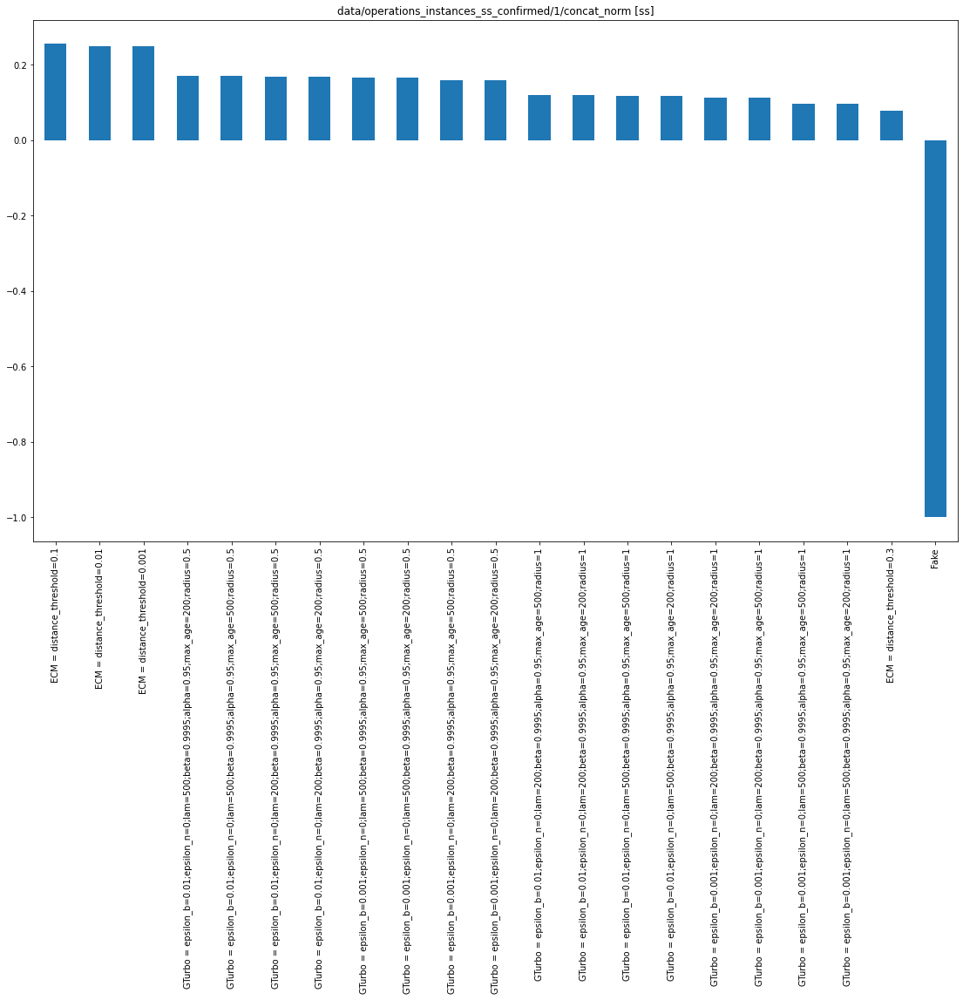

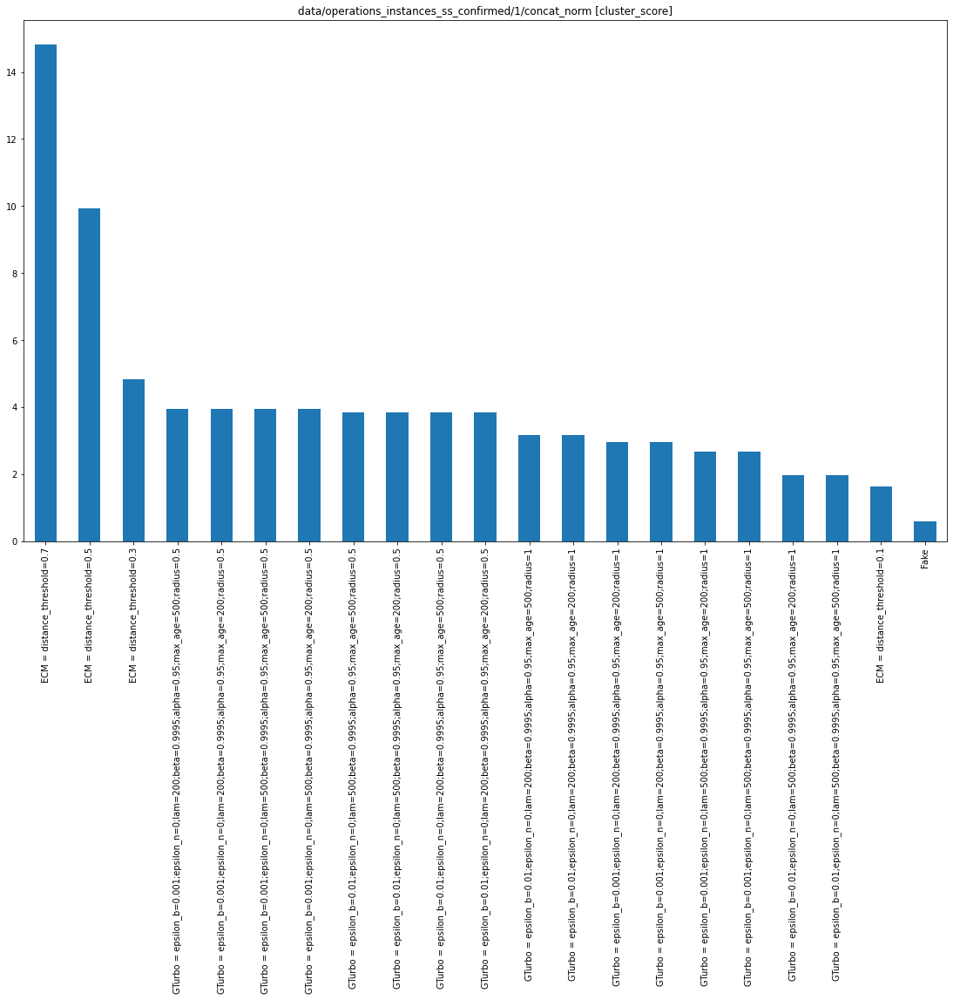

## OperationFile(layer='no_ss', test_subpath='1/no_ss', full_path='data/operations_instances_ss_confirmed/1/no_ss') - cluster metrics

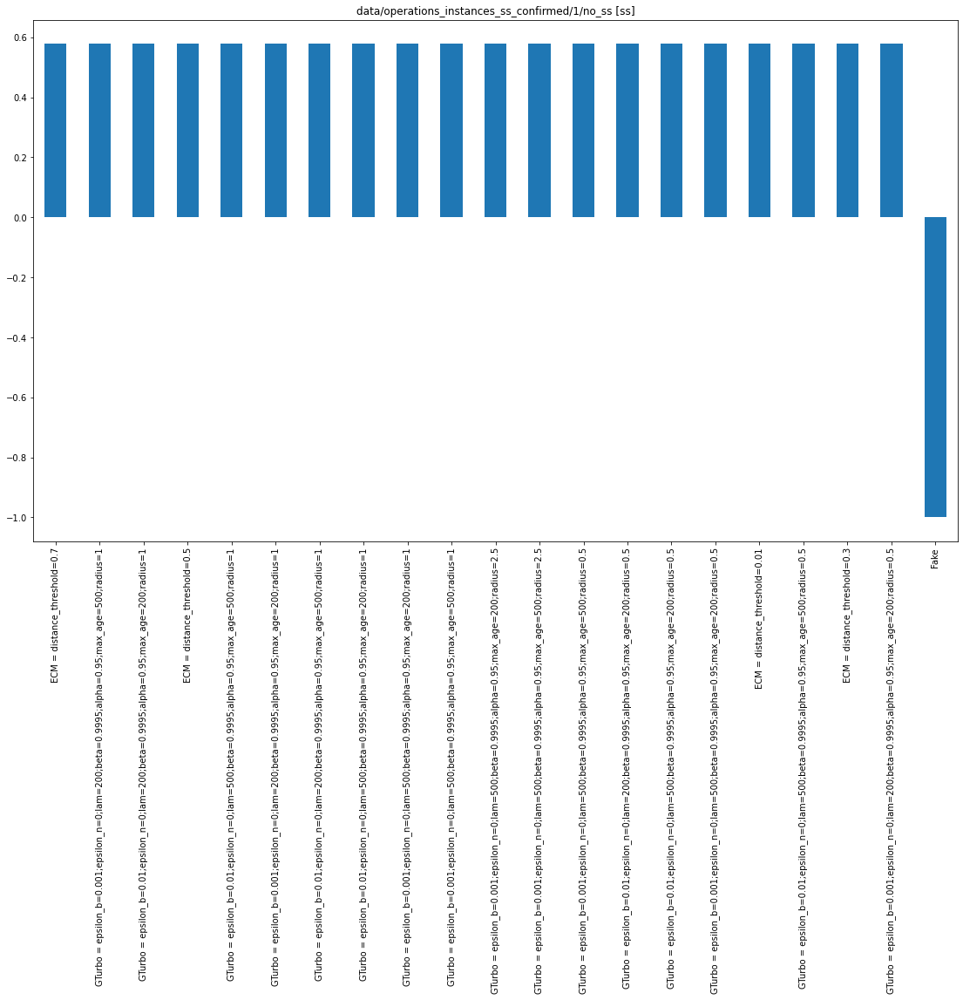

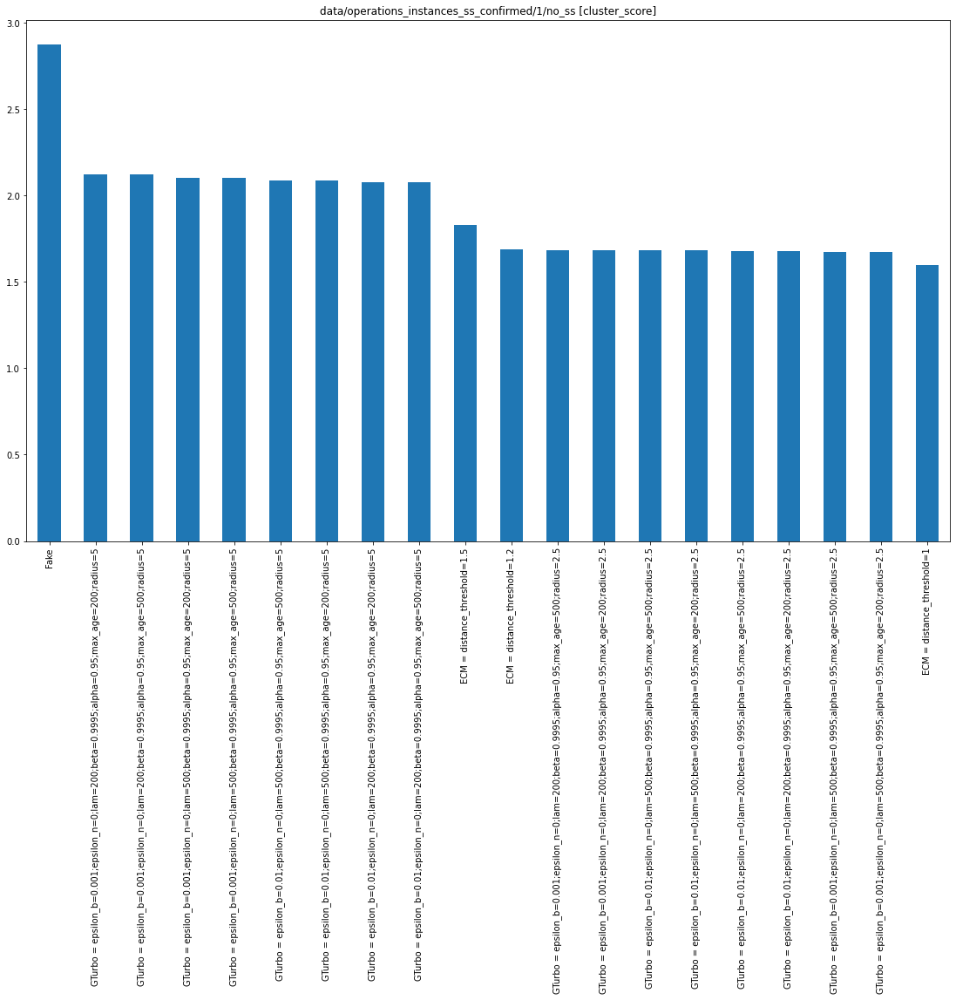

## OperationFile(layer='concat', test_subpath='1/concat', full_path='data/operations_instances_ss_confirmed/1/concat') - cluster metrics

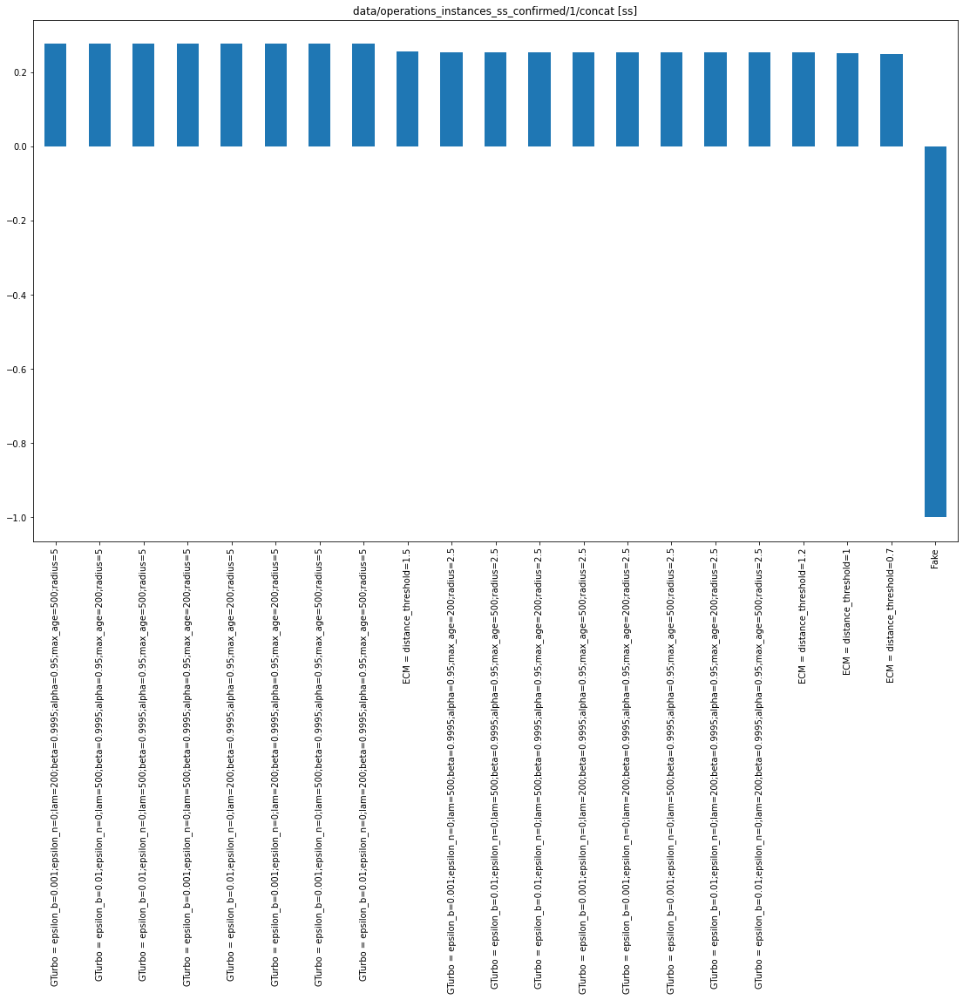

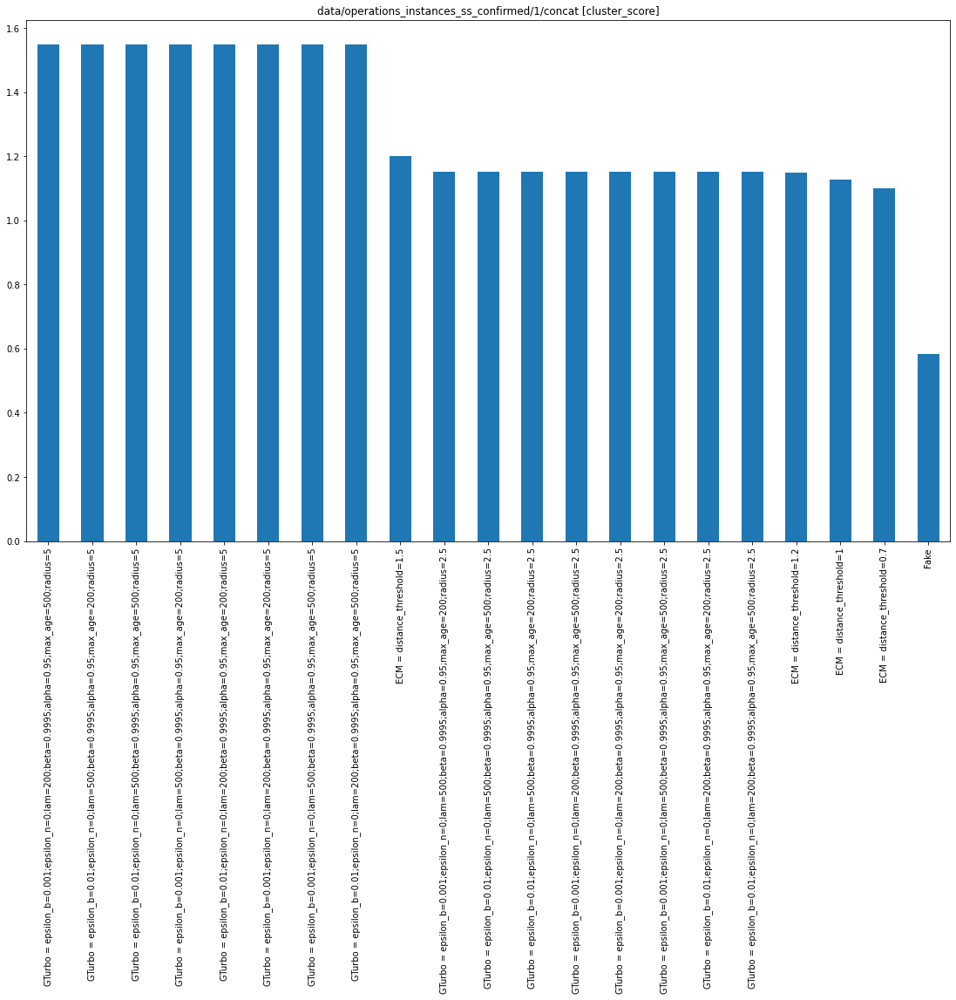

## OperationFile(layer='avg', test_subpath='1/avg', full_path='data/operations_instances_ss_confirmed/1/avg') - cluster metrics

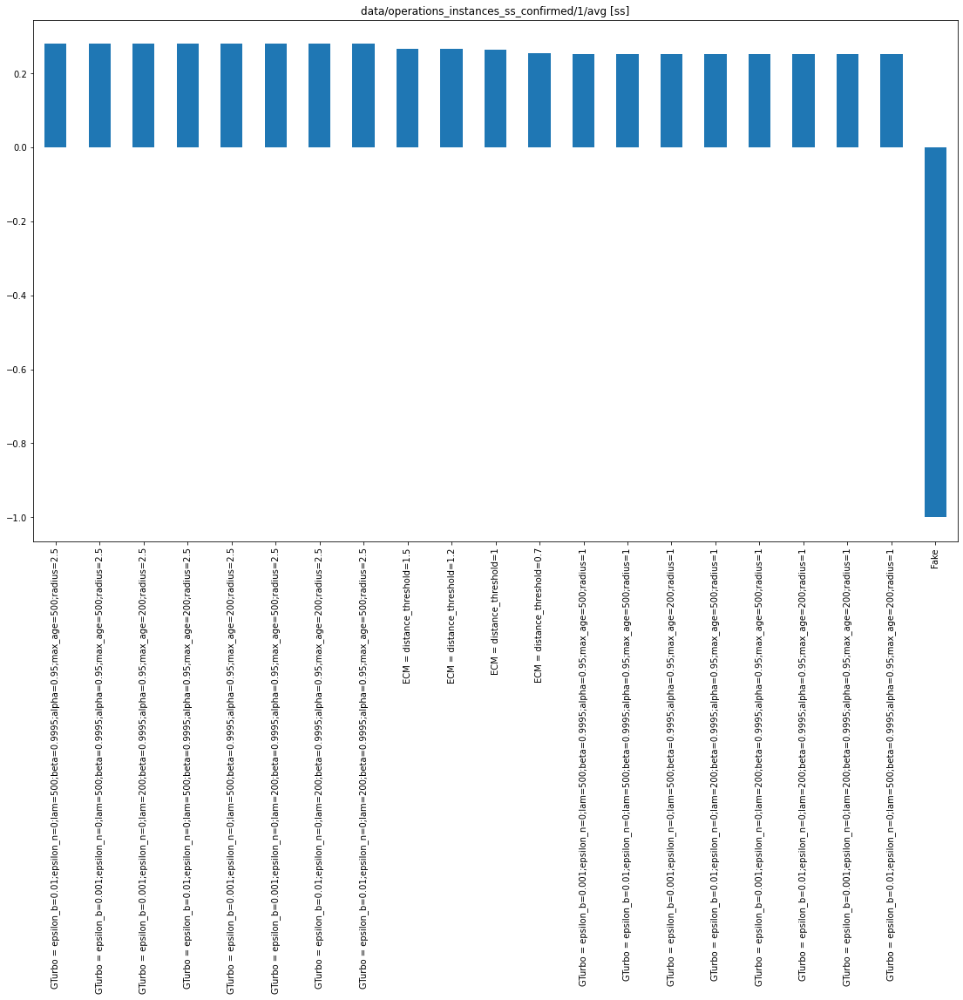

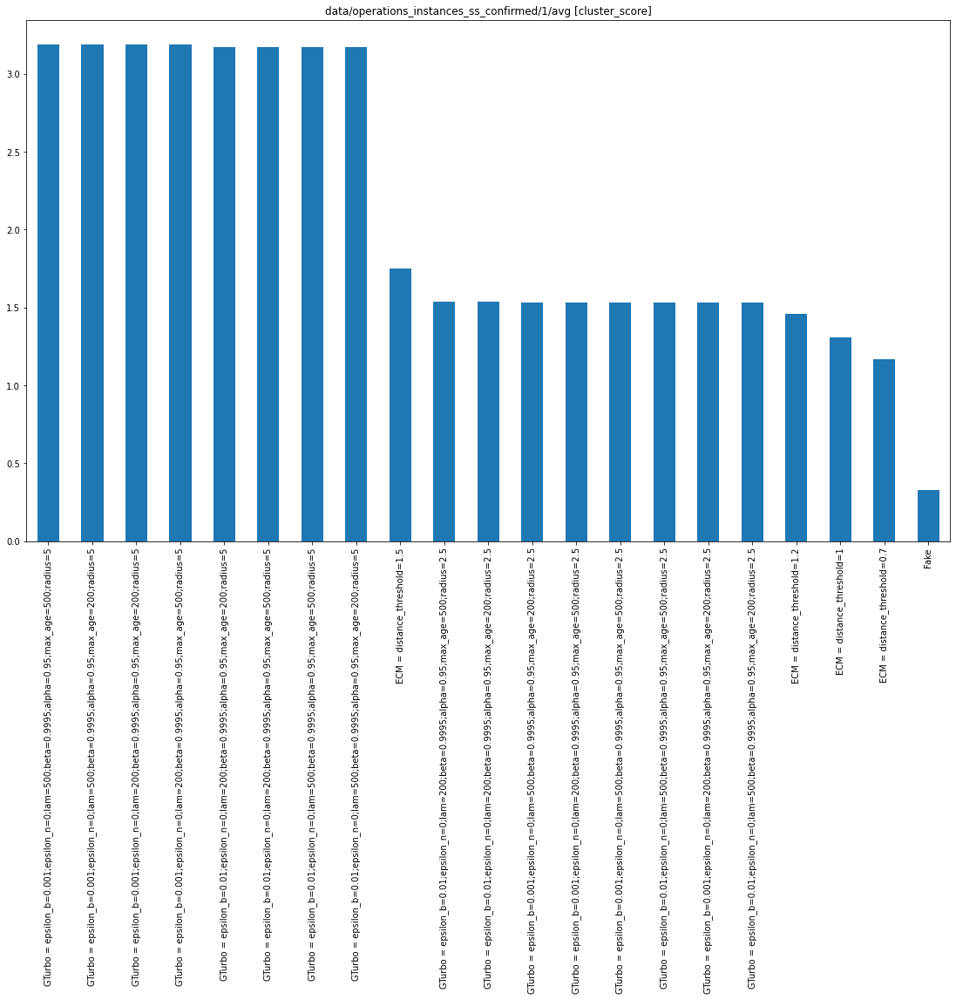

## OperationFile(layer='no_ss_norm', test_subpath='1/no_ss_norm', full_path='data/operations_instances_ss_confirmed/1/no_ss_norm') - cluster metrics

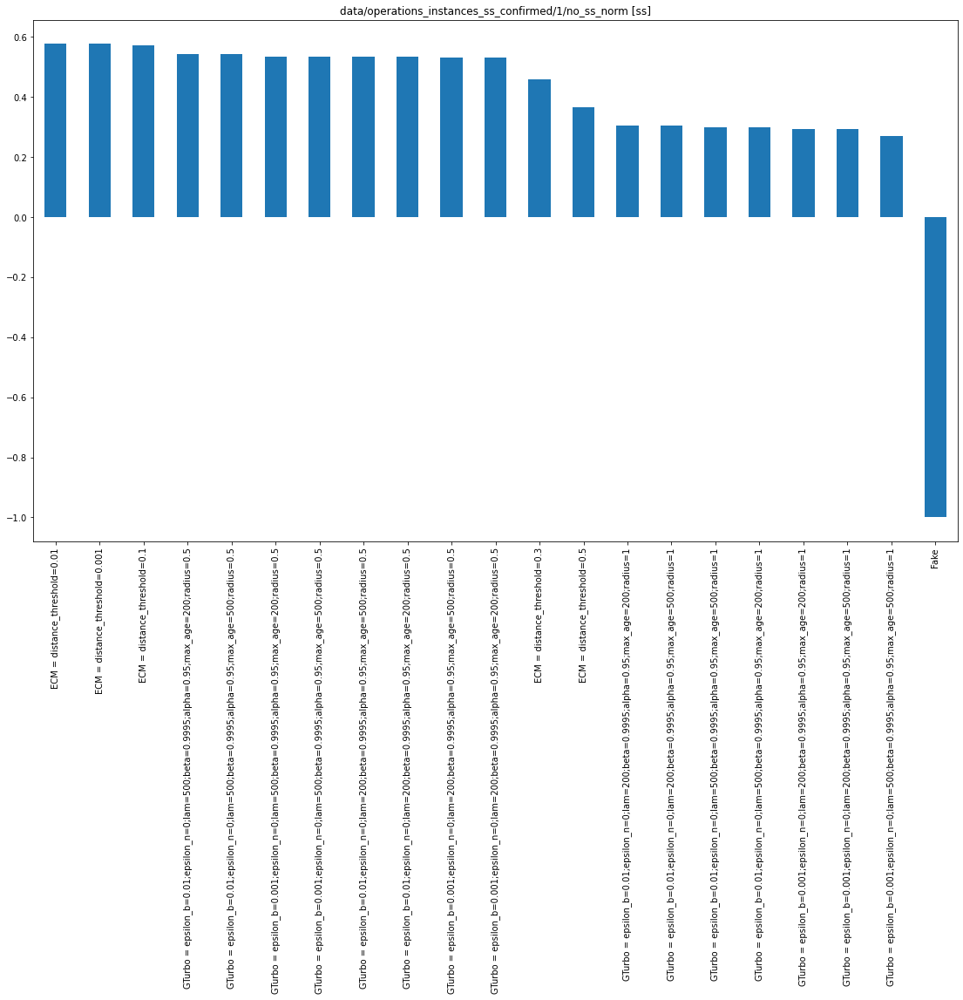

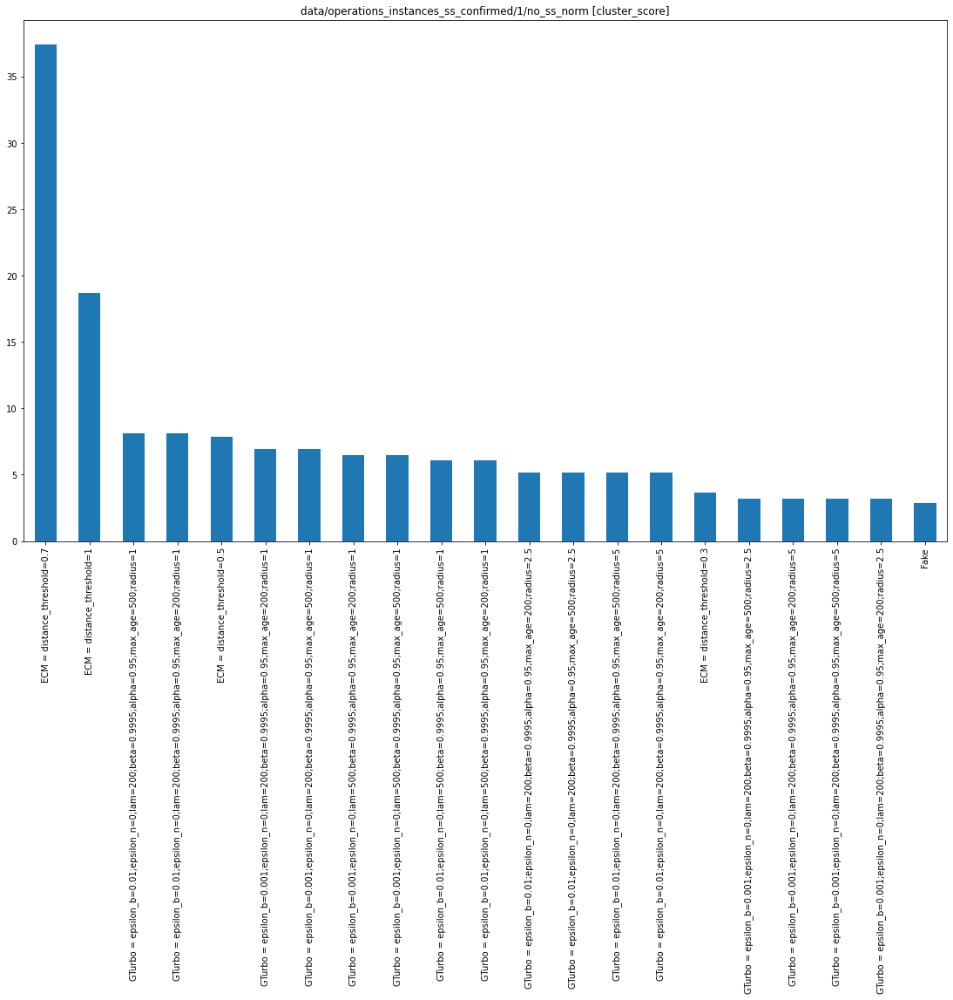

## OperationFile(layer='avg_norm', test_subpath='1/avg_norm', full_path='data/operations_instances_ss_confirmed/1/avg_norm') - cluster metrics

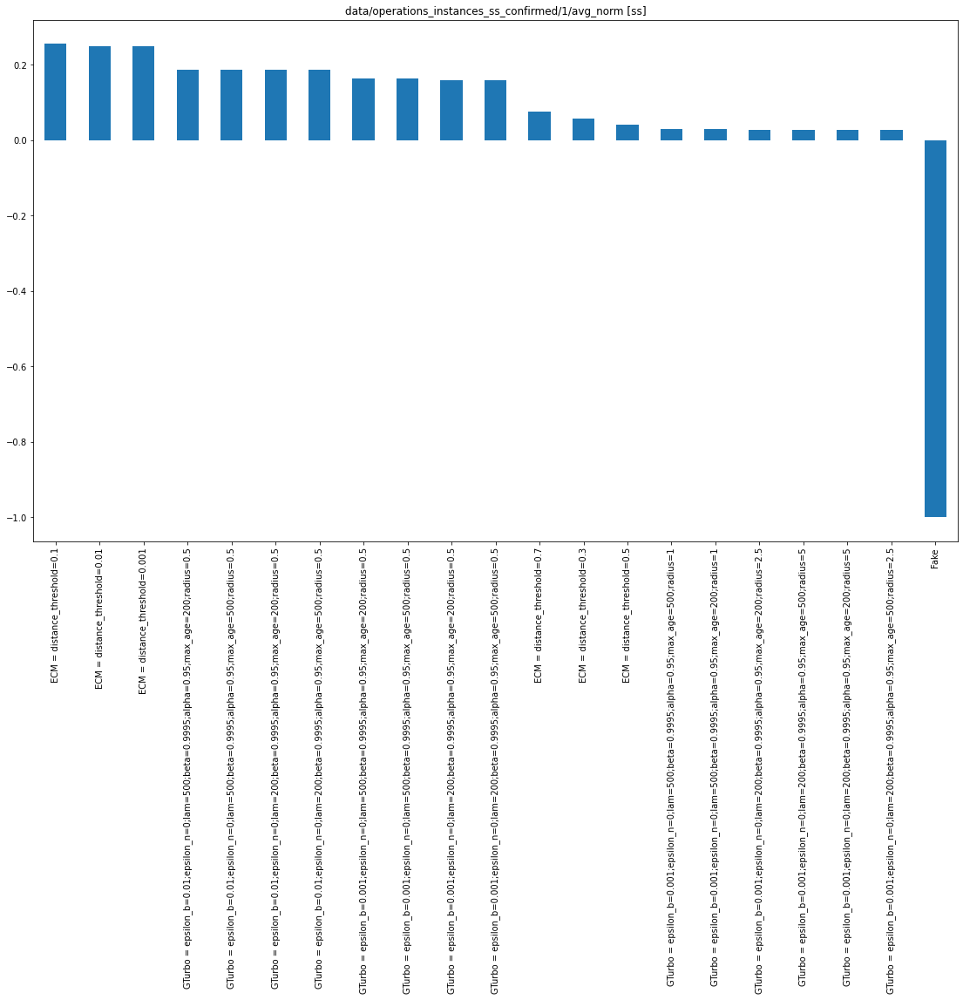

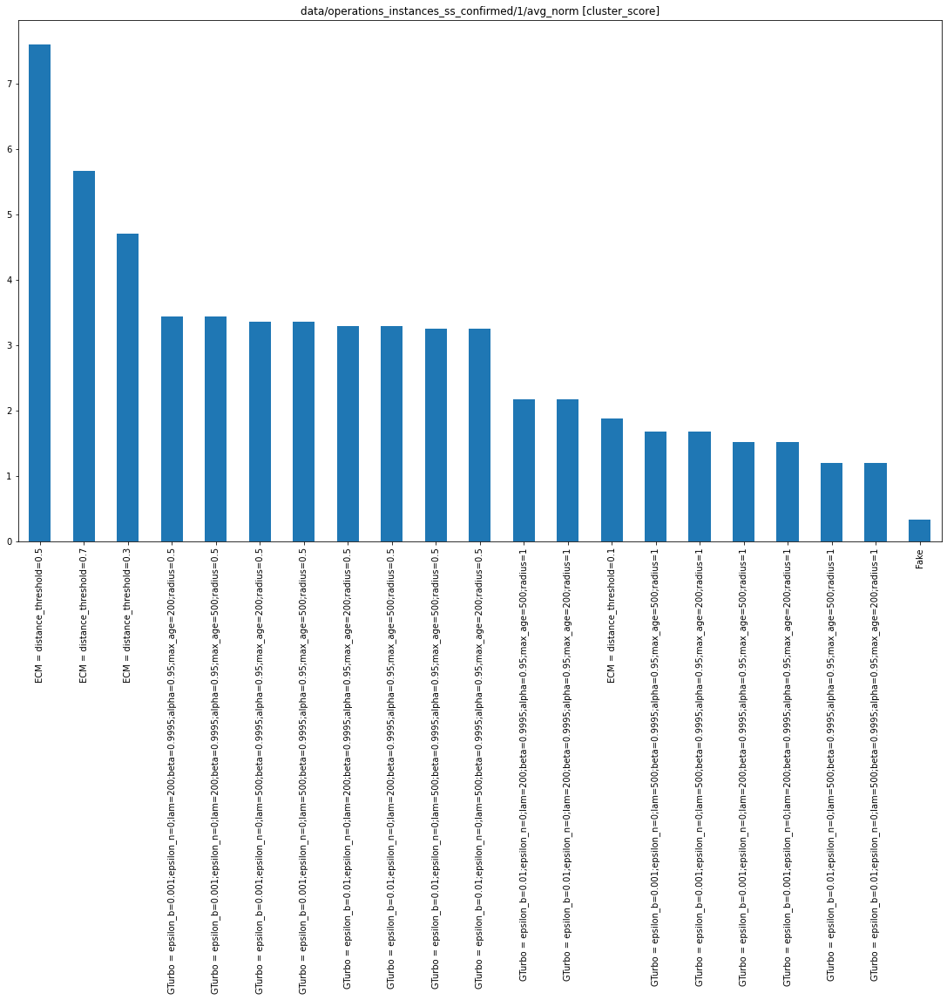

In [53]:
operations_file_to_good_by_cluster_metrics: Dict[str, Dict[str, None]] = {}

for operations_file in operations_files:

    display(Markdown(f'## {operations_file} - cluster metrics'))

    operations_file_to_good_by_cluster_metrics[operations_file.full_path] = {}

    name_to_cluster_metrics = operations_file_to_name_to_cluster_metrics[operations_file.full_path]

    cluster_metric_df = pd.DataFrame.from_dict(name_to_cluster_metrics, orient='index')

    for cluster_metric, _min, _max in cluster_metrics:
        n = 20
        z = cluster_metric_df[cluster_metric]
        z = z.sort_values(ascending=False).head(n)

        if "Fake" not in z.index:
            z = z.append(pd.Series([cluster_metric_df[cluster_metric]["Fake"]], index=["Fake"]))

        for name in z.index:
            operations_file_to_good_by_cluster_metrics[operations_file.full_path][name] = None

        plot = z.plot(kind='bar', figsize=(19,11))
        plot.set_title(f"{operations_file.full_path} [{cluster_metric}]")
        plt.show()


## OperationFile(layer='concat_norm', test_subpath='1/concat_norm', full_path='data/operations_instances_ss_confirmed/1/concat_norm') - matches metrics

,bin deviation score
ECM = distance_threshold=0.1,-10124.422714
ECM = distance_threshold=0.01,-10124.422714
ECM = distance_threshold=0.001,-10100.694567
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-8650.301901
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-10120.836754
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-10116.304816
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-9650.706534
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-6986.999696
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-9650.706534
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-7763.669499


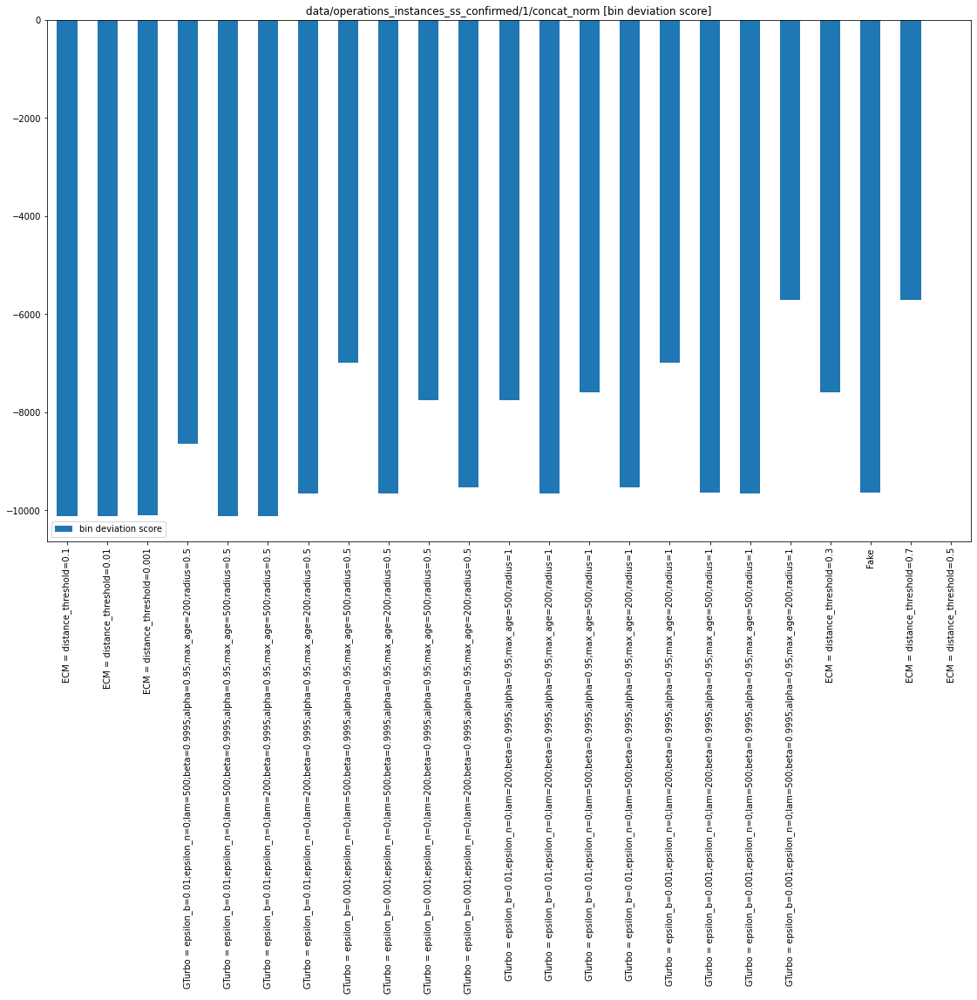

,0 #matches,1 #matches,10 #matches,100 #matches,101 #matches,102 #matches,104 #matches,105 #matches,106 #matches,107 #matches,108 #matches,11 #matches,111 #matches,113 #matches,114 #matches,115 #matches,116 #matches,119 #matches,12 #matches,120 #matches,122 #matches,124 #matches,125 #matches,126 #matches,128 #matches,13 #matches,131 #matches,132 #matches,134 #matches,139 #matches,14 #matches,140 #matches,143 #matches,144 #matches,145 #matches,146 #matches,149 #matches,15 #matches,154 #matches,159 #matches,16 #matches,168 #matches,169 #matches,17 #matches,174 #matches,177 #matches,18 #matches,180 #matches,187 #matches,19 #matches,192 #matches,199 #matches,2 #matches,20 #matches,202 #matches,21 #matches,213 #matches,215 #matches,219 #matches,22 #matches,23 #matches,24 #matches,241 #matches,246 #matches,25 #matches,26 #matches,27 #matches,274 #matches,28 #matches,282 #matches,29 #matches,294 #matches,298 #matches,299 #matches,3 #matches,30 #matches,305 #matches,306 #matches,31 #matches,32 #matches,320 #matches,321 #matches,33 #matches,34 #matches,344 #matches,35 #matches,36 #matches,37 #matches,38 #matches,39 #matches,4 #matches,40 #matches,41 #matches,42 #matches,43 #matches,44 #matches,45 #matches,46 #matches,47 #matches,48 #matches,49 #matches,5 #matches,50 #matches,51 #matches,52 #matches,53 #matches,54 #matches,55 #matches,56 #matches,57 #matches,58 #matches,6 #matches,60 #matches,61 #matches,62 #matches,63 #matches,64 #matches,65 #matches,66 #matches,67 #matches,68 #matches,69 #matches,7 #matches,70 #matches,71 #matches,72 #matches,73 #matches,74 #matches,75 #matches,76 #matches,77 #matches,78 #matches,79 #matches,8 #matches,80 #matches,81 #matches,82 #matches,85 #matches,86 #matches,87 #matches,88 #matches,89 #matches,9 #matches,91 #matches,92 #matches,93 #matches,94 #matches,95 #matches,96 #matches,97 #matches,98 #matches,99 #matches
ECM = distance_threshold=0.5,78,7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,7,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ECM = distance_threshold=0.7,18,14,2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2,0,0,1,0,0,2,0,0,0,0,0,1,0,0,9,1,0,0,0,0,0,0,0,0,0,0,1,0,2,0,1,0,1,0,0,0,10,1,0,0,0,1,0,0,0,0,0,0,1,0,1,0,2,0,0,0,0,0,0,2,0,2,1,5,0,0,0,0,0,1,0,0,0,4,0,0,0,0,0,0,0,0,0,0,4,0,0,2,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,3,0,0,0,0,1,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,20,3,3,0,0,0,0,0,0,1,0,2,1,0,0,0,0,0,3,0,0,0,0,0,0,3,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,3,2,0,2,0,0,0,1,1,1,0,0,2,0,0,0,1,0,1,0,0,0,4,0,0,0,0,2,0,0,1,0,0,1,0,2,0,1,6,0,2,0,0,1,0,1,0,0,0,3,0,0,2,2,0,0,0,0,1,1,1,0,0,1,1,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,5,0,2,0,0,0,0,0,0,2,0,0,0,0,0,0,0,1,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,2,1,2,0,0,0,1,0,0,0,0,4,1,0,1,0,0,1,1,0,0,0,0,0,0,1,0,1,0,1,3,0,0,0,0,0,1,2,0,0,1,0,0,3,0,0,1,0,0,1,0,1,2,2,0,0,0,0,0,2,2,2,0,0,1,1,1,0,2,0,0,0,0,0,2,0,0,0,1,0,0,0,0,3,0,0,0,0,1,1,4,2,1,0,1,2,1,0,2,2,1,3,1,0,2,1,0,0,1,0,0,1,1,0,0,0,1,1,0,0,0,0,3,1,1,1,0,0,1,1,1,0,0,3,0,2,0,0,0,0,0,0,3,0,0,1,1,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,5,46,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,19,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,2,0,0,0,6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0
ECM = distance_threshold=0.3,18,71,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,

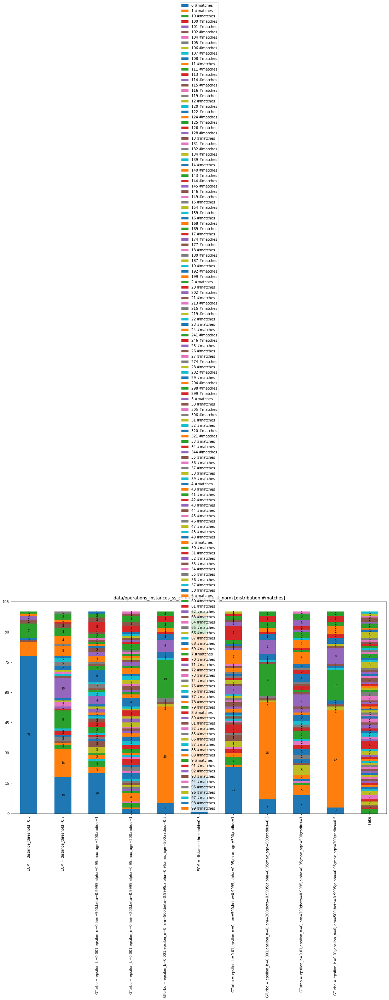

,0 #potential,1 #potential,10 #potential,1036 #potential,104 #potential,11 #potential,12 #potential,13 #potential,139 #potential,14 #potential,15 #potential,158 #potential,16 #potential,165 #potential,17 #potential,18 #potential,1816 #potential,19 #potential,191 #potential,1950 #potential,2 #potential,2000 #potential,21 #potential,22 #potential,23 #potential,24 #potential,242 #potential,25 #potential,259 #potential,26 #potential,27 #potential,29 #potential,3 #potential,31 #potential,32 #potential,33 #potential,34 #potential,36 #potential,387 #potential,39 #potential,393 #potential,399 #potential,4 #potential,40 #potential,411 #potential,42 #potential,441 #potential,49 #potential,5 #potential,50 #potential,55 #potential,59 #potential,6 #potential,7 #potential,721 #potential,76 #potential,8 #potential,80 #potential,81 #potential,82 #potential,85 #potential,86 #potential,87 #potential,88 #potential,9 #potential,97 #potential
ECM = distance_threshold=0.5,0,84,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,5,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
ECM = distance_threshold=0.7,0,0,1,0,0,2,6,0,3,1,3,12,0,0,0,5,0,0,0,0,14,0,1,2,0,0,0,1,0,0,0,0,8,1,0,2,1,2,0,1,0,0,6,3,0,0,0,4,3,2,2,1,6,1,0,0,2,0,0,0,0,0,1,3,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,19,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,44,0,1,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,23,0,4,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,67,0,24,0,0,0,0,0,0,0,0,0,1,0,2,0,4,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,2,37,2,0,0,0,0,4,0,1,2,0,0,0,0,0,0,1,0,0,25,0,0,1,2,0,0,0,0,0,0,2,9,0,0,0,0,0,0,0,0,0,4,0,0,1,0,0,2,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,2,0
ECM = distance_threshold=0.3,0,89,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,23,0,0,28,32,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,4,37,1,0,0,0,0,4,0,1,2,0,0,0,0,0,0,2,0,0,24,0,0,1,1,1,0,0,0,0,0,2,9,0,0,0,0,0,0,0,0,0,3,0,0,1,0,0,2,0,0,0,1,0,0,0,3,0,0,0,0,0,0,0,1,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,4,0,0,0,0,0,0,0,0,0,0,0,10,0,0,0,0,0,30,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,13,19,0,9,0,0,0,0,0,0,1,8
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,37,3,0,0,0,1,4,0,3,0,0,0,0,0,0,0,1,0,0,25,0,0,1,0,0,0,1,0,2,0,0,9,2,0,0,0,0,0,0,0,0,3,0,0,2,0,0,1,0,0,0,0,1,0,0,3,0,0,0,0,0,0,0,1,0


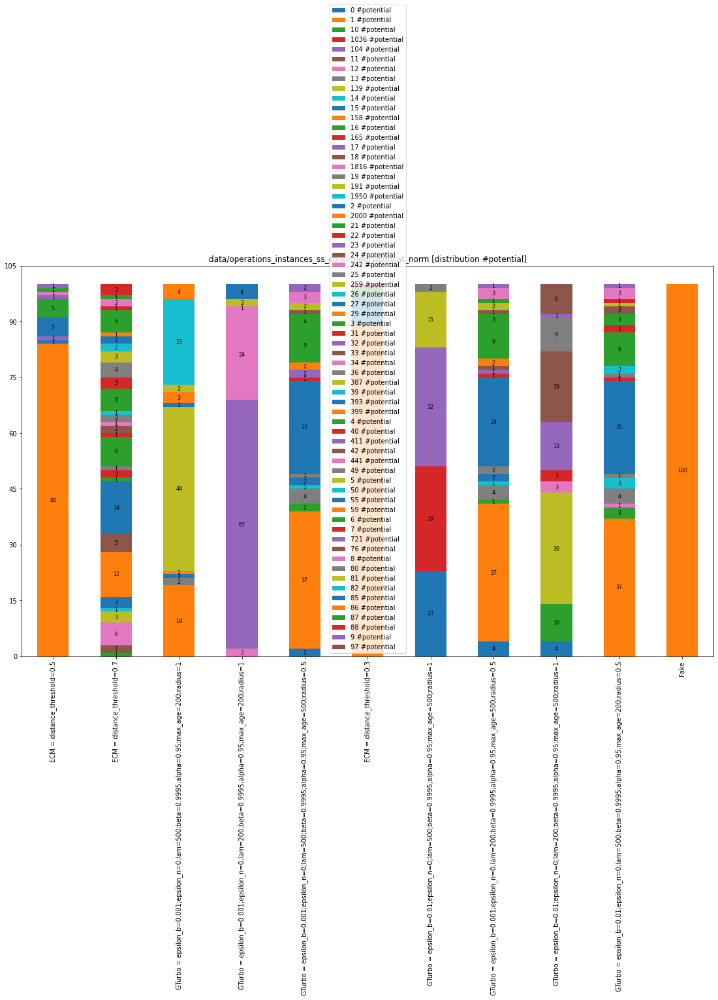

,0 #potential after similarity,1 #potential after similarity,10 #potential after similarity,1005 #potential after similarity,1007 #potential after similarity,101 #potential after similarity,1010 #potential after similarity,1014 #potential after similarity,102 #potential after similarity,1020 #potential after similarity,1021 #potential after similarity,1023 #potential after similarity,1024 #potential after similarity,1028 #potential after similarity,103 #potential after similarity,1030 #potential after similarity,104 #potential after similarity,1044 #potential after similarity,1045 #potential after similarity,1047 #potential after similarity,1061 #potential after similarity,1062 #potential after similarity,1063 #potential after similarity,1073 #potential after similarity,1078 #potential after similarity,108 #potential after similarity,1081 #potential after similarity,1085 #potential after similarity,109 #potential after similarity,1095 #potential after similarity,1097 #potential after similarity,1099 #potential after similarity,11 #potential after similarity,110 #potential after similarity,1101 #potential after similarity,1103 #potential after similarity,1104 #potential after similarity,1106 #potential after similarity,1107 #potential after similarity,1108 #potential after similarity,1109 #potential after similarity,111 #potential after similarity,1115 #potential after similarity,1118 #potential after similarity,112 #potential after similarity,1124 #potential after similarity,1125 #potential after similarity,1139 #potential after similarity,1142 #potential after similarity,1145 #potential after similarity,1147 #potential after similarity,1149 #potential after similarity,1156 #potential after similarity,1160 #potential after similarity,1167 #potential after similarity,1169 #potential after similarity,117 #potential after similarity,1170 #potential after similarity,1173 #potential after similarity,1190 #potential after similarity,1192 #potential after similarity,12 #potential after similarity,120 #potential after similarity,1205 #potential after similarity,1206 #potential after similarity,1207 #potential after similarity,121 #potential after similarity,1215 #potential after similarity,1225 #potential after similarity,1235 #potential after similarity,1239 #potential after similarity,125 #potential after similarity,1269 #potential after similarity,128 #potential after similarity,1284 #potential after similarity,1286 #potential after similarity,1293 #potential after similarity,13 #potential after similarity,1306 #potential after similarity,131 #potential after similarity,1318 #potential after similarity,132 #potential after similarity,1324 #potential after similarity,1330 #potential after similarity,1332 #potential after similarity,134 #potential after similarity,1343 #potential after similarity,135 #potential after similarity,1353 #potential after similarity,136 #potential after similarity,1370 #potential after similarity,1385 #potential after similarity,1388 #potential after similarity,139 #potential after similarity,1392 #potential after similarity,14 #potential after similarity,1400 #potential after similarity,1409 #potential after similarity,143 #potential after similarity,144 #potential after similarity,145 #potential after similarity,146 #potential after similarity,148 #potential after similarity,15 #potential after similarity,150 #potential after similarity,151 #potential after similarity,152 #potential after similarity,153 #potential after similarity,154 #potential after similarity,155 #potential after similarity,156 #potential after similarity,157 #potential after similarity,158 #potential after similarity,159 #potential after similarity,16 #potential after similarity,160 #potential after similarity,161 #potential after similarity,162 #potential after similarity,164 #potential after similarity,165 #potential after similarity,166 #potential after similarity,167 #potential after similarity,168 #potential after similarity,17 

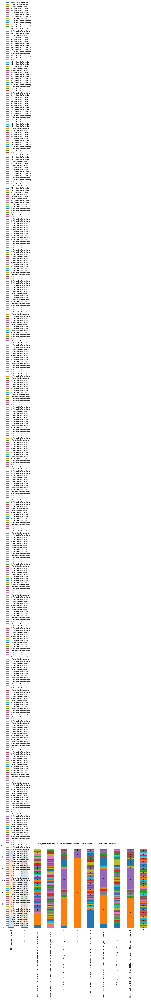

,10 - 15 score range,15 - 20 score range,20 - 25 score range,25 - 30 score range,30 - 35 score range,35 - 40 score range,40 - 45 score range,45 - 50 score range,5 - 10 score range,50 - 55 score range,55 - 60 score range,60 - 65 score range,65 - 70 score range,70 - 75 score range,75 - 80 score range,80 - 85 score range,85 - 90 score range,90 - 95 score range,95 - 100 score range
ECM = distance_threshold=0.5,0,0,3,8,21,16,34,22,0,30,16,24,4,7,5,8,4,13,7
ECM = distance_threshold=0.7,2,12,32,121,265,691,683,941,0,526,353,101,69,39,17,73,11,42,6
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,51,405,1117,2444,3982,4579,3809,2688,1,1135,438,136,63,88,22,90,12,23,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,153,913,2161,4735,7445,7850,6913,4721,12,2278,865,244,85,101,26,95,14,41,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,0,5,20,50,0,97,68,73,35,15,12,55,11,37,7
ECM = distance_threshold=0.3,0,0,0,0,0,3,6,9,0,17,21,8,9,7,5,11,8,13,4
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,213,987,2712,5221,7644,7591,5656,3673,12,1507,680,168,75,85,23,92,20,19,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,0,5,20,48,0,88,79,74,35,15,12,55,11,37,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,57,350,1030,2116,3687,3971,3285,2308,5,1222,468,157,68,82,23,93,13,22,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,0,0,4,26,56,0,113,81,72,34,45,15,68,13,37,7


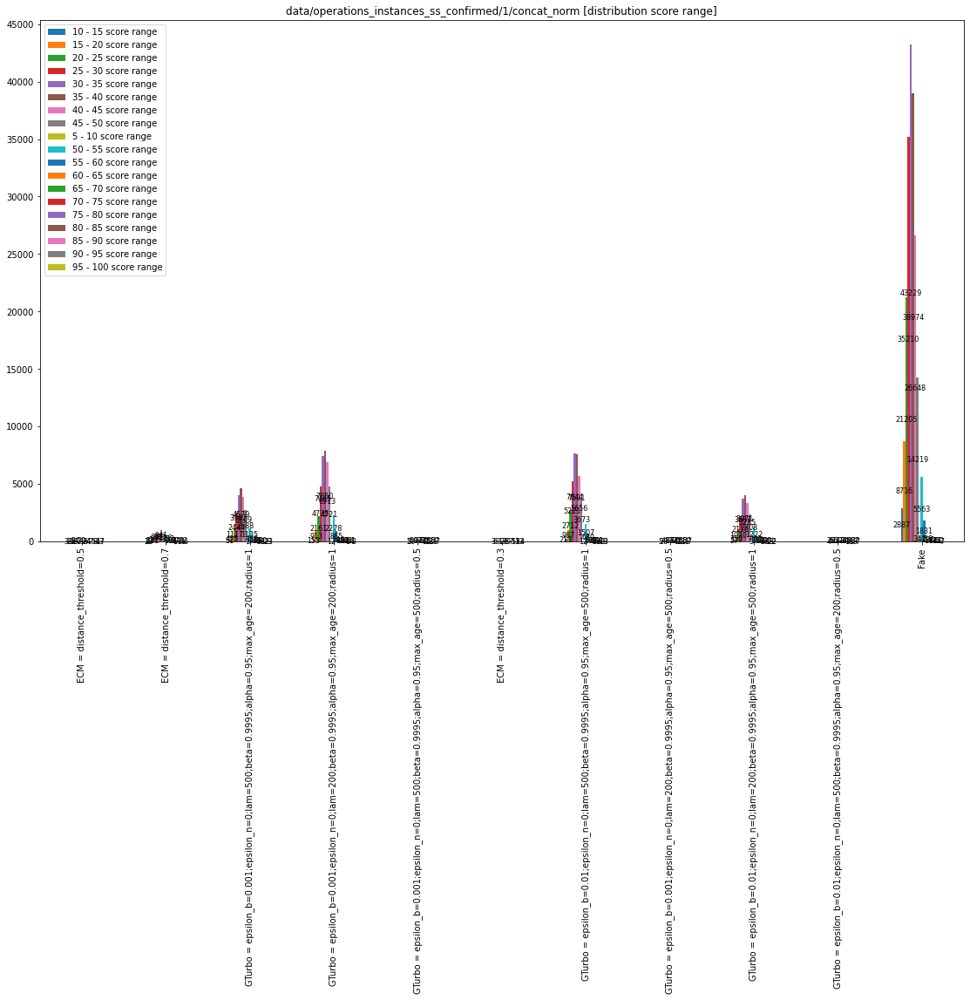

,50 - 55 matches score range,55 - 60 matches score range,60 - 65 matches score range,65 - 70 matches score range,70 - 75 matches score range,75 - 80 matches score range,80 - 85 matches score range,85 - 90 matches score range,90 - 95 matches score range,95 - 100 matches score range
ECM = distance_threshold=0.5,30,16,24,4,7,5,8,4,13,7
ECM = distance_threshold=0.7,526,353,101,69,39,17,73,11,42,6
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,1135,438,136,63,88,22,90,12,23,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,2278,865,244,85,101,26,95,14,41,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,97,68,73,35,15,12,55,11,37,7
ECM = distance_threshold=0.3,17,21,8,9,7,5,11,8,13,4
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,1507,680,168,75,85,23,92,20,19,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,88,79,74,35,15,12,55,11,37,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,1222,468,157,68,82,23,93,13,22,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,113,81,72,34,45,15,68,13,37,7


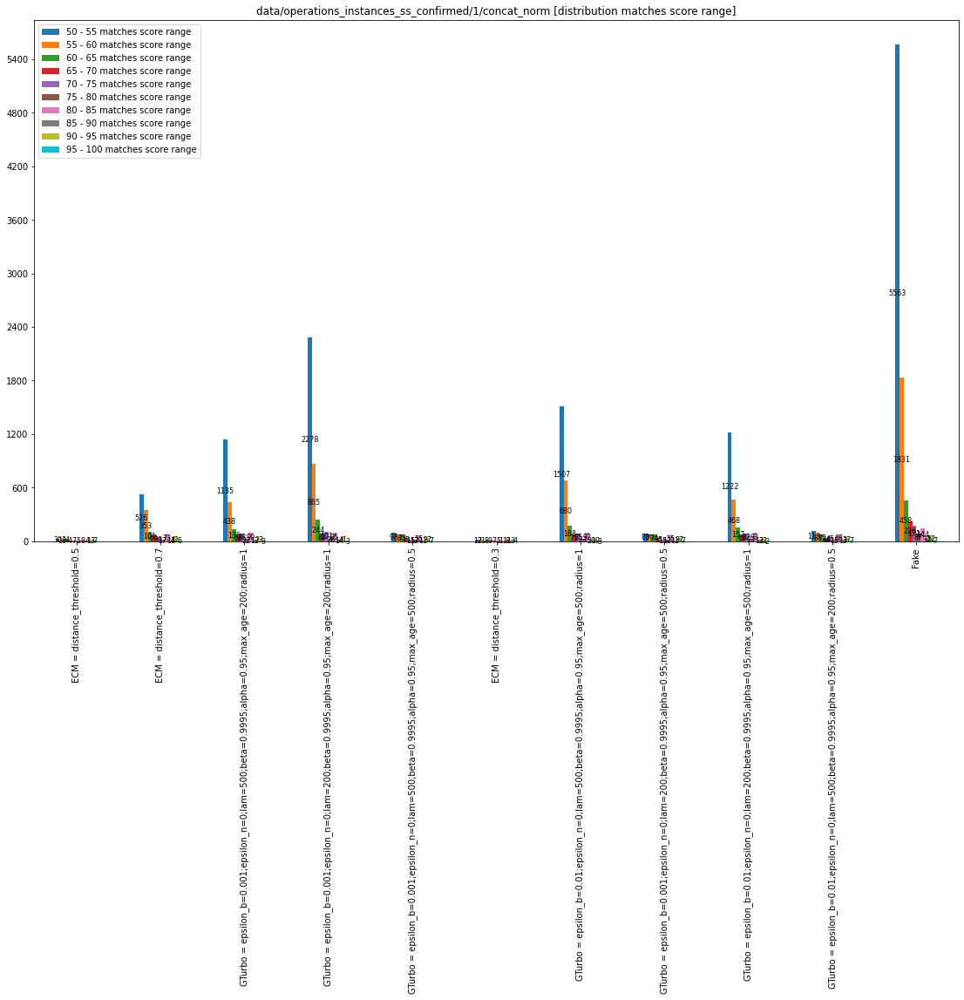

,10 - 15 similarity score range,15 - 20 similarity score range,20 - 25 similarity score range,25 - 30 similarity score range,30 - 35 similarity score range,35 - 40 similarity score range,40 - 45 similarity score range,45 - 50 similarity score range,50 - 55 similarity score range,55 - 60 similarity score range,60 - 65 similarity score range,65 - 70 similarity score range,70 - 75 similarity score range,75 - 80 similarity score range,80 - 85 similarity score range,85 - 90 similarity score range,90 - 95 similarity score range,95 - 100 similarity score range
ECM = distance_threshold=0.5,0,0,0,0,0,0,6,9,20,22,19,15,28,29,36,6,22,10
ECM = distance_threshold=0.7,0,0,0,15,9,36,76,157,266,449,675,824,732,493,175,35,32,10
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,4,20,139,433,1075,1883,2950,3537,3532,2900,2286,1430,668,155,32,34,8
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,16,90,368,1133,2596,4207,5747,6512,5920,4794,3627,2234,1053,260,48,41,9
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,0,0,0,0,0,0,11,39,88,166,120,25,24,12
ECM = distance_threshold=0.3,0,0,0,0,0,0,0,0,0,1,9,9,19,34,13,6,22,8
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,3,18,151,540,1394,2765,4322,5949,6169,5166,3951,2885,1837,950,206,30,36,9
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,0,0,0,0,0,0,11,43,86,156,128,26,24,12
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,2,6,41,159,431,903,1729,2645,3172,3022,2502,1924,1364,772,210,31,39,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,0,0,0,0,0,0,0,12,44,113,206,134,23,27,12


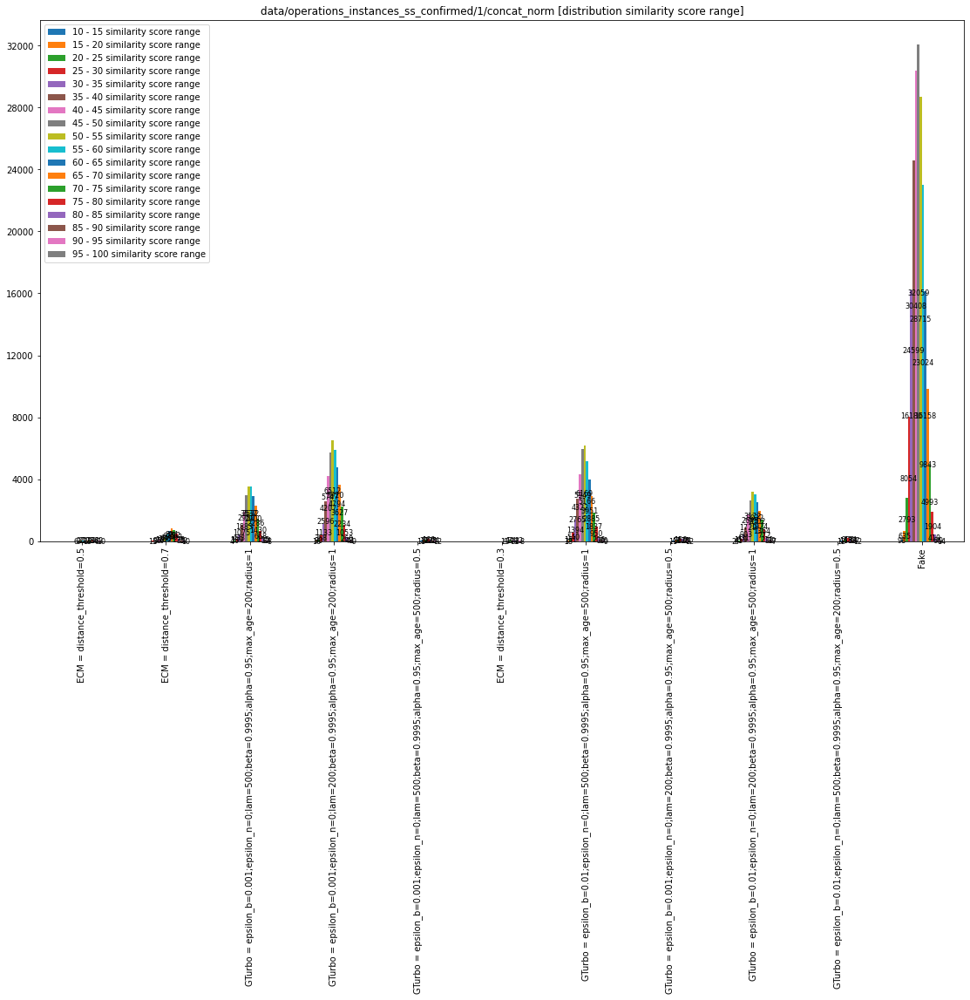

,0 - 5 quality score range,10 - 15 quality score range,100 - 100 quality score range,15 - 20 quality score range,20 - 25 quality score range,25 - 30 quality score range,30 - 35 quality score range,35 - 40 quality score range,40 - 45 quality score range,45 - 50 quality score range,5 - 10 quality score range,50 - 55 quality score range,55 - 60 quality score range,60 - 65 quality score range,65 - 70 quality score range,70 - 75 quality score range,75 - 80 quality score range,80 - 85 quality score range,85 - 90 quality score range,90 - 95 quality score range
ECM = distance_threshold=0.5,6,46,7,3,5,65,7,5,29,7,0,3,4,6,0,9,0,3,16,1
ECM = distance_threshold=0.7,104,936,36,83,312,1388,292,61,488,54,7,28,34,26,0,52,0,5,71,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,1691,7515,14,375,1753,6923,892,127,1323,52,106,20,47,31,0,116,0,10,81,10
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,2589,13142,28,632,3084,13109,1915,251,3289,106,131,46,57,41,0,121,0,13,91,10
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,1,11,34,9,15,93,57,17,89,27,0,22,7,7,1,24,0,5,56,10
ECM = distance_threshold=0.3,1,4,6,2,2,19,8,4,22,2,0,3,6,3,0,13,0,5,20,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,2949,14259,14,597,2798,11499,1372,190,2172,64,139,44,35,38,0,100,0,9,85,17
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,1,13,34,8,12,86,61,21,91,27,0,22,7,7,1,24,0,5,56,10
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,1404,7013,8,352,1360,6080,840,125,1354,55,61,23,38,31,0,104,0,10,90,11
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,1,15,34,9,14,116,67,13,93,28,0,21,7,10,1,57,0,8,66,11


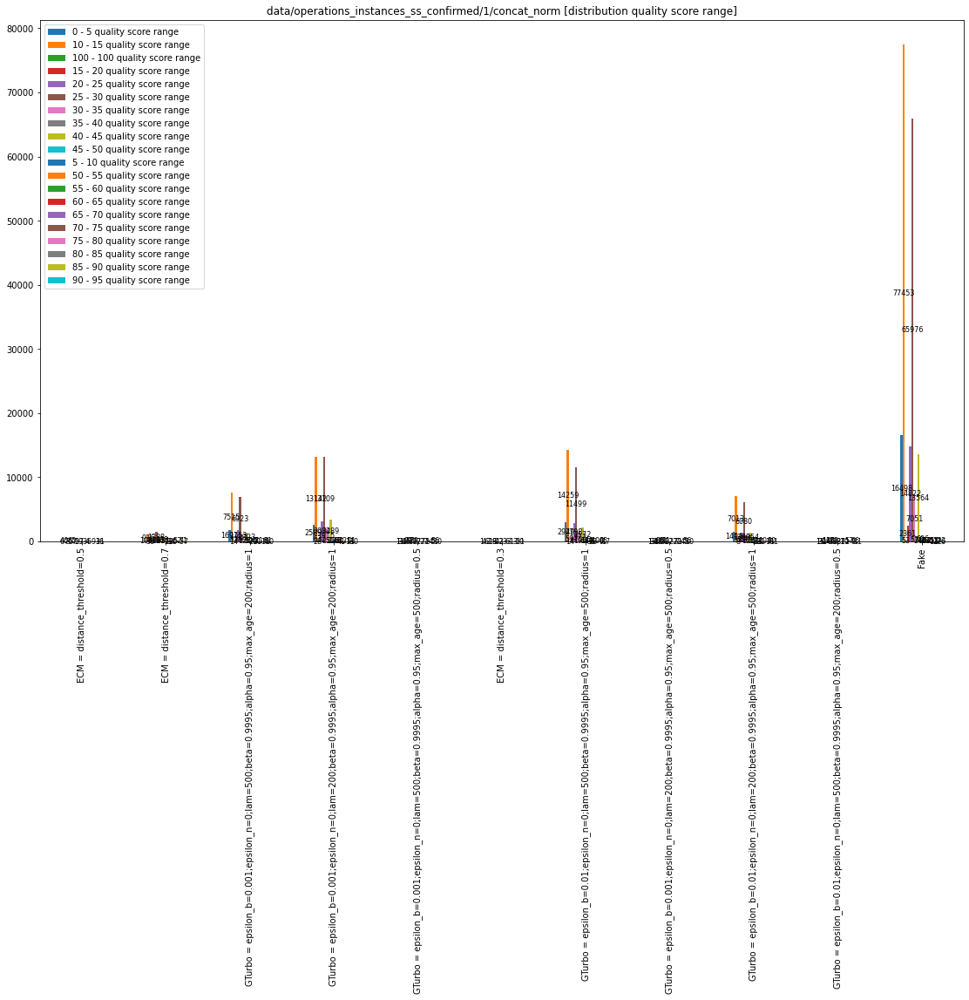

## OperationFile(layer='no_ss', test_subpath='1/no_ss', full_path='data/operations_instances_ss_confirmed/1/no_ss') - matches metrics

,bin deviation score
ECM = distance_threshold=0.7,-3689.266440
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,-3691.593013
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,-3689.266440
ECM = distance_threshold=0.5,-3689.266440
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,-3689.266440
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,-3689.266440
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,-3688.161269
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,-3689.266440
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,-3686.264050
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,-3689.266440


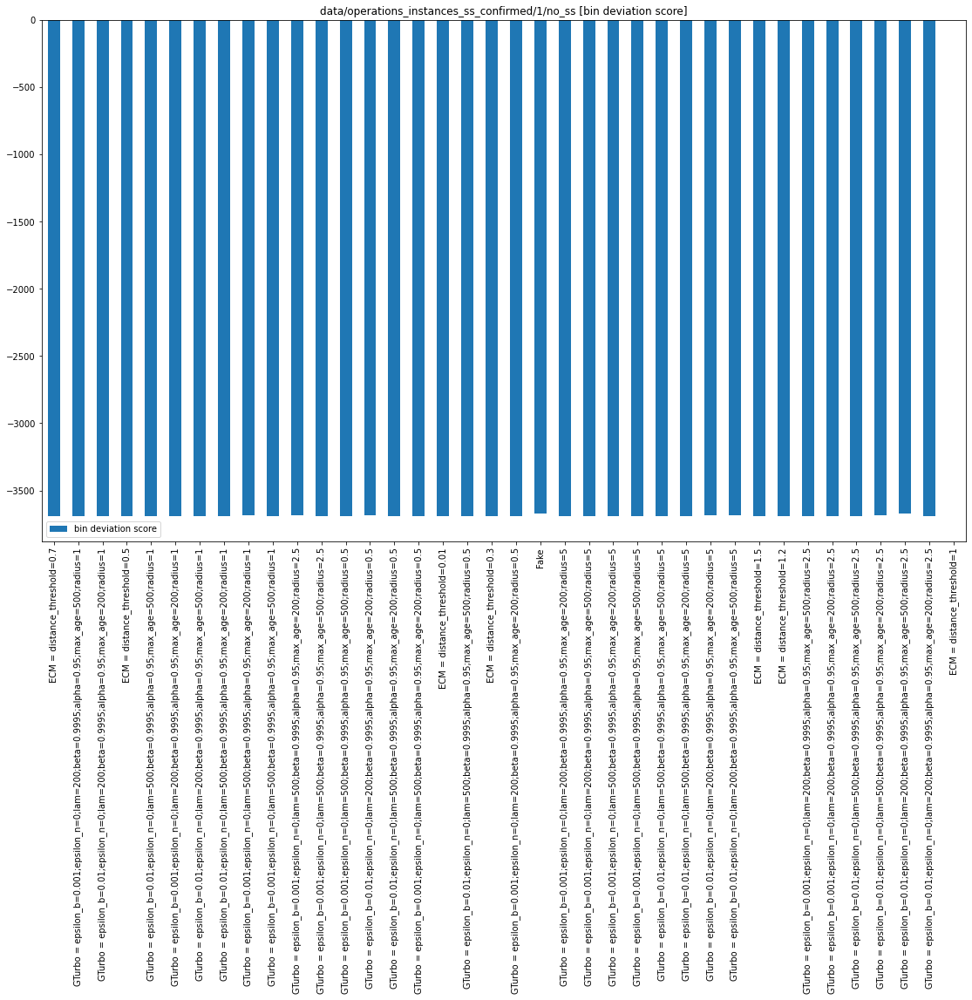

,0 #matches,1 #matches,10 #matches,101 #matches,12 #matches,14 #matches,16 #matches,17 #matches,171 #matches,18 #matches,19 #matches,2 #matches,21 #matches,22 #matches,23 #matches,25 #matches,27 #matches,28 #matches,3 #matches,32 #matches,34 #matches,35 #matches,37 #matches,38 #matches,39 #matches,4 #matches,40 #matches,41 #matches,43 #matches,44 #matches,45 #matches,46 #matches,5 #matches,50 #matches,51 #matches,53 #matches,56 #matches,59 #matches,6 #matches,63 #matches,7 #matches,78 #matches,8 #matches,81 #matches,82 #matches,83 #matches,84 #matches,85 #matches,89 #matches,9 #matches,92 #matches,95 #matches
ECM = distance_threshold=1,25,58,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,25,58,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0
Fake,2,4,2,1,2,2,2,2,1,1,4,4,1,3,2,4,2,6,3,1,1,3,2,2,1,1,2,1,1,2,2,1,8,2,1,1,1,1,3,1,1,1,1,1,1,1,1,2,1,2,1,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,25,57,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,2,0,1,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,25,58,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,25,58,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,25,58,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,25,57,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,2,0,1,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,25,58,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,25,58,0,0,0,0,0,0,0,0,0,11,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0


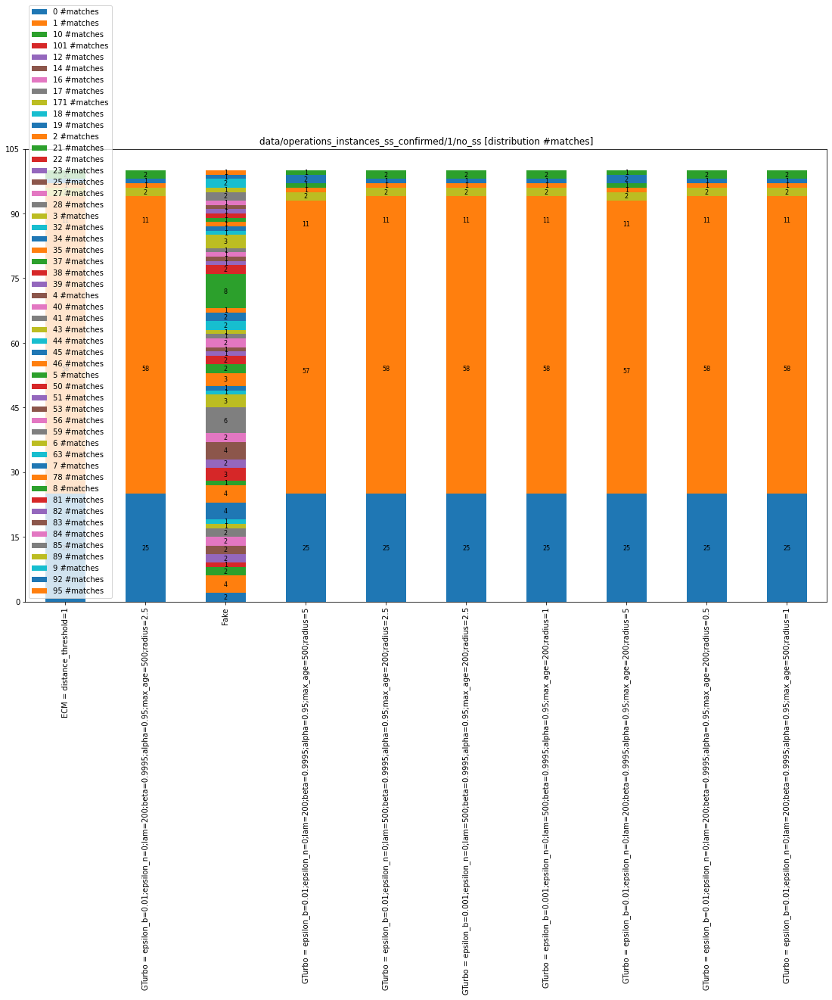

,0 #potential,1 #potential,11 #potential,14 #potential,17 #potential,2 #potential,2000 #potential,3 #potential,35 #potential,6 #potential,7 #potential,8 #potential
ECM = distance_threshold=1,0,80,0,0,0,14,0,2,1,0,1,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,80,0,0,0,13,0,3,1,0,1,2
Fake,0,0,0,0,0,0,100,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,8,69,0,0,1,13,0,3,1,0,4,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,80,0,0,0,13,0,3,1,0,1,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,80,0,0,0,13,0,3,1,0,1,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,80,0,0,0,14,0,2,1,0,1,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,8,69,0,0,1,13,0,3,1,0,4,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,80,0,0,0,14,0,2,1,0,1,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,80,0,0,0,14,0,2,1,0,1,2


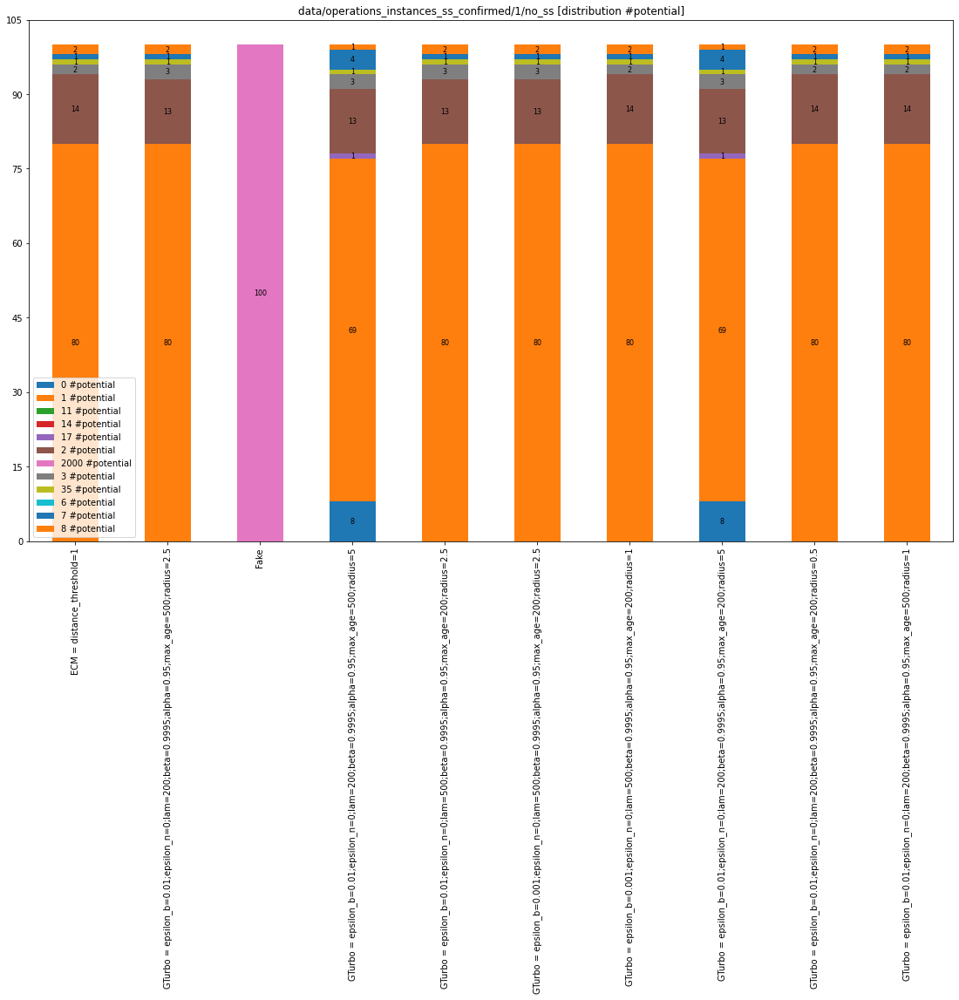

,0 #potential after similarity,1 #potential after similarity,105 #potential after similarity,106 #potential after similarity,107 #potential after similarity,108 #potential after similarity,11 #potential after similarity,126 #potential after similarity,128 #potential after similarity,132 #potential after similarity,133 #potential after similarity,134 #potential after similarity,136 #potential after similarity,137 #potential after similarity,14 #potential after similarity,140 #potential after similarity,15 #potential after similarity,150 #potential after similarity,166 #potential after similarity,17 #potential after similarity,188 #potential after similarity,2 #potential after similarity,200 #potential after similarity,207 #potential after similarity,223 #potential after similarity,235 #potential after similarity,24 #potential after similarity,245 #potential after similarity,255 #potential after similarity,257 #potential after similarity,260 #potential after similarity,261 #potential after similarity,267 #potential after similarity,27 #potential after similarity,277 #potential after similarity,278 #potential after similarity,28 #potential after similarity,283 #potential after similarity,288 #potential after similarity,3 #potential after similarity,310 #potential after similarity,314 #potential after similarity,319 #potential after similarity,32 #potential after similarity,323 #potential after similarity,328 #potential after similarity,330 #potential after similarity,333 #potential after similarity,35 #potential after similarity,361 #potential after similarity,362 #potential after similarity,368 #potential after similarity,37 #potential after similarity,371 #potential after similarity,372 #potential after similarity,377 #potential after similarity,38 #potential after similarity,382 #potential after similarity,388 #potential after similarity,39 #potential after similarity,41 #potential after similarity,411 #potential after similarity,420 #potential after similarity,445 #potential after similarity,458 #potential after similarity,474 #potential after similarity,476 #potential after similarity,488 #potential after similarity,5 #potential after similarity,507 #potential after similarity,51 #potential after similarity,554 #potential after similarity,569 #potential after similarity,574 #potential after similarity,6 #potential after similarity,601 #potential after similarity,606 #potential after similarity,611 #potential after similarity,615 #potential after similarity,62 #potential after similarity,628 #potential after similarity,63 #potential after similarity,638 #potential after similarity,640 #potential after similarity,652 #potential after similarity,667 #potential after similarity,673 #potential after similarity,677 #potential after similarity,691 #potential after similarity,699 #potential after similarity,7 #potential after similarity,747 #potential after similarity,756 #potential after similarity,757 #potential after similarity,77 #potential after similarity,8 #potential after similarity,811 #potential after similarity,88 #potential after similarity,887 #potential after similarity,96 #potential after similarity
ECM = distance_threshold=1,0,80,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,80,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0,0,0,0
Fake,0,0,2,1,1,1,0,1,1,1,1,1,1,2,0,1,1,1,1,0,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,2,2,1,1,1,1,1,1,1,1,1,6,1,1,1,1,1,1,1,1,1,1,1,2,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,0,1,1,1,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,8,69,0,0,0,0,0,0,0,0

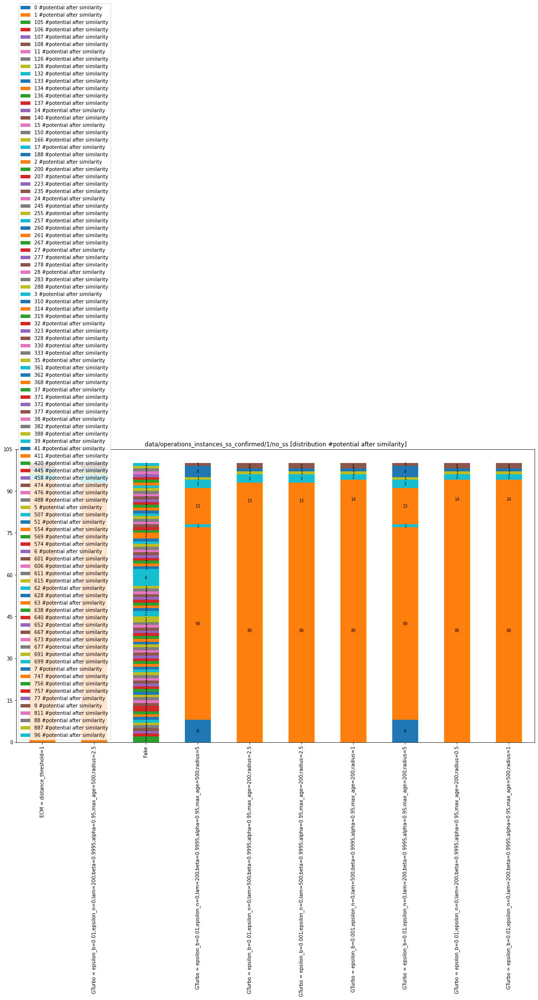

,-5 - 0 score range,0 - 5 score range,10 - 15 score range,100 - 100 score range,15 - 20 score range,20 - 25 score range,25 - 30 score range,30 - 35 score range,35 - 40 score range,40 - 45 score range,45 - 50 score range,5 - 10 score range,50 - 55 score range,55 - 60 score range,60 - 65 score range,65 - 70 score range,70 - 75 score range,75 - 80 score range,80 - 85 score range,85 - 90 score range,90 - 95 score range,95 - 100 score range
ECM = distance_threshold=1,0,0,0,7,0,0,0,0,3,14,11,0,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,7,0,0,0,0,3,14,12,0,18,21,16,6,2,2,10,28,31,3
Fake,67,1119,16383,7,29672,40094,40668,30463,18853,9882,4239,5501,1644,545,247,140,140,118,120,64,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,7,0,0,0,2,7,21,15,0,25,23,11,6,1,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,7,0,0,0,0,3,14,12,0,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,7,0,0,0,0,3,14,12,0,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,0,7,0,0,0,0,3,14,11,0,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,7,0,0,0,2,7,21,15,0,25,23,11,6,1,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,7,0,0,0,0,3,14,11,0,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,0,0,7,0,0,0,0,3,14,11,0,18,21,16,6,2,2,10,28,31,3


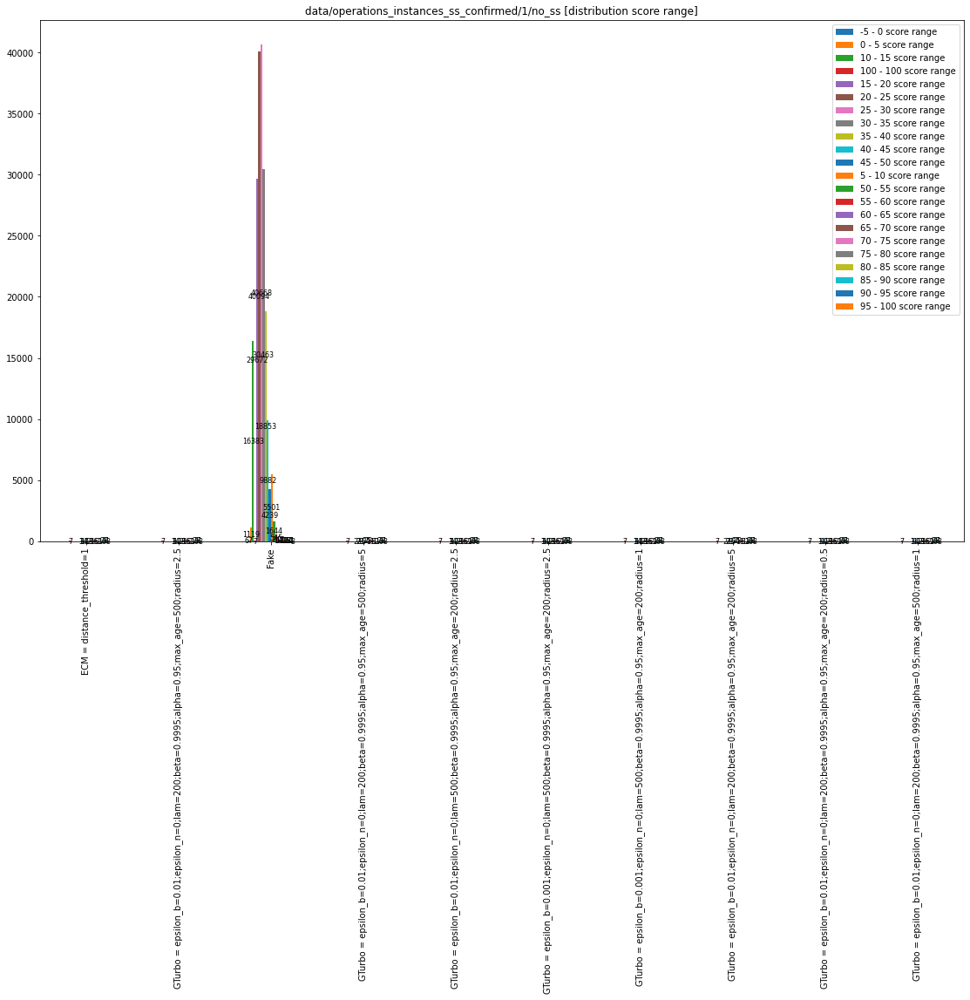

,100 - 100 matches score range,50 - 55 matches score range,55 - 60 matches score range,60 - 65 matches score range,65 - 70 matches score range,70 - 75 matches score range,75 - 80 matches score range,80 - 85 matches score range,85 - 90 matches score range,90 - 95 matches score range,95 - 100 matches score range
ECM = distance_threshold=1,7,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,7,18,21,16,6,2,2,10,28,31,3
Fake,7,1644,545,247,140,140,118,120,64,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,7,25,23,11,6,1,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,7,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,7,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,7,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,7,25,23,11,6,1,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,7,18,21,16,6,2,2,10,28,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,7,18,21,16,6,2,2,10,28,31,3


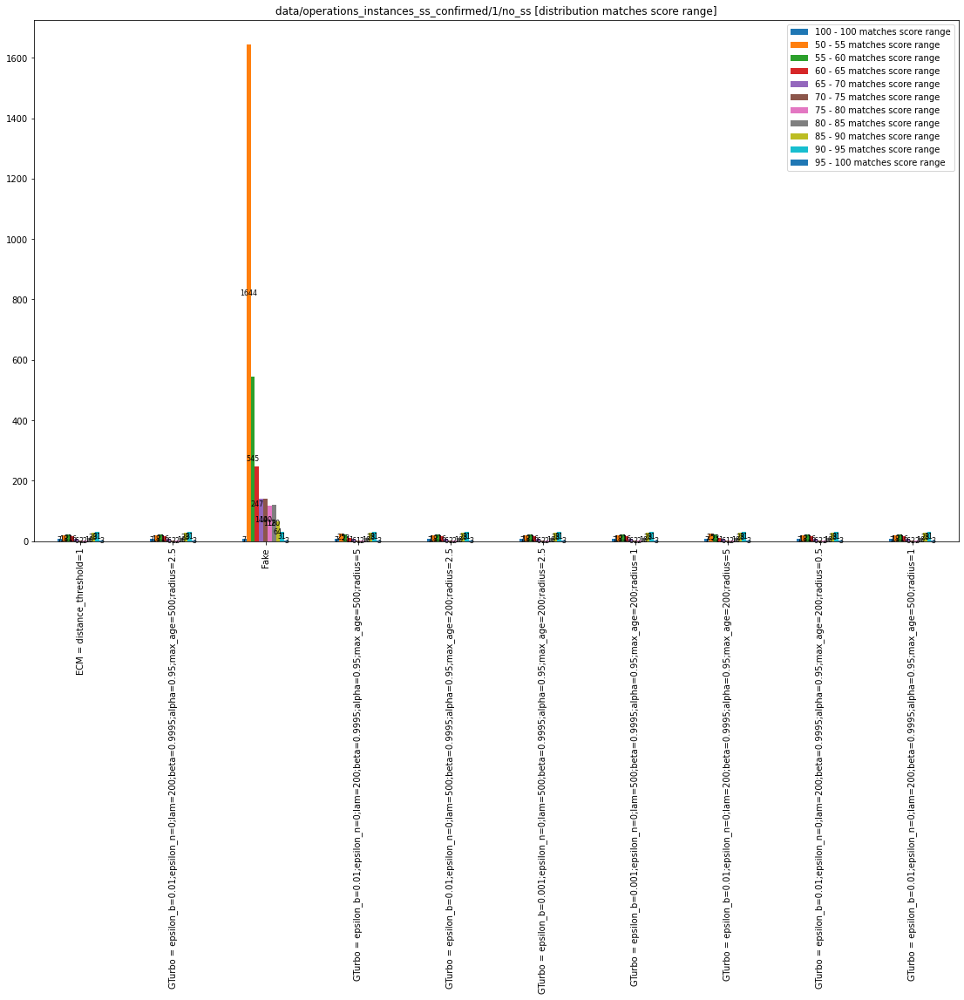

,-10 - -5 similarity score range,-15 - -10 similarity score range,-5 - 0 similarity score range,0 - 5 similarity score range,10 - 15 similarity score range,100 - 100 similarity score range,15 - 20 similarity score range,20 - 25 similarity score range,25 - 30 similarity score range,30 - 35 similarity score range,35 - 40 similarity score range,40 - 45 similarity score range,45 - 50 similarity score range,5 - 10 similarity score range,50 - 55 similarity score range,55 - 60 similarity score range,60 - 65 similarity score range,65 - 70 similarity score range,70 - 75 similarity score range,75 - 80 similarity score range,80 - 85 similarity score range,85 - 90 similarity score range,90 - 95 similarity score range,95 - 100 similarity score range
ECM = distance_threshold=1,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,10,33,21,13,9,1,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,11,33,21,13,9,1,3
Fake,28,4,1004,3248,12793,77,19111,22027,26028,23287,20758,18117,14907,8041,10818,7873,5574,3034,1904,955,363,28,18,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,27,23,32,15,9,1,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,11,33,21,13,9,1,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,11,33,21,13,9,1,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,10,33,21,13,9,1,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,27,23,32,15,9,1,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,10,33,21,13,9,1,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,2,3,10,33,21,13,9,1,3


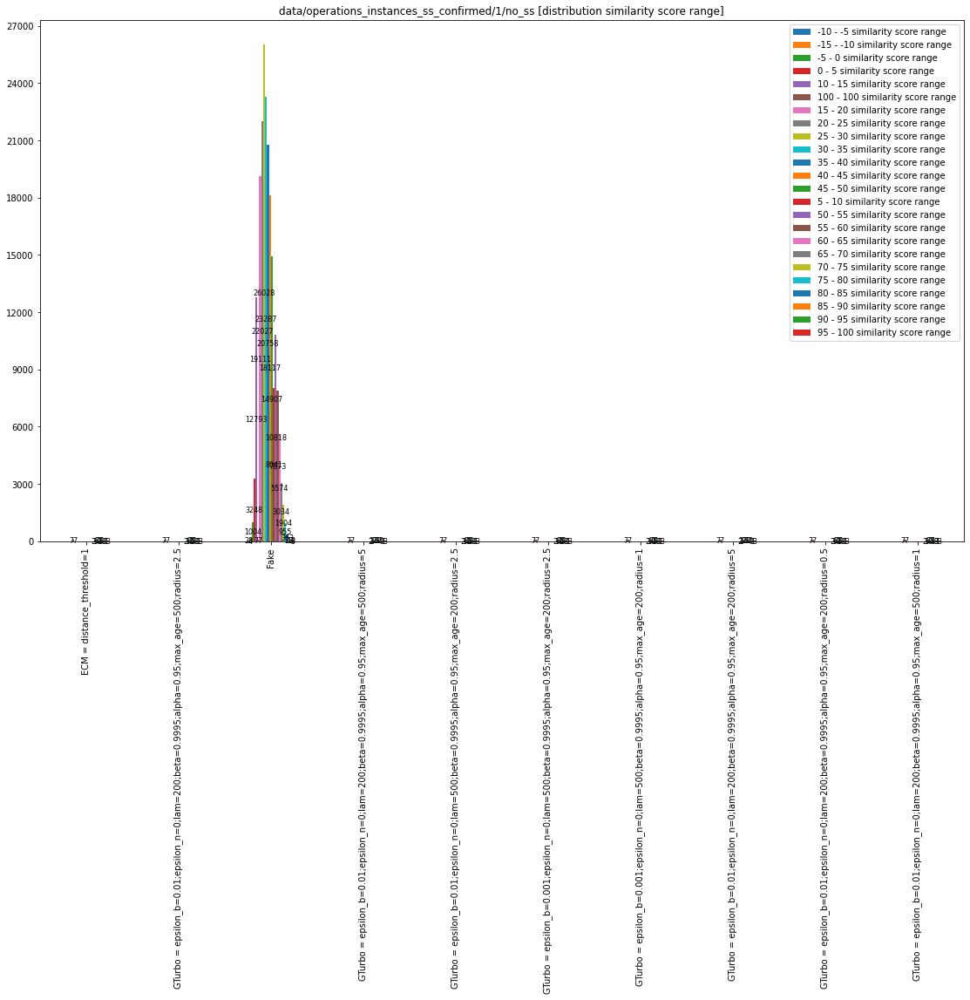

,0 - 5 quality score range,10 - 15 quality score range,100 - 100 quality score range,15 - 20 quality score range,20 - 25 quality score range,25 - 30 quality score range,30 - 35 quality score range,35 - 40 quality score range,40 - 45 quality score range,45 - 50 quality score range,5 - 10 quality score range,50 - 55 quality score range,55 - 60 quality score range,60 - 65 quality score range,65 - 70 quality score range,70 - 75 quality score range,75 - 80 quality score range,80 - 85 quality score range,85 - 90 quality score range,90 - 95 quality score range
ECM = distance_threshold=1,1,14,7,4,5,11,15,6,17,6,1,3,7,8,1,32,0,6,25,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,1,13,7,5,5,12,15,6,17,6,1,3,7,8,1,32,0,6,25,3
Fake,16498,77453,53,2361,14822,65976,7051,576,13564,244,606,117,164,76,1,211,1,27,173,26
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,2,26,7,5,5,22,15,7,18,4,1,3,3,8,1,31,0,6,25,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,1,13,7,5,5,12,15,6,17,6,1,3,7,8,1,32,0,6,25,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,1,13,7,5,5,12,15,6,17,6,1,3,7,8,1,32,0,6,25,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,1,14,7,4,5,11,15,6,17,6,1,3,7,8,1,32,0,6,25,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,2,26,7,5,5,22,15,7,18,4,1,3,3,8,1,31,0,6,25,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,1,14,7,4,5,11,15,6,17,6,1,3,7,8,1,32,0,6,25,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1,1,14,7,4,5,11,15,6,17,6,1,3,7,8,1,32,0,6,25,3


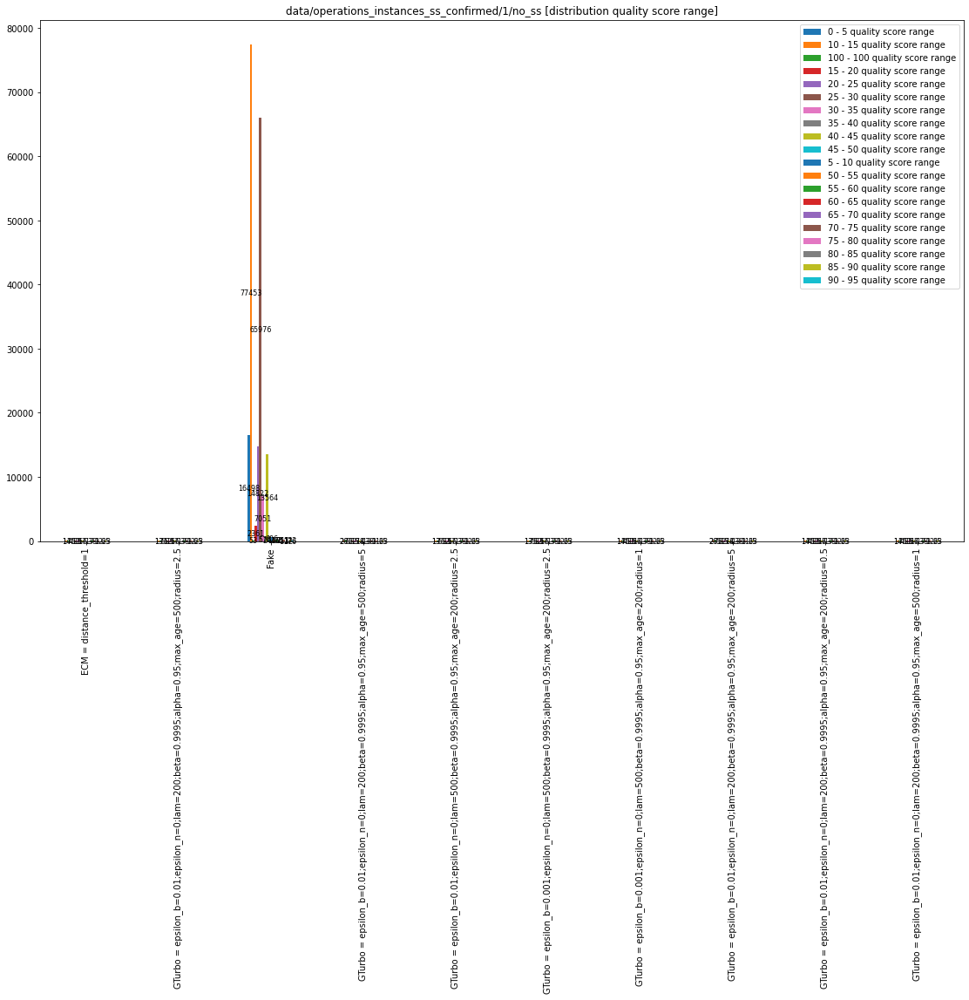

## OperationFile(layer='concat', test_subpath='1/concat', full_path='data/operations_instances_ss_confirmed/1/concat') - matches metrics

,bin deviation score
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,-10132.394986
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,-10132.394986
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,-10133.886810
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,-10132.394986
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,-10132.394986
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,-10103.915462
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,-10103.915462
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,-10103.915462
ECM = distance_threshold=1.5,-10132.394986
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,-10103.915462


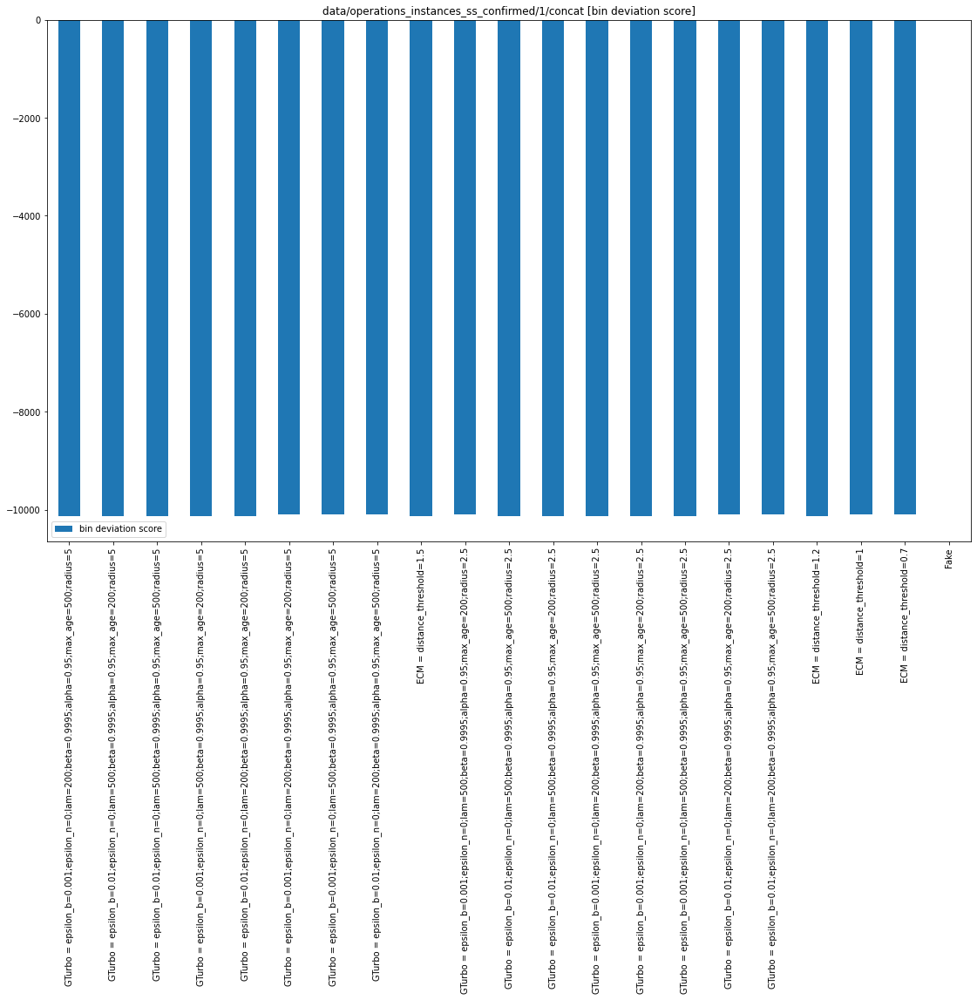

,0 #matches,1 #matches,10 #matches,100 #matches,102 #matches,106 #matches,113 #matches,116 #matches,12 #matches,120 #matches,122 #matches,124 #matches,126 #matches,128 #matches,13 #matches,131 #matches,134 #matches,14 #matches,145 #matches,146 #matches,149 #matches,15 #matches,154 #matches,159 #matches,168 #matches,17 #matches,174 #matches,187 #matches,19 #matches,2 #matches,20 #matches,202 #matches,213 #matches,22 #matches,23 #matches,246 #matches,25 #matches,26 #matches,27 #matches,29 #matches,305 #matches,306 #matches,31 #matches,320 #matches,321 #matches,34 #matches,344 #matches,35 #matches,36 #matches,37 #matches,4 #matches,41 #matches,47 #matches,5 #matches,51 #matches,52 #matches,53 #matches,54 #matches,58 #matches,62 #matches,63 #matches,65 #matches,66 #matches,67 #matches,68 #matches,7 #matches,73 #matches,74 #matches,76 #matches,79 #matches,8 #matches,81 #matches,82 #matches,85 #matches,86 #matches,88 #matches,89 #matches,9 #matches,92 #matches,93 #matches,94 #matches,96 #matches,97 #matches
Fake,0,0,2,1,1,2,1,2,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,1,0,4,1,1,2,1,1,2,1,2,1,1,1,1,1,1,1,1,1,2,2,0,1,1,1,1,1,2,1,1,1,1,1,3,1,1,2,1,1,1,1,1,1,1,1,3,1,1,2,1,2,1,1,1
ECM = distance_threshold=0.7,3,96,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ECM = distance_threshold=1,3,95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,3,89,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,3,89,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,3,89,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,3,95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,3,95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,3,95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,3,95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


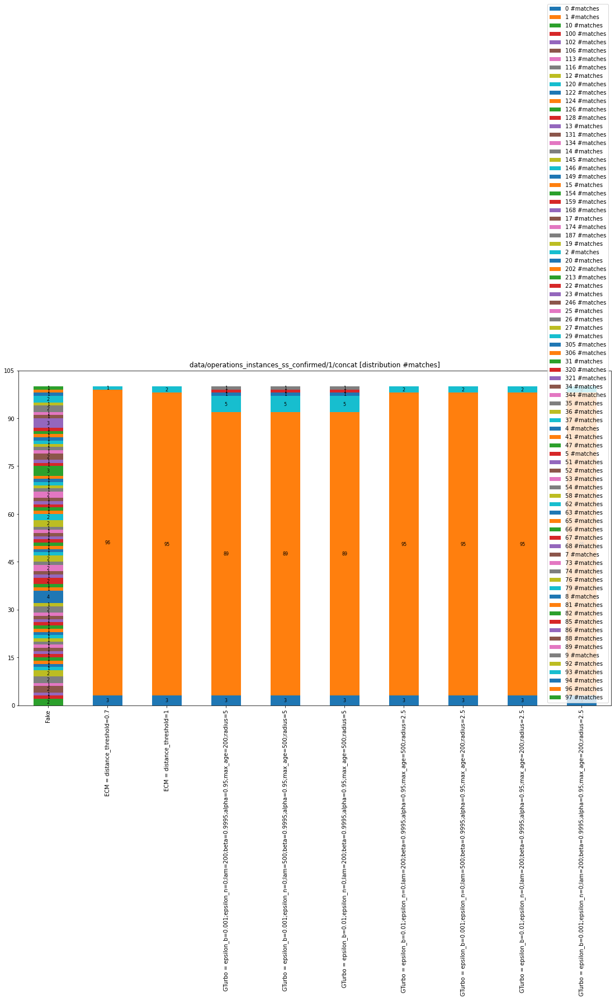

,1 #potential,2 #potential,2000 #potential,4 #potential,5 #potential,9 #potential
Fake,0,0,100,0,0,0
ECM = distance_threshold=0.7,99,1,0,0,0,0
ECM = distance_threshold=1,98,2,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,92,5,0,1,1,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,92,5,0,1,1,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,92,5,0,1,1,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,98,2,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,98,2,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,98,2,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,98,2,0,0,0,0


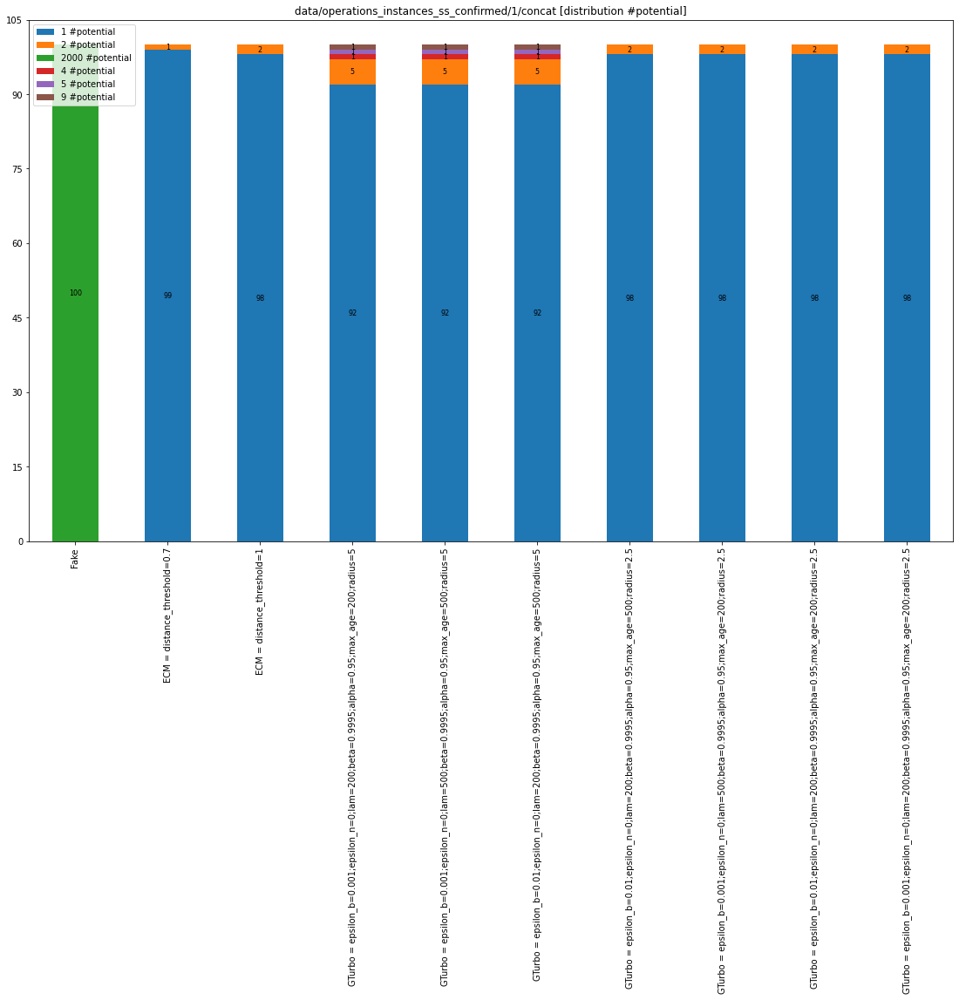

,1 #potential after similarity,1010 #potential after similarity,102 #potential after similarity,1030 #potential after similarity,1045 #potential after similarity,1047 #potential after similarity,1085 #potential after similarity,1095 #potential after similarity,1101 #potential after similarity,1103 #potential after similarity,1104 #potential after similarity,1106 #potential after similarity,1108 #potential after similarity,1142 #potential after similarity,1147 #potential after similarity,1149 #potential after similarity,1167 #potential after similarity,1169 #potential after similarity,1170 #potential after similarity,1190 #potential after similarity,1205 #potential after similarity,1206 #potential after similarity,1207 #potential after similarity,1215 #potential after similarity,1235 #potential after similarity,1239 #potential after similarity,1269 #potential after similarity,1306 #potential after similarity,1318 #potential after similarity,1330 #potential after similarity,1332 #potential after similarity,1370 #potential after similarity,1385 #potential after similarity,1388 #potential after similarity,1392 #potential after similarity,1400 #potential after similarity,1409 #potential after similarity,151 #potential after similarity,184 #potential after similarity,2 #potential after similarity,216 #potential after similarity,228 #potential after similarity,264 #potential after similarity,321 #potential after similarity,325 #potential after similarity,361 #potential after similarity,363 #potential after similarity,392 #potential after similarity,4 #potential after similarity,400 #potential after similarity,439 #potential after similarity,5 #potential after similarity,504 #potential after similarity,513 #potential after similarity,519 #potential after similarity,522 #potential after similarity,524 #potential after similarity,541 #potential after similarity,558 #potential after similarity,574 #potential after similarity,577 #potential after similarity,584 #potential after similarity,601 #potential after similarity,610 #potential after similarity,618 #potential after similarity,642 #potential after similarity,654 #potential after similarity,657 #potential after similarity,661 #potential after similarity,662 #potential after similarity,698 #potential after similarity,705 #potential after similarity,715 #potential after similarity,722 #potential after similarity,799 #potential after similarity,820 #potential after similarity,829 #potential after similarity,831 #potential after similarity,833 #potential after similarity,843 #potential after similarity,847 #potential after similarity,854 #potential after similarity,858 #potential after similarity,869 #potential after similarity,873 #potential after similarity,875 #potential after similarity,882 #potential after similarity,892 #potential after similarity,895 #potential after similarity,9 #potential after similarity,918 #potential after similarity,942 #potential after similarity,944 #potential after similarity,945 #potential after similarity,951 #potential after similarity,966 #potential after similarity,969 #potential after similarity,970 #potential after similarity,981 #potential after similarity,985 #potential after similarity,990 #potential after similarity,997 #potential after similarity
Fake,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,0,1,2,0,1,1,1,2,1,1,1,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1
ECM = distance_threshold=0.7,99,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ECM = distance_threshold=1,98,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=

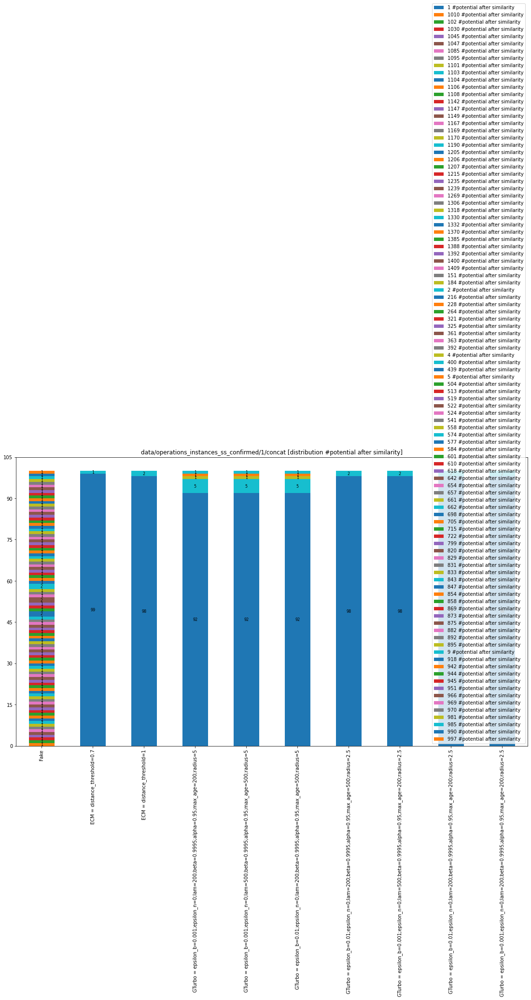

,10 - 15 score range,15 - 20 score range,20 - 25 score range,25 - 30 score range,30 - 35 score range,35 - 40 score range,40 - 45 score range,45 - 50 score range,5 - 10 score range,50 - 55 score range,55 - 60 score range,60 - 65 score range,65 - 70 score range,70 - 75 score range,75 - 80 score range,80 - 85 score range,85 - 90 score range,90 - 95 score range,95 - 100 score range
Fake,2887,8716,21205,35210,43229,38974,26648,14219,341,5563,1831,458,226,171,87,144,32,52,7
ECM = distance_threshold=0.7,0,0,0,0,0,0,1,2,0,9,16,28,14,6,6,4,3,7,5
ECM = distance_threshold=1,0,0,0,0,0,0,1,2,0,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,1,2,0,9,18,40,15,6,6,4,3,11,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,1,2,0,9,18,40,15,6,6,4,3,11,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,1,2,0,9,18,40,15,6,6,4,3,11,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,0,0,0,1,2,0,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,0,1,2,0,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,0,1,2,0,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,0,1,2,0,9,16,28,15,6,6,4,3,7,5


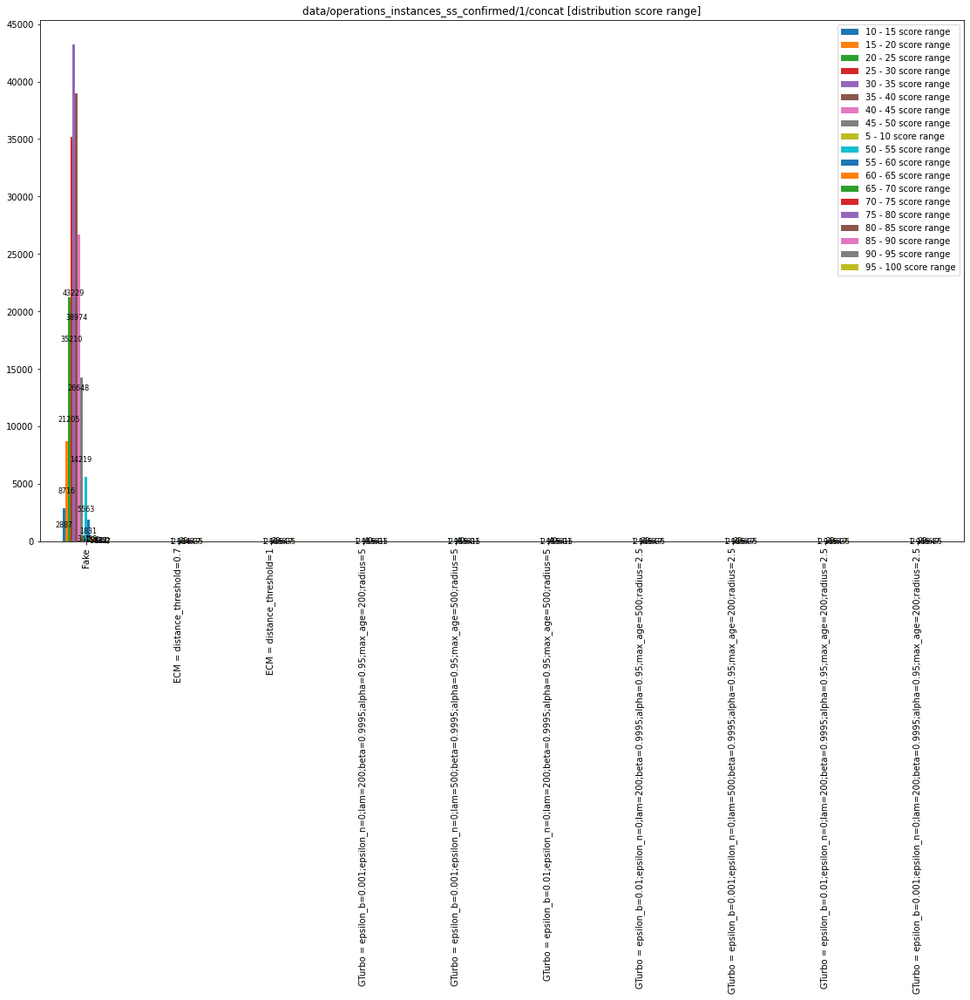

,50 - 55 matches score range,55 - 60 matches score range,60 - 65 matches score range,65 - 70 matches score range,70 - 75 matches score range,75 - 80 matches score range,80 - 85 matches score range,85 - 90 matches score range,90 - 95 matches score range,95 - 100 matches score range
Fake,5563,1831,458,226,171,87,144,32,52,7
ECM = distance_threshold=0.7,9,16,28,14,6,6,4,3,7,5
ECM = distance_threshold=1,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,9,18,40,15,6,6,4,3,11,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,9,18,40,15,6,6,4,3,11,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,9,18,40,15,6,6,4,3,11,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,9,16,28,15,6,6,4,3,7,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,9,16,28,15,6,6,4,3,7,5


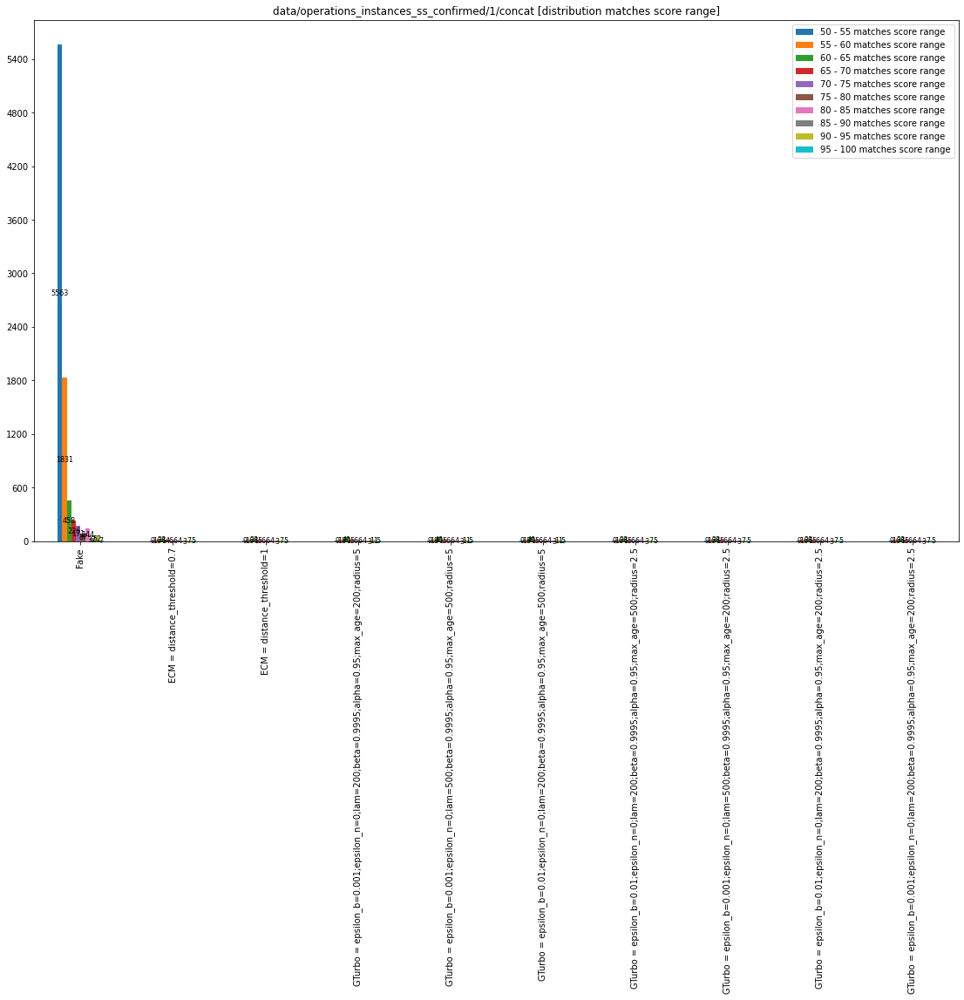

,10 - 15 similarity score range,15 - 20 similarity score range,20 - 25 similarity score range,25 - 30 similarity score range,30 - 35 similarity score range,35 - 40 similarity score range,40 - 45 similarity score range,45 - 50 similarity score range,50 - 55 similarity score range,55 - 60 similarity score range,60 - 65 similarity score range,65 - 70 similarity score range,70 - 75 similarity score range,75 - 80 similarity score range,80 - 85 similarity score range,85 - 90 similarity score range,90 - 95 similarity score range,95 - 100 similarity score range
Fake,98,635,2793,8054,16180,24599,30408,32059,28715,23024,16158,9843,4993,1904,410,64,49,14
ECM = distance_threshold=0.7,0,0,0,0,0,0,0,0,0,0,0,2,8,23,31,18,11,8
ECM = distance_threshold=1,0,0,0,0,0,0,0,0,0,0,0,2,8,23,31,19,11,8
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,0,0,0,0,0,2,9,24,45,21,11,8
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,0,0,0,0,0,2,9,24,45,21,11,8
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,0,0,0,0,0,2,9,24,45,21,11,8
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,0,0,0,0,0,0,0,0,2,8,23,31,19,11,8
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,0,0,0,0,0,0,2,8,23,31,19,11,8
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,0,0,0,0,0,0,2,8,23,31,19,11,8
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,0,0,0,0,0,0,0,0,0,0,0,2,8,23,31,19,11,8


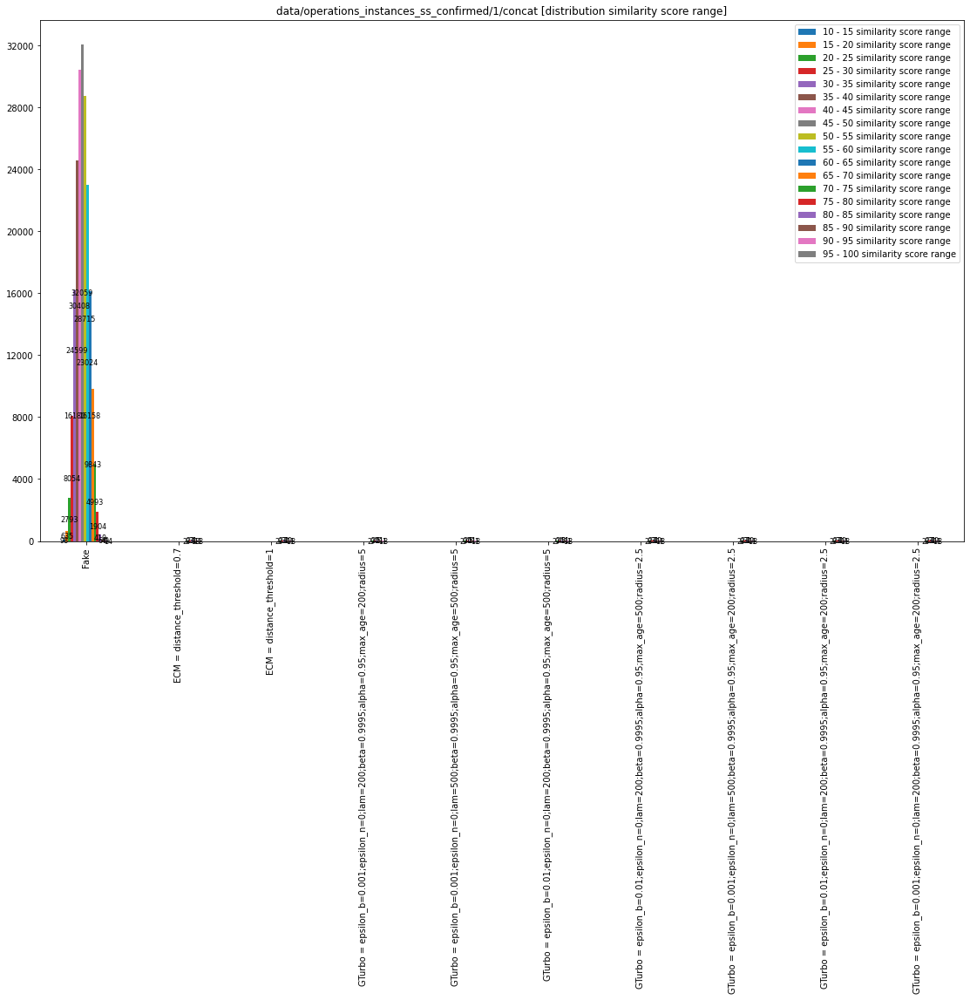

,0 - 5 quality score range,10 - 15 quality score range,100 - 100 quality score range,15 - 20 quality score range,20 - 25 quality score range,25 - 30 quality score range,30 - 35 quality score range,35 - 40 quality score range,40 - 45 quality score range,45 - 50 quality score range,5 - 10 quality score range,50 - 55 quality score range,55 - 60 quality score range,60 - 65 quality score range,65 - 70 quality score range,70 - 75 quality score range,75 - 80 quality score range,80 - 85 quality score range,85 - 90 quality score range,90 - 95 quality score range
Fake,16498,77453,53,2361,14822,65976,7051,576,13564,244,606,117,164,76,1,211,1,27,173,26
ECM = distance_threshold=0.7,1,1,7,0,1,2,10,3,28,16,0,5,3,5,1,10,0,2,5,1
ECM = distance_threshold=1,1,1,7,0,1,2,10,3,29,16,0,5,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,1,1,11,0,1,2,10,4,42,15,0,6,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,1,1,11,0,1,2,10,4,42,15,0,6,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,1,1,11,0,1,2,10,4,42,15,0,6,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,1,1,7,0,1,2,10,3,29,16,0,5,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,1,1,7,0,1,2,10,3,29,16,0,5,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,1,1,7,0,1,2,10,3,29,16,0,5,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,1,1,7,0,1,2,10,3,29,16,0,5,3,5,1,10,0,2,5,1


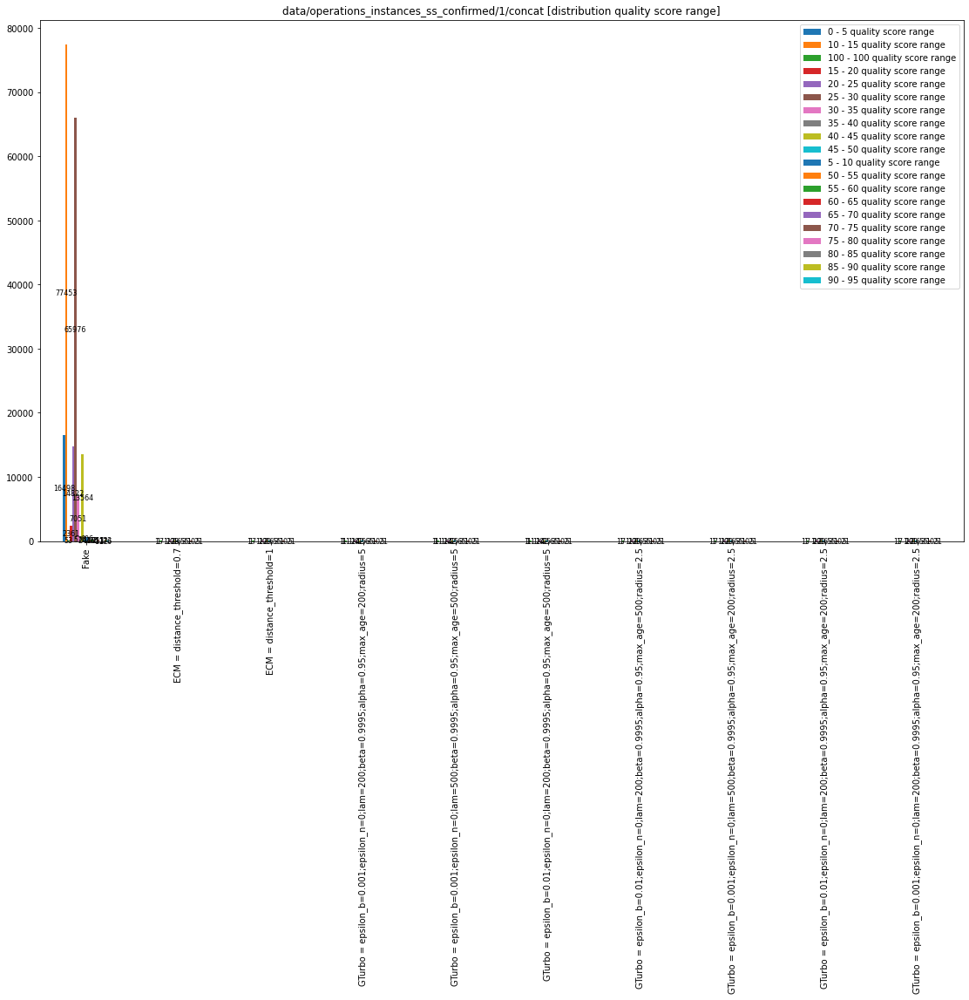

## OperationFile(layer='avg', test_subpath='1/avg', full_path='data/operations_instances_ss_confirmed/1/avg') - matches metrics

,bin deviation score
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,-29650.056670
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,-29652.286516
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,-29650.666235
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,-29650.239300
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,-29641.984672
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,-29477.428772
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,-29650.666235
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,-29477.428772
ECM = distance_threshold=1.5,-29650.666235
ECM = distance_threshold=1.2,-29476.900153


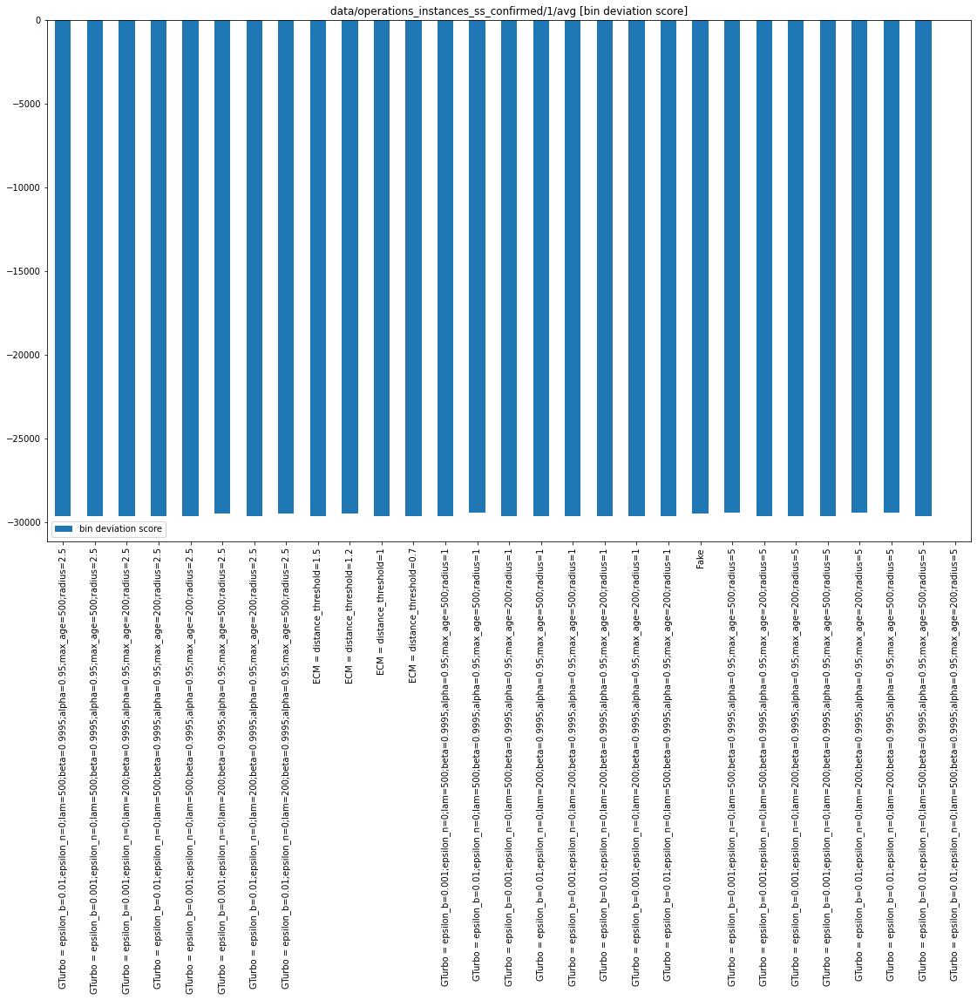

,0 #matches,1 #matches,10 #matches,104 #matches,11 #matches,110 #matches,111 #matches,118 #matches,119 #matches,12 #matches,13 #matches,139 #matches,141 #matches,145 #matches,156 #matches,158 #matches,159 #matches,16 #matches,161 #matches,163 #matches,165 #matches,171 #matches,173 #matches,187 #matches,19 #matches,190 #matches,191 #matches,2 #matches,20 #matches,202 #matches,206 #matches,210 #matches,217 #matches,218 #matches,229 #matches,231 #matches,237 #matches,244 #matches,245 #matches,246 #matches,247 #matches,258 #matches,259 #matches,260 #matches,261 #matches,27 #matches,276 #matches,279 #matches,29 #matches,296 #matches,297 #matches,3 #matches,301 #matches,302 #matches,309 #matches,330 #matches,335 #matches,348 #matches,349 #matches,35 #matches,352 #matches,360 #matches,369 #matches,377 #matches,38 #matches,4 #matches,403 #matches,41 #matches,418 #matches,422 #matches,43 #matches,44 #matches,440 #matches,451 #matches,452 #matches,455 #matches,457 #matches,463 #matches,495 #matches,5 #matches,50 #matches,51 #matches,576 #matches,636 #matches,64 #matches,648 #matches,664 #matches,68 #matches,71 #matches,74 #matches,740 #matches,756 #matches,76 #matches,768 #matches,772 #matches,8 #matches,815 #matches,86 #matches,87 #matches,92 #matches,93 #matches,96 #matches
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,4,59,0,0,1,0,0,0,0,1,4,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,19,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,3,95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,6,59,0,0,1,0,0,0,0,1,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,6,59,0,0,1,0,0,0,0,1,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,3,58,1,0,0,0,0,0,0,1,4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,21,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
Fake,0,0,0,2,0,1,1,1,1,0,0,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,1,0,1,1,1,1,3,1,2,1,1,1,1,1,1,1,1,1,1,2,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1,1,1,1,3,0,1,1,2,1,1,1,1,1,2,1,1,1,1,0,1,1,1,1,1,1,1,1,2,1,1,1,1,1,1,0,1,1,1,1,1,2
ECM = distance_threshold=1.2,3,95,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,4,90,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,4,90,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,3,58,1,0,0,0,0,0,0,1,4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,21,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,

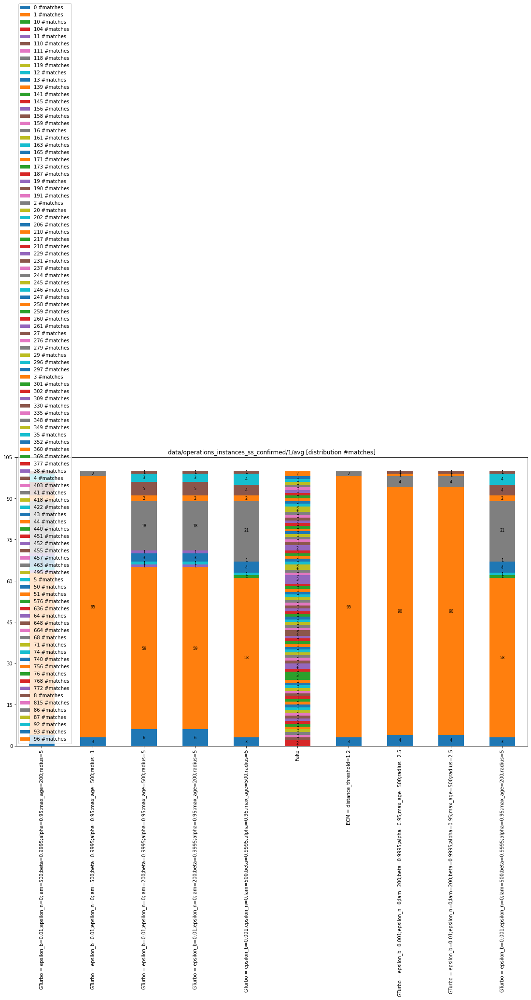

,0 #potential,1 #potential,10 #potential,11 #potential,12 #potential,13 #potential,16 #potential,19 #potential,2 #potential,2000 #potential,3 #potential,4 #potential,5 #potential,8 #potential
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,1,62,0,1,1,4,0,1,19,0,2,5,3,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,98,0,0,0,0,0,0,2,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,3,62,0,1,1,3,0,1,18,0,2,5,3,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,3,62,0,1,1,3,0,1,18,0,2,5,3,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,61,1,0,1,4,1,0,21,0,2,4,4,1
Fake,0,0,0,0,0,0,0,0,0,100,0,0,0,0
ECM = distance_threshold=1.2,0,98,0,0,0,0,0,0,2,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,1,93,0,0,0,0,0,0,4,0,1,1,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,1,93,0,0,0,0,0,0,4,0,1,1,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,61,1,0,1,4,1,0,21,0,2,4,4,1


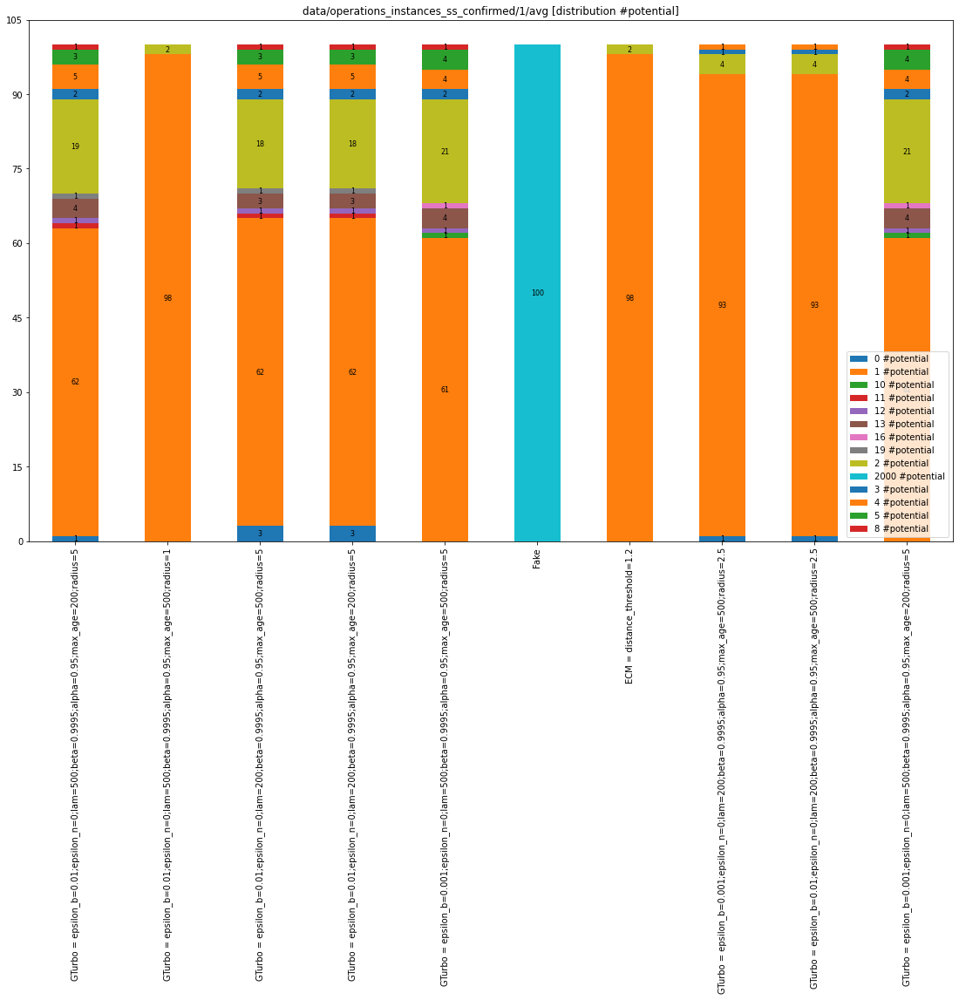

,0 #potential after similarity,1 #potential after similarity,10 #potential after similarity,1025 #potential after similarity,1048 #potential after similarity,1076 #potential after similarity,11 #potential after similarity,1107 #potential after similarity,1149 #potential after similarity,12 #potential after similarity,1206 #potential after similarity,1234 #potential after similarity,1262 #potential after similarity,1293 #potential after similarity,13 #potential after similarity,1309 #potential after similarity,1326 #potential after similarity,1342 #potential after similarity,1356 #potential after similarity,1357 #potential after similarity,1372 #potential after similarity,1378 #potential after similarity,1409 #potential after similarity,1422 #potential after similarity,1425 #potential after similarity,1442 #potential after similarity,1444 #potential after similarity,1473 #potential after similarity,1480 #potential after similarity,1503 #potential after similarity,1533 #potential after similarity,1544 #potential after similarity,1574 #potential after similarity,16 #potential after similarity,1601 #potential after similarity,1605 #potential after similarity,1616 #potential after similarity,1621 #potential after similarity,1634 #potential after similarity,1639 #potential after similarity,1640 #potential after similarity,1643 #potential after similarity,1666 #potential after similarity,1668 #potential after similarity,1669 #potential after similarity,1672 #potential after similarity,1675 #potential after similarity,1676 #potential after similarity,1692 #potential after similarity,1698 #potential after similarity,1707 #potential after similarity,1715 #potential after similarity,1722 #potential after similarity,1728 #potential after similarity,1733 #potential after similarity,1734 #potential after similarity,1739 #potential after similarity,1757 #potential after similarity,1758 #potential after similarity,1764 #potential after similarity,1771 #potential after similarity,1773 #potential after similarity,1774 #potential after similarity,1775 #potential after similarity,1780 #potential after similarity,1788 #potential after similarity,1789 #potential after similarity,1806 #potential after similarity,1810 #potential after similarity,1811 #potential after similarity,1812 #potential after similarity,1813 #potential after similarity,1818 #potential after similarity,1832 #potential after similarity,1844 #potential after similarity,1845 #potential after similarity,1848 #potential after similarity,1850 #potential after similarity,1852 #potential after similarity,1862 #potential after similarity,1863 #potential after similarity,1864 #potential after similarity,1865 #potential after similarity,1868 #potential after similarity,1878 #potential after similarity,1881 #potential after similarity,1885 #potential after similarity,19 #potential after similarity,1903 #potential after similarity,1906 #potential after similarity,1920 #potential after similarity,1931 #potential after similarity,1933 #potential after similarity,1934 #potential after similarity,1936 #potential after similarity,1943 #potential after similarity,1944 #potential after similarity,1945 #potential after similarity,1993 #potential after similarity,2 #potential after similarity,3 #potential after similarity,4 #potential after similarity,5 #potential after similarity,8 #potential after similarity,865 #potential after similarity
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,1,62,0,0,0,0,1,0,0,1,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,19,2,5,3,1,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,98,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

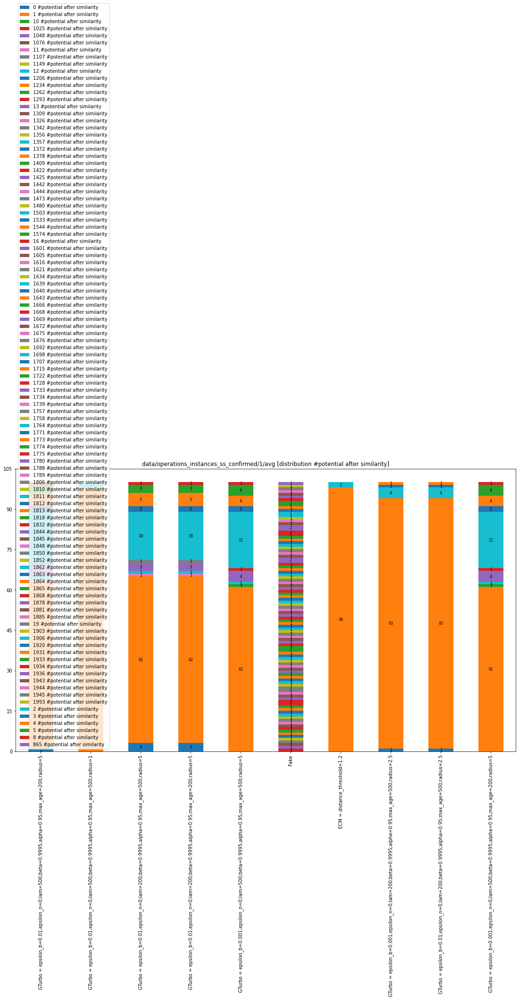

,10 - 15 score range,15 - 20 score range,20 - 25 score range,25 - 30 score range,30 - 35 score range,35 - 40 score range,40 - 45 score range,45 - 50 score range,5 - 10 score range,50 - 55 score range,55 - 60 score range,60 - 65 score range,65 - 70 score range,70 - 75 score range,75 - 80 score range,80 - 85 score range,85 - 90 score range,90 - 95 score range,95 - 100 score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,0,3,0,16,42,72,54,13,4,8,3,21,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,0,0,0,0,0,0,3,0,5,9,27,23,8,6,6,2,8,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,0,3,0,14,42,72,54,13,4,8,2,9,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,0,3,0,14,42,72,54,13,4,8,2,9,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,0,3,0,17,42,73,52,13,4,8,3,21,7
Fake,165,1439,5519,16349,30927,43840,44976,31349,2,17130,5733,1584,378,202,122,154,58,66,7
ECM = distance_threshold=1.2,0,0,0,0,0,0,0,3,0,5,11,27,20,8,6,6,2,9,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,0,0,0,0,3,0,5,12,30,22,8,6,6,2,9,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,0,0,0,0,3,0,5,12,30,22,8,6,6,2,9,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,0,3,0,17,42,73,52,13,4,8,3,21,7


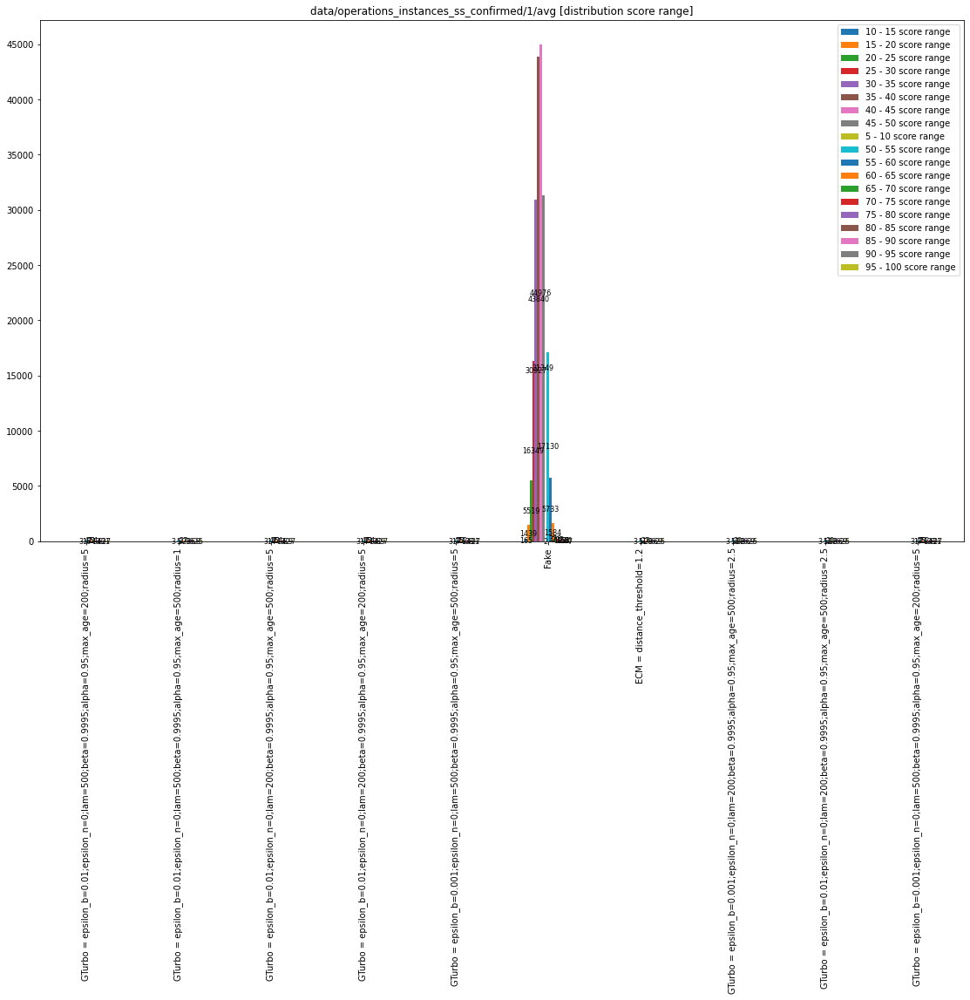

,50 - 55 matches score range,55 - 60 matches score range,60 - 65 matches score range,65 - 70 matches score range,70 - 75 matches score range,75 - 80 matches score range,80 - 85 matches score range,85 - 90 matches score range,90 - 95 matches score range,95 - 100 matches score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,16,42,72,54,13,4,8,3,21,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,5,9,27,23,8,6,6,2,8,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,14,42,72,54,13,4,8,2,9,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,14,42,72,54,13,4,8,2,9,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,17,42,73,52,13,4,8,3,21,7
Fake,17130,5733,1584,378,202,122,154,58,66,7
ECM = distance_threshold=1.2,5,11,27,20,8,6,6,2,9,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,5,12,30,22,8,6,6,2,9,5
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,5,12,30,22,8,6,6,2,9,5
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,17,42,73,52,13,4,8,3,21,7


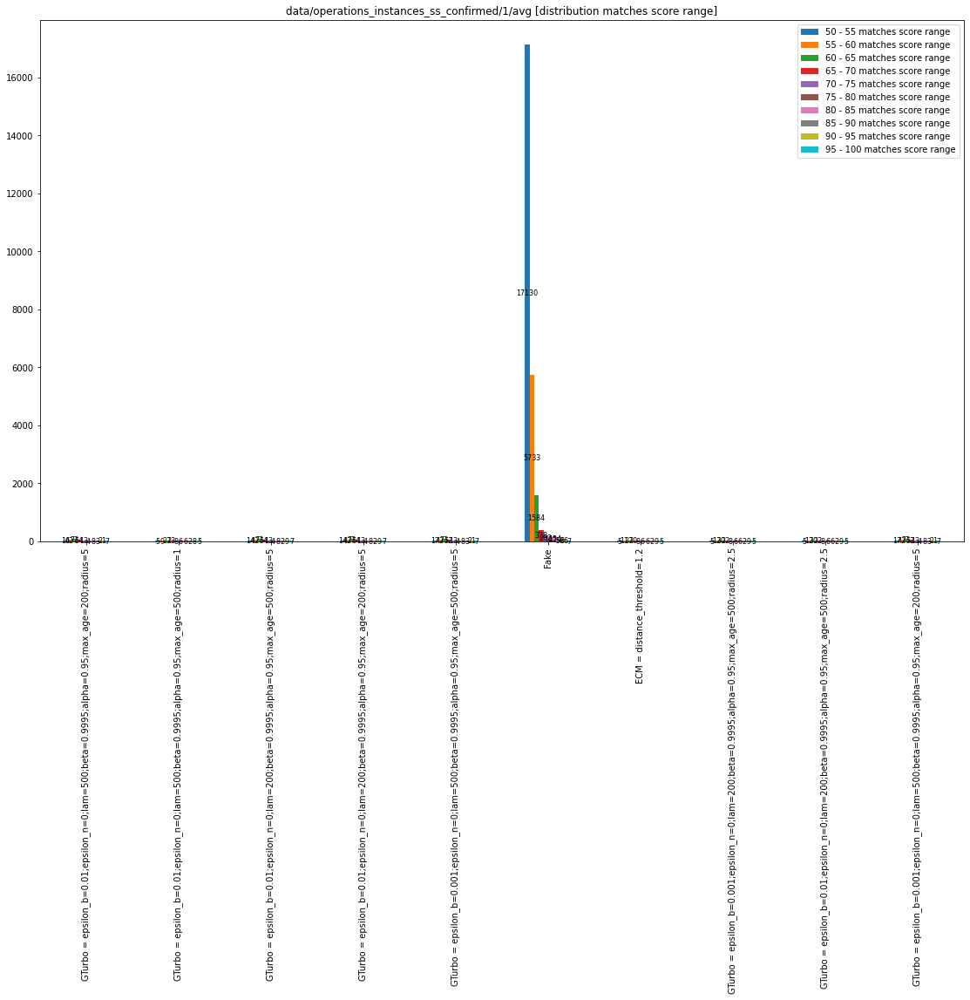

,15 - 20 similarity score range,20 - 25 similarity score range,25 - 30 similarity score range,30 - 35 similarity score range,35 - 40 similarity score range,40 - 45 similarity score range,45 - 50 similarity score range,50 - 55 similarity score range,55 - 60 similarity score range,60 - 65 similarity score range,65 - 70 similarity score range,70 - 75 similarity score range,75 - 80 similarity score range,80 - 85 similarity score range,85 - 90 similarity score range,90 - 95 similarity score range,95 - 100 similarity score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,0,0,0,0,1,2,15,52,134,25,14
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,0,0,0,0,0,0,0,0,0,0,1,6,15,48,21,11
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,0,0,0,0,1,2,14,51,121,25,14
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,0,0,0,0,1,2,14,51,121,25,14
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,0,0,0,0,0,0,0,0,0,0,1,2,17,51,134,24,14
Fake,2,51,251,1159,4429,10448,18299,26811,32175,33580,30075,23308,13443,4956,906,73,34
ECM = distance_threshold=1.2,0,0,0,0,0,0,0,0,0,0,0,1,6,16,51,17,11
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,0,0,0,0,0,0,0,0,1,8,15,53,20,11
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,0,0,0,0,0,0,0,0,0,0,0,1,8,15,53,20,11
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,0,0,0,0,0,0,0,0,0,0,1,2,17,51,134,24,14


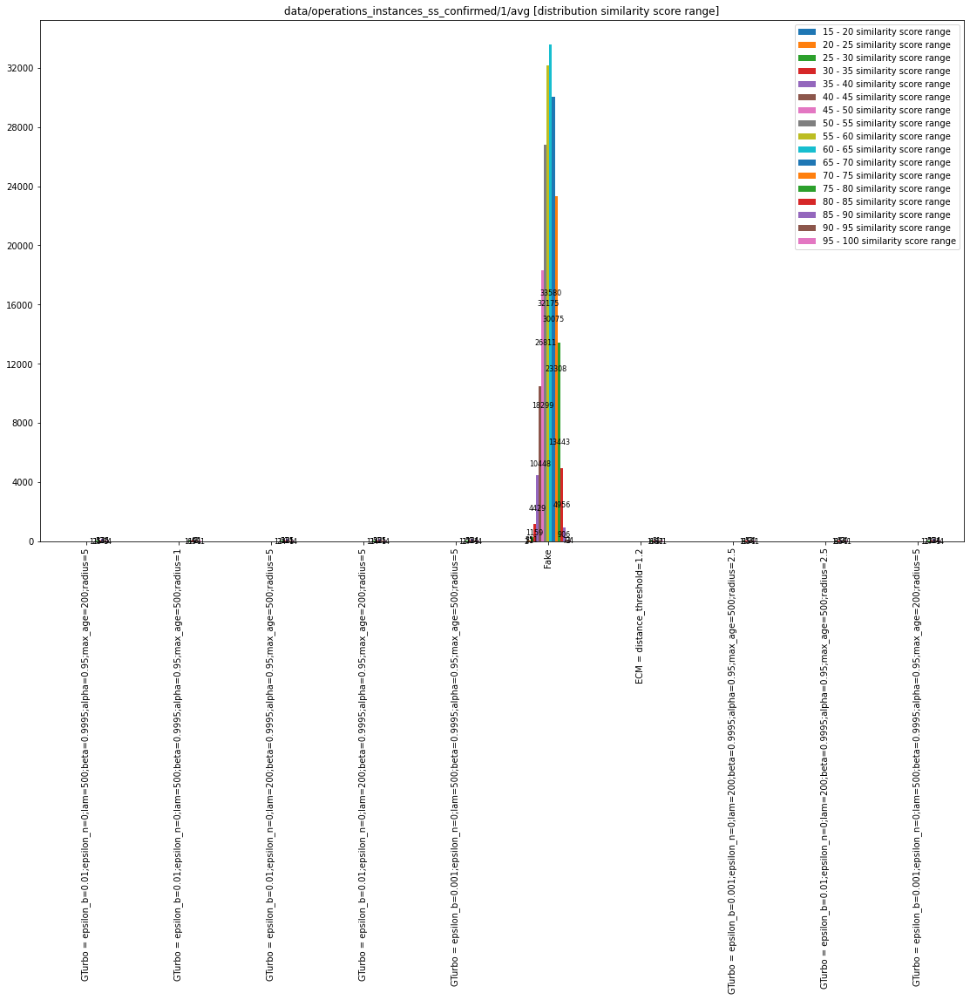

,0 - 5 quality score range,10 - 15 quality score range,100 - 100 quality score range,15 - 20 quality score range,20 - 25 quality score range,25 - 30 quality score range,30 - 35 quality score range,35 - 40 quality score range,40 - 45 quality score range,45 - 50 quality score range,5 - 10 quality score range,50 - 55 quality score range,55 - 60 quality score range,60 - 65 quality score range,65 - 70 quality score range,70 - 75 quality score range,75 - 80 quality score range,80 - 85 quality score range,85 - 90 quality score range,90 - 95 quality score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,1,1,20,0,5,19,31,12,75,27,0,15,9,5,1,11,0,2,6,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,1,1,7,0,2,5,9,2,29,14,0,5,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5,1,1,8,0,5,17,31,12,75,27,0,15,9,5,1,11,0,2,6,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5,1,1,8,0,5,17,31,12,75,27,0,15,9,5,1,11,0,2,6,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=5,1,1,20,0,5,19,32,12,75,26,0,15,9,5,1,11,0,2,6,3
Fake,16498,77453,53,2361,14822,65976,7051,576,13564,244,606,117,164,76,1,211,1,27,173,26
ECM = distance_threshold=1.2,1,1,8,0,2,7,9,2,26,13,0,6,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,1,1,8,0,2,6,9,3,32,13,0,6,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,1,1,8,0,2,6,9,3,32,13,0,6,3,5,1,10,0,2,5,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=5,1,1,20,0,5,19,32,12,75,26,0,15,9,5,1,11,0,2,6,3


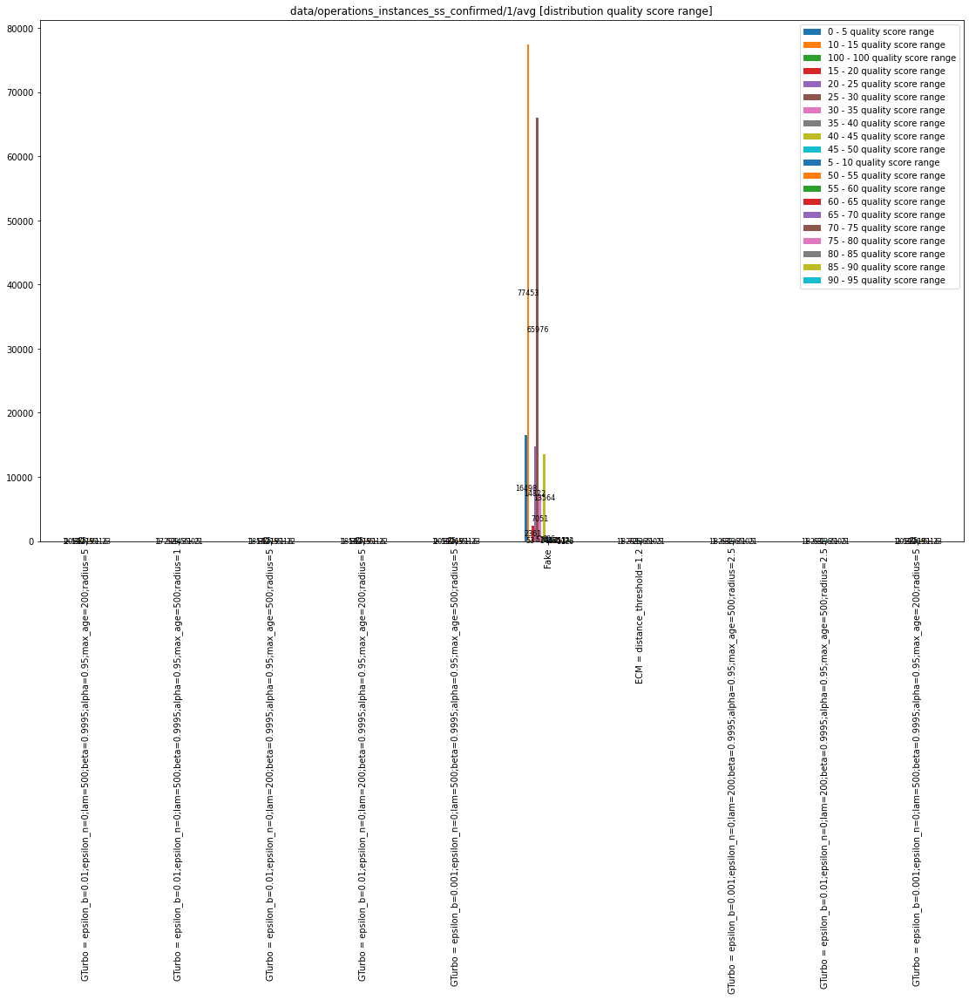

## OperationFile(layer='no_ss_norm', test_subpath='1/no_ss_norm', full_path='data/operations_instances_ss_confirmed/1/no_ss_norm') - matches metrics

,bin deviation score
ECM = distance_threshold=0.01,-3325.809504
ECM = distance_threshold=0.001,-915.808693
ECM = distance_threshold=0.1,-3325.809504
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-3309.034208
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-2562.627505
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-3316.384941
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-3307.826158
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-3384.814272
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-1144.714205
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-3240.615202


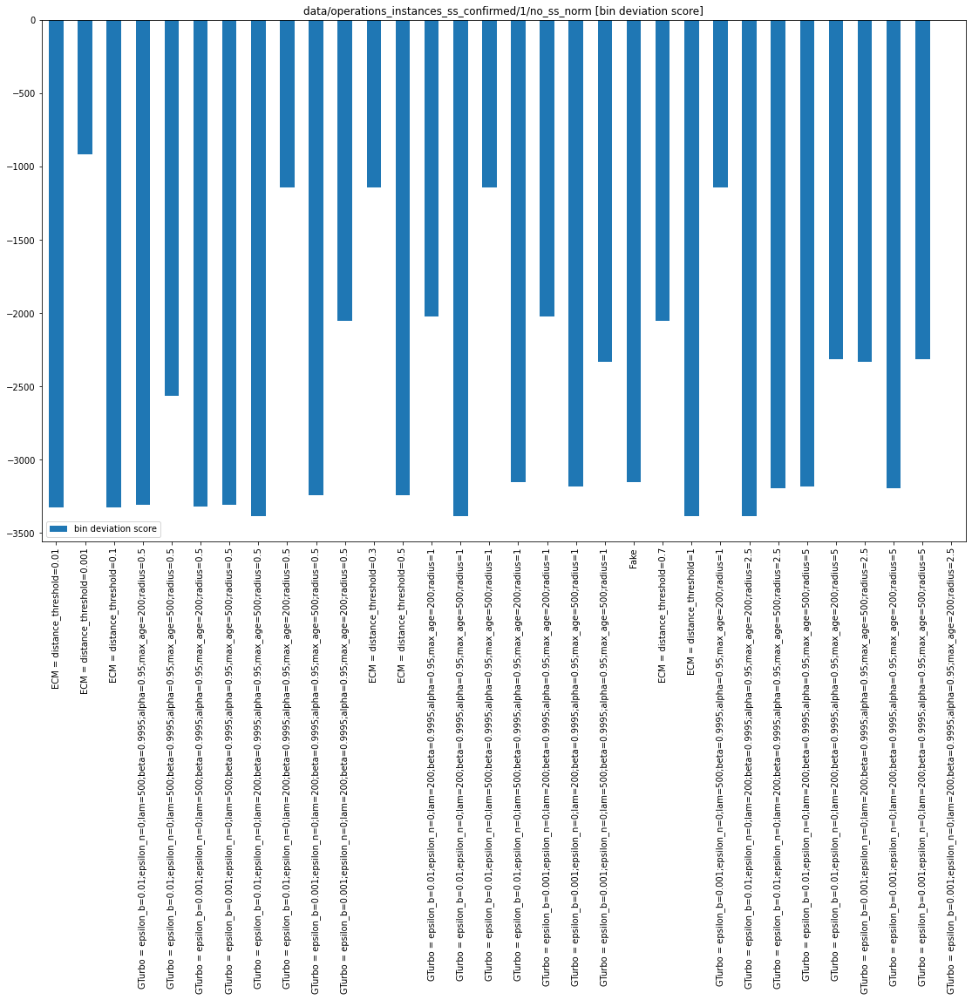

,0 #matches,1 #matches,10 #matches,101 #matches,11 #matches,12 #matches,13 #matches,14 #matches,140 #matches,15 #matches,16 #matches,17 #matches,171 #matches,18 #matches,19 #matches,2 #matches,20 #matches,21 #matches,22 #matches,23 #matches,24 #matches,25 #matches,26 #matches,27 #matches,28 #matches,29 #matches,3 #matches,30 #matches,31 #matches,32 #matches,33 #matches,34 #matches,35 #matches,36 #matches,37 #matches,38 #matches,39 #matches,4 #matches,40 #matches,41 #matches,42 #matches,43 #matches,44 #matches,45 #matches,46 #matches,47 #matches,48 #matches,49 #matches,5 #matches,50 #matches,51 #matches,52 #matches,53 #matches,55 #matches,56 #matches,59 #matches,6 #matches,61 #matches,63 #matches,67 #matches,7 #matches,74 #matches,76 #matches,78 #matches,79 #matches,8 #matches,80 #matches,81 #matches,82 #matches,83 #matches,84 #matches,85 #matches,87 #matches,88 #matches,89 #matches,9 #matches,90 #matches,92 #matches,93 #matches,95 #matches,99 #matches
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,17,7,1,1,0,2,0,1,0,0,1,2,0,1,3,5,0,2,3,1,0,1,0,3,3,0,3,0,0,0,0,1,3,1,2,1,0,2,1,0,2,0,0,1,0,0,0,1,11,2,0,0,1,0,1,1,2,0,1,0,1,0,1,0,0,0,0,0,1,1,1,2,0,0,0,1,0,1,0,0,0
ECM = distance_threshold=0.001,14,61,0,0,0,0,1,0,0,0,0,0,0,0,0,14,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,13,8,1,0,2,3,3,2,0,1,2,0,0,0,2,7,3,0,1,1,2,0,4,1,0,1,6,1,0,0,0,0,1,0,0,0,0,2,0,2,0,0,0,0,0,0,1,0,6,0,0,0,0,0,0,0,6,0,0,0,6,0,0,0,1,4,0,2,0,0,1,0,0,0,1,2,1,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,20,38,1,0,0,0,2,1,0,0,0,0,0,0,0,15,0,0,0,0,0,0,0,0,1,0,7,0,0,0,0,0,0,1,0,0,0,3,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,2,0,0,0,2,0,0,0,0,2,0,2,0,0,0,0,0,0,0,1,0,0,0,0,0
ECM = distance_threshold=0.3,29,40,1,0,0,0,1,1,0,0,0,0,0,0,0,12,0,0,0,0,0,0,0,0,0,0,9,0,0,0,0,0,0,1,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,1,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,24,7,1,0,2,3,1,3,0,0,4,0,0,0,2,3,1,3,1,1,2,1,2,0,0,2,4,0,0,1,1,0,0,1,1,0,0,7,1,0,0,0,0,1,0,0,1,1,5,0,0,0,0,0,0,0,1,0,0,0,3,0,0,0,1,2,0,2,0,0,0,0,0,0,1,2,1,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,32,4,2,0,2,2,1,2,0,0,1,2,0,0,3,5,1,2,1,0,1,0,2,1,1,1,5,0,1,1,0,0,0,0,0,0,0,6,0,0,1,0,0,0,0,1,0,0,6,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,1,1,0,2,0,0,0,0,0,0,2,3,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,20,9,4,0,2,1,1,1,0,4,0,0,0,0,1,8,2,1,0,0,2,1,2,0,0,1,6,0,0,0,0,0,1,0,0,0,0,3,1,0,0,0,0,0,0,0,0,1,5,0,1,0,0,0,0,0,10,0,0,0,3,0,0,1,0,3,0,2,0,0,1,0,0,1,0,1,0,0,0,0,0
ECM = distance_threshold=0.7,23,12,1,0,0,1,3,0,0,0,0,1,0,0,2,13,0,0,0,1,0,0,0,3,0,0,9,1,0,1,0,0,0,0,0,0,0,8,0,0,0,0,0,0,1,0,0,0,5,0,0,0,0,0,0,0,3,0,0,0,4,0,0,0,0,2,0,2,0,0,1,0,1,0,0,1,0,0,0,0,1
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,24,39,0,0,1,0,2,1,0,0,0,0,0,0,0,13,0,0,0,0,0,0,0,0,0,0,7,0,0,0,0,0,0,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,2,0,0,0,2,0,0,0,0,2,0,2,0,0,0,0,0,0,0,1,0,0,0,0,0


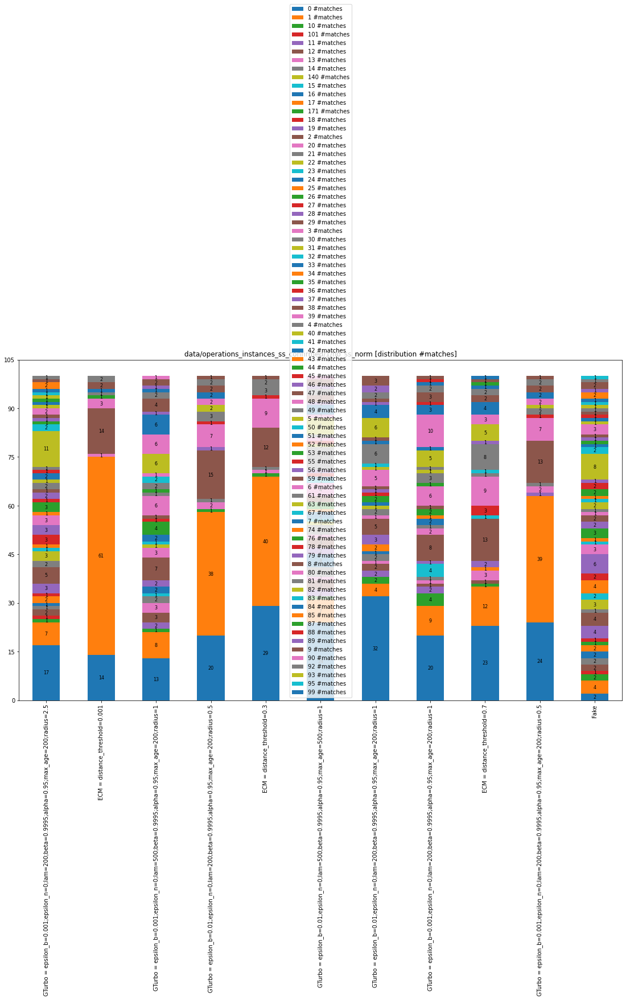

,0 #potential,1 #potential,10 #potential,109 #potential,11 #potential,12 #potential,13 #potential,1344 #potential,14 #potential,16 #potential,1690 #potential,17 #potential,174 #potential,175 #potential,18 #potential,182 #potential,19 #potential,191 #potential,196 #potential,1968 #potential,2 #potential,20 #potential,2000 #potential,214 #potential,22 #potential,23 #potential,231 #potential,24 #potential,241 #potential,242 #potential,25 #potential,26 #potential,27 #potential,270 #potential,28 #potential,287 #potential,29 #potential,3 #potential,30 #potential,31 #potential,33 #potential,35 #potential,359 #potential,36 #potential,361 #potential,38 #potential,39 #potential,4 #potential,40 #potential,44 #potential,45 #potential,48 #potential,49 #potential,5 #potential,51 #potential,53 #potential,56 #potential,57 #potential,59 #potential,6 #potential,60 #potential,61 #potential,62 #potential,67 #potential,7 #potential,70 #potential,72 #potential,73 #potential,74 #potential,8 #potential,80 #potential,81 #potential,82 #potential,83 #potential,85 #potential,9 #potential,91 #potential,92 #potential,98 #potential
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,12,0,0,0,1,0,0,0,0,0,0,0,0,0,4,0,0,0,0,78,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
ECM = distance_threshold=0.001,0,72,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0,2,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,4,0,0,1,0,5,0,1,0,0,3,0,0,1,0,2,0,0,0,4,0,0,11,0,0,23,1,0,0,0,2,0,0,0,0,1,2,0,0,5,0,0,0,0,3,0,0,0,0,5,0,0,0,0,0,0,0,3,4,1,0,0,0,2,0,0,1,0,2,0,2,0,0,0,4,7,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,10,43,0,0,3,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,17,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6,0,0,0,0,0,3,0,0,0,3,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,2,0,2,0,0,1,1,0,0,0
ECM = distance_threshold=0.3,0,62,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,10,0,0,0,0,0,1,0,0,0,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,1,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,21,1,0,0,0,1,0,0,1,0,0,1,0,0,0,6,2,0,0,0,1,2,0,0,0,3,0,3,8,0,0,0,1,0,0,0,0,0,0,1,0,0,32,0,0,0,0,0,5,1,0,0,0,0,0,0,1,0,2,2,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,3,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,12,1,0,0,1,2,1,0,9,0,0,0,0,0,2,0,3,0,7,0,1,0,0,0,0,0,0,2,0,0,0,8,1,0,0,0,1,0,0,0,0,0,0,0,11,0,0,0,0,1,0,0,0,8,0,1,1,0,0,5,0,0,0,0,0,0,0,0,0,0,11,5,0,0,0,0,0,6,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,3,0,0,1,0,0,0,0,1,4,0,1,4,0,1,0,2,0,0,0,1,0,0,0,0,1,0,1,0,0,1,0,0,0,1,12,1,2,2,0,0,0,0,0,0,3,0,0,0,2,0,2,37,0,0,0,0,1,0,0,0,3,0,0,2,0,0,0,0,2,0,2,0,7,0,0,0,0,0
ECM = distance_threshold=0.7,0,0,2,0,0,2,0,0,1,0,0,0,0,0,1,0,0,5,0,0,19,0,0,0,1,0,0,0,0,0,2,1,4,0,3,0,2,6,0,4,3,0,0,0,0,0,0,1,0,0,0,0,0,6,3,0,0,0,0,4,0,0,4,4,8,3,1,0,0,3,0,0,2,0,0,2,0,0,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,12,44,0,0,1,0,3,0,1,0,0,0,0,0,0,0,0,0,0,0,17,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6,0,0,0,0,0,2,0,0,0,2,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,3,0,2,0,0,0,1,0,0,0


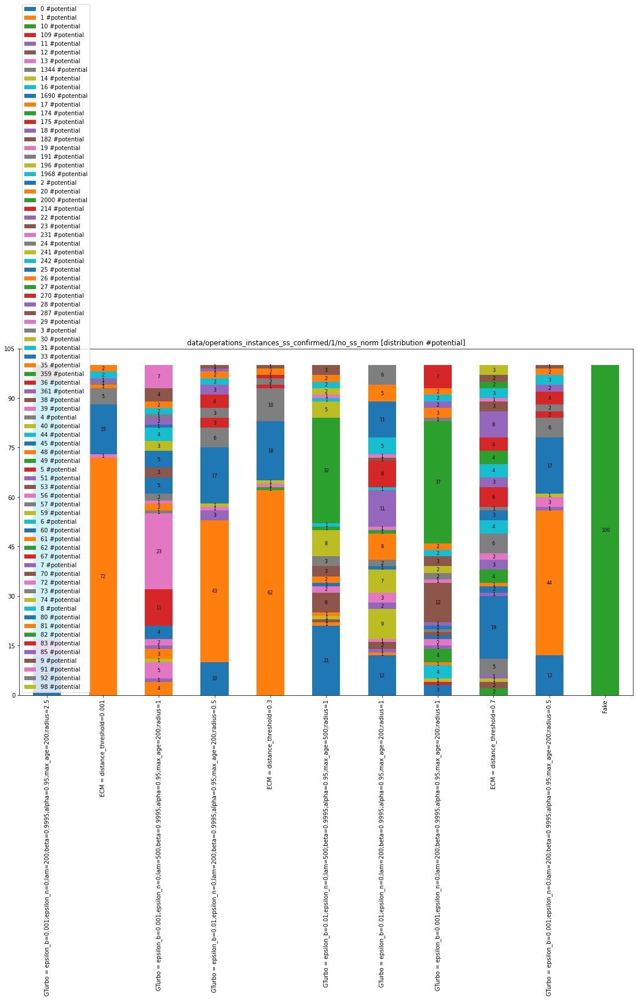

,0 #potential after similarity,1 #potential after similarity,10 #potential after similarity,103 #potential after similarity,104 #potential after similarity,105 #potential after similarity,106 #potential after similarity,107 #potential after similarity,108 #potential after similarity,11 #potential after similarity,111 #potential after similarity,114 #potential after similarity,116 #potential after similarity,117 #potential after similarity,118 #potential after similarity,12 #potential after similarity,120 #potential after similarity,122 #potential after similarity,123 #potential after similarity,126 #potential after similarity,127 #potential after similarity,128 #potential after similarity,129 #potential after similarity,13 #potential after similarity,130 #potential after similarity,131 #potential after similarity,132 #potential after similarity,133 #potential after similarity,134 #potential after similarity,135 #potential after similarity,136 #potential after similarity,137 #potential after similarity,14 #potential after similarity,140 #potential after similarity,141 #potential after similarity,144 #potential after similarity,146 #potential after similarity,147 #potential after similarity,148 #potential after similarity,15 #potential after similarity,150 #potential after similarity,151 #potential after similarity,155 #potential after similarity,156 #potential after similarity,157 #potential after similarity,158 #potential after similarity,16 #potential after similarity,160 #potential after similarity,162 #potential after similarity,165 #potential after similarity,166 #potential after similarity,167 #potential after similarity,168 #potential after similarity,169 #potential after similarity,17 #potential after similarity,173 #potential after similarity,174 #potential after similarity,175 #potential after similarity,177 #potential after similarity,178 #potential after similarity,179 #potential after similarity,18 #potential after similarity,180 #potential after similarity,182 #potential after similarity,183 #potential after similarity,184 #potential after similarity,185 #potential after similarity,186 #potential after similarity,187 #potential after similarity,188 #potential after similarity,19 #potential after similarity,191 #potential after similarity,193 #potential after similarity,194 #potential after similarity,196 #potential after similarity,197 #potential after similarity,198 #potential after similarity,2 #potential after similarity,20 #potential after similarity,200 #potential after similarity,201 #potential after similarity,202 #potential after similarity,203 #potential after similarity,204 #potential after similarity,205 #potential after similarity,206 #potential after similarity,207 #potential after similarity,21 #potential after similarity,210 #potential after similarity,211 #potential after similarity,213 #potential after similarity,214 #potential after similarity,215 #potential after similarity,217 #potential after similarity,218 #potential after similarity,22 #potential after similarity,222 #potential after similarity,223 #potential after similarity,224 #potential after similarity,226 #potential after similarity,227 #potential after similarity,23 #potential after similarity,235 #potential after similarity,24 #potential after similarity,242 #potential after similarity,244 #potential after similarity,245 #potential after similarity,249 #potential after similarity,25 #potential after similarity,250 #potential after similarity,251 #potential after similarity,255 #potential after similarity,256 #potential after similarity,257 #potential after similarity,26 #potential after similarity,260 #potential after similarity,261 #potential after similarity,262 #potential after similarity,267 #potential after similarity,27 #potential after similarity,273 #potential after similarity,277 #potential after similarity,278 #potential after similarity,28 #potential after similarity,282 #potential after similarity,283 #potential after sim

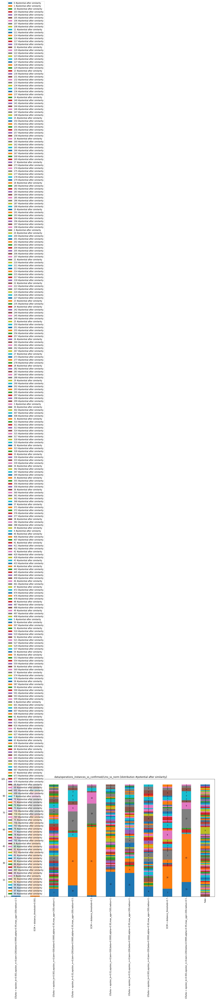

,-5 - 0 score range,0 - 5 score range,10 - 15 score range,100 - 100 score range,15 - 20 score range,20 - 25 score range,25 - 30 score range,30 - 35 score range,35 - 40 score range,40 - 45 score range,45 - 50 score range,5 - 10 score range,50 - 55 score range,55 - 60 score range,60 - 65 score range,65 - 70 score range,70 - 75 score range,75 - 80 score range,80 - 85 score range,85 - 90 score range,90 - 95 score range,95 - 100 score range
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,67,990,13754,5,23716,31504,30857,22334,13677,6899,2939,4730,1101,368,181,84,117,85,107,60,24,3
ECM = distance_threshold=0.001,0,0,0,7,0,0,0,0,2,10,7,0,15,17,14,8,57,51,94,38,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,27,7,100,399,879,1658,1940,1920,1329,0,732,233,109,60,69,60,92,42,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,7,1,1,6,29,27,39,47,0,54,48,31,13,64,55,94,38,31,3
ECM = distance_threshold=0.3,0,0,0,7,0,0,1,2,4,12,19,0,11,21,19,10,59,58,91,37,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,0,92,6,401,1060,2282,3227,3027,2404,1530,12,719,229,106,58,71,63,91,42,27,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,3,65,7,201,540,1134,1423,1362,1179,896,7,551,178,94,54,66,60,94,40,29,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,1,60,6,219,606,1052,1341,1326,1078,857,5,526,173,95,48,95,74,90,36,31,2
ECM = distance_threshold=0.7,0,0,22,7,29,109,194,303,479,559,564,11,369,121,81,41,87,74,102,37,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,7,0,0,0,0,5,25,40,0,36,28,29,13,64,55,95,38,31,3


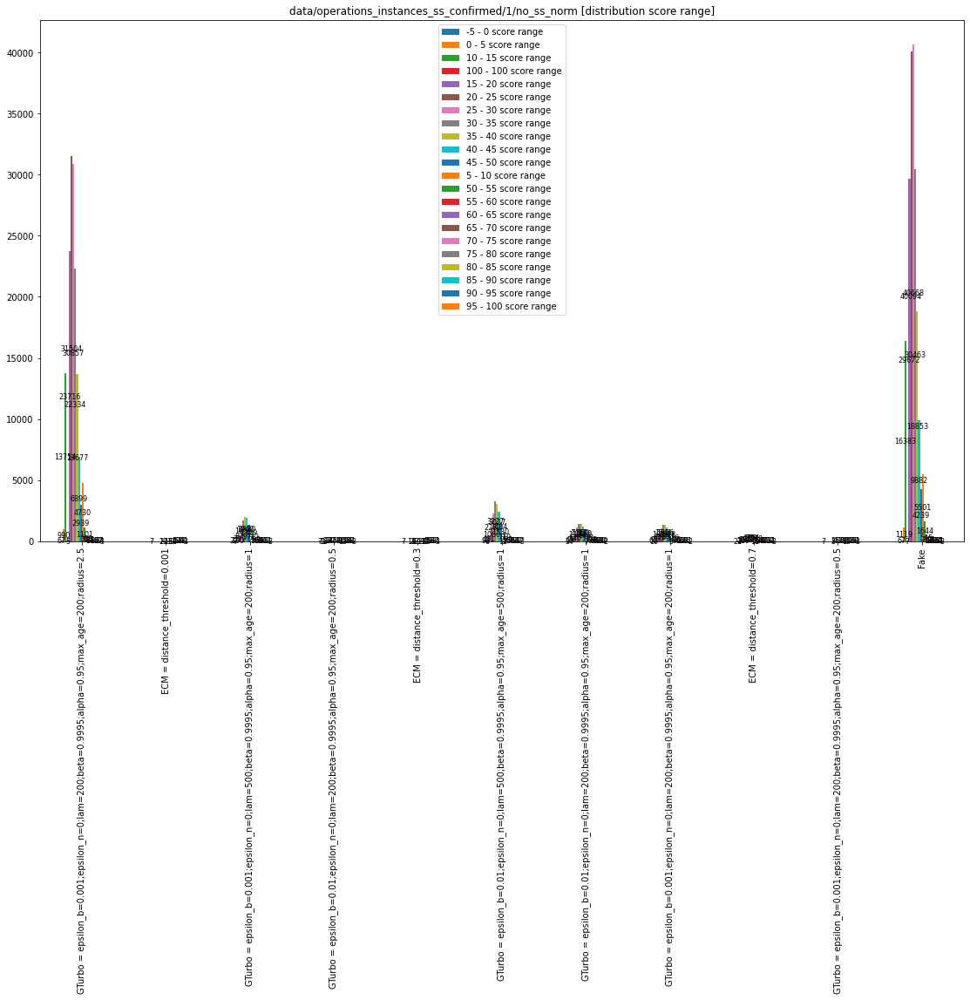

,100 - 100 matches score range,50 - 55 matches score range,55 - 60 matches score range,60 - 65 matches score range,65 - 70 matches score range,70 - 75 matches score range,75 - 80 matches score range,80 - 85 matches score range,85 - 90 matches score range,90 - 95 matches score range,95 - 100 matches score range
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,5,1101,368,181,84,117,85,107,60,24,3
ECM = distance_threshold=0.001,7,15,17,14,8,57,51,94,38,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,7,732,233,109,60,69,60,92,42,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,7,54,48,31,13,64,55,94,38,31,3
ECM = distance_threshold=0.3,7,11,21,19,10,59,58,91,37,31,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,6,719,229,106,58,71,63,91,42,27,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,7,551,178,94,54,66,60,94,40,29,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,6,526,173,95,48,95,74,90,36,31,2
ECM = distance_threshold=0.7,7,369,121,81,41,87,74,102,37,31,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,7,36,28,29,13,64,55,95,38,31,3


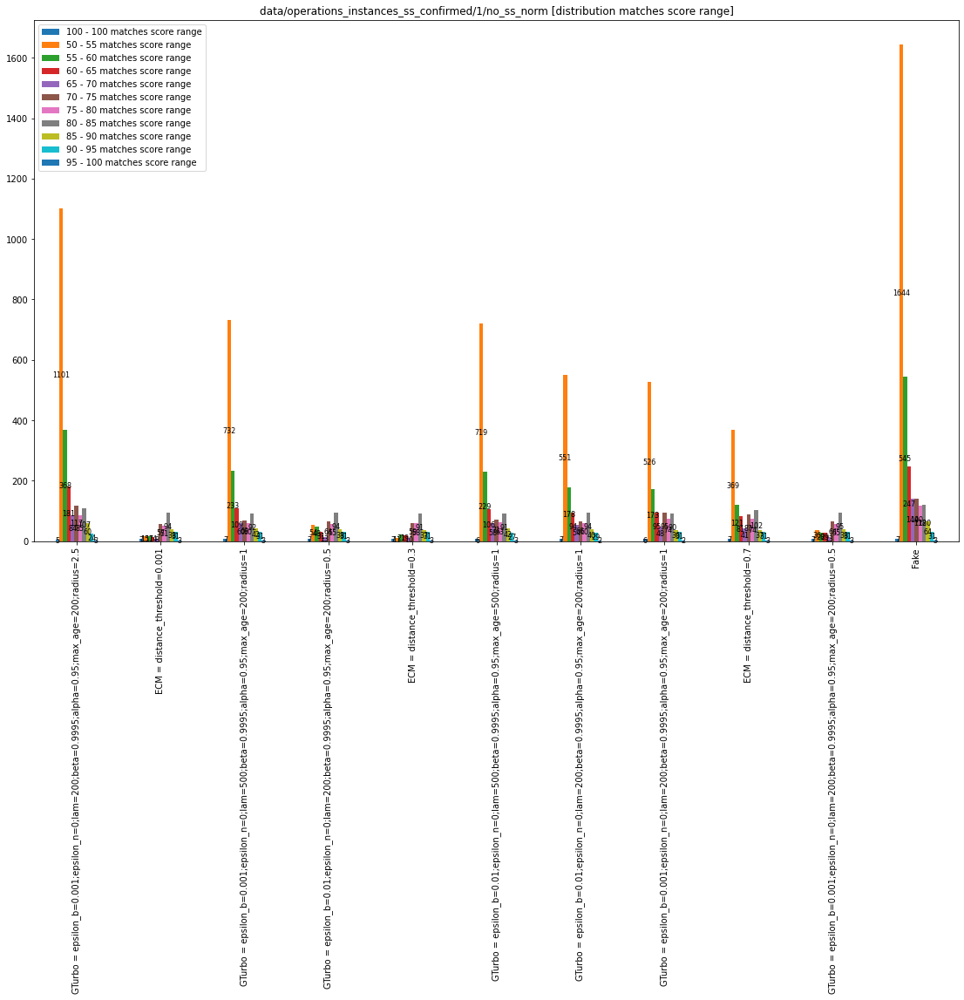

,-10 - -5 similarity score range,-15 - -10 similarity score range,-5 - 0 similarity score range,0 - 5 similarity score range,10 - 15 similarity score range,100 - 100 similarity score range,15 - 20 similarity score range,20 - 25 similarity score range,25 - 30 similarity score range,30 - 35 similarity score range,35 - 40 similarity score range,40 - 45 similarity score range,45 - 50 similarity score range,5 - 10 similarity score range,50 - 55 similarity score range,55 - 60 similarity score range,60 - 65 similarity score range,65 - 70 similarity score range,70 - 75 similarity score range,75 - 80 similarity score range,80 - 85 similarity score range,85 - 90 similarity score range,90 - 95 similarity score range,95 - 100 similarity score range
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,26,4,1004,2986,11300,66,15669,17008,20441,17736,15725,13741,10728,6165,7520,5376,3815,1938,1272,723,315,23,18,3
ECM = distance_threshold=0.001,0,0,0,0,0,77,0,0,0,0,0,0,0,0,0,0,2,5,110,49,98,9,1,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,0,0,1,74,14,68,100,275,333,656,945,0,1328,1433,1530,1001,923,679,291,21,16,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,0,0,77,0,0,0,2,7,22,43,0,8,2,7,16,170,85,126,12,8,3
ECM = distance_threshold=0.3,0,0,0,0,0,77,0,0,0,0,0,1,0,0,2,2,7,19,119,40,97,11,7,3
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,0,0,0,0,24,67,80,226,471,715,1165,1742,1882,8,2064,1794,1812,1322,1087,645,304,24,16,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,0,0,24,69,59,120,232,344,547,905,860,10,903,772,900,666,731,543,262,21,15,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,0,0,27,70,84,173,288,497,600,552,726,1,890,851,838,644,642,521,279,21,15,2
ECM = distance_threshold=0.7,0,0,0,0,30,75,3,9,77,93,66,84,129,1,191,280,439,423,521,500,260,22,17,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,0,0,77,0,0,0,0,0,0,1,0,1,0,6,18,165,74,104,12,8,3


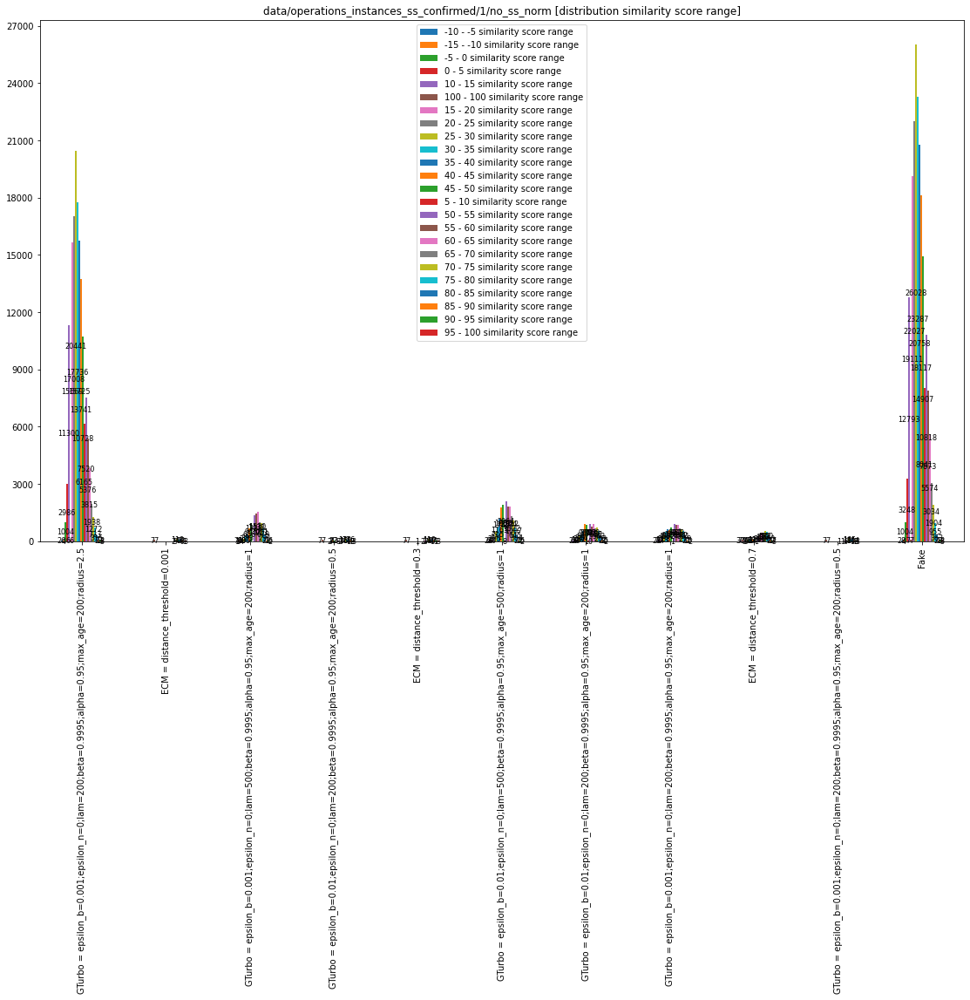

,0 - 5 quality score range,10 - 15 quality score range,100 - 100 quality score range,15 - 20 quality score range,20 - 25 quality score range,25 - 30 quality score range,30 - 35 quality score range,35 - 40 quality score range,40 - 45 quality score range,45 - 50 quality score range,5 - 10 quality score range,50 - 55 quality score range,55 - 60 quality score range,60 - 65 quality score range,65 - 70 quality score range,70 - 75 quality score range,75 - 80 quality score range,80 - 85 quality score range,85 - 90 quality score range,90 - 95 quality score range
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=2.5,12887,59590,47,1768,11330,50751,5242,437,10350,170,434,81,110,65,1,167,0,16,133,23
ECM = distance_threshold=0.001,2,12,16,0,4,10,9,6,14,4,2,2,7,31,1,112,0,12,100,10
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,702,3179,23,324,841,2794,536,153,618,70,64,31,67,46,1,120,0,12,99,10
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,3,26,16,30,26,67,53,26,35,8,0,6,21,33,0,115,0,12,101,10
ECM = distance_threshold=0.3,3,15,15,4,8,16,9,4,18,6,0,3,19,30,0,116,0,11,97,11
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,1320,5798,21,426,1196,4627,640,129,763,75,74,40,51,41,1,123,0,14,98,13
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,628,2755,21,279,658,2180,393,128,443,61,61,38,56,42,1,119,0,12,100,10
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,554,2593,16,224,680,2118,439,122,477,51,43,21,56,47,1,144,0,14,111,10
ECM = distance_threshold=0.7,260,939,26,137,236,760,190,49,189,26,29,16,42,39,0,127,0,18,120,20
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,1,24,16,15,18,28,31,10,20,9,0,5,20,33,0,115,0,12,102,10


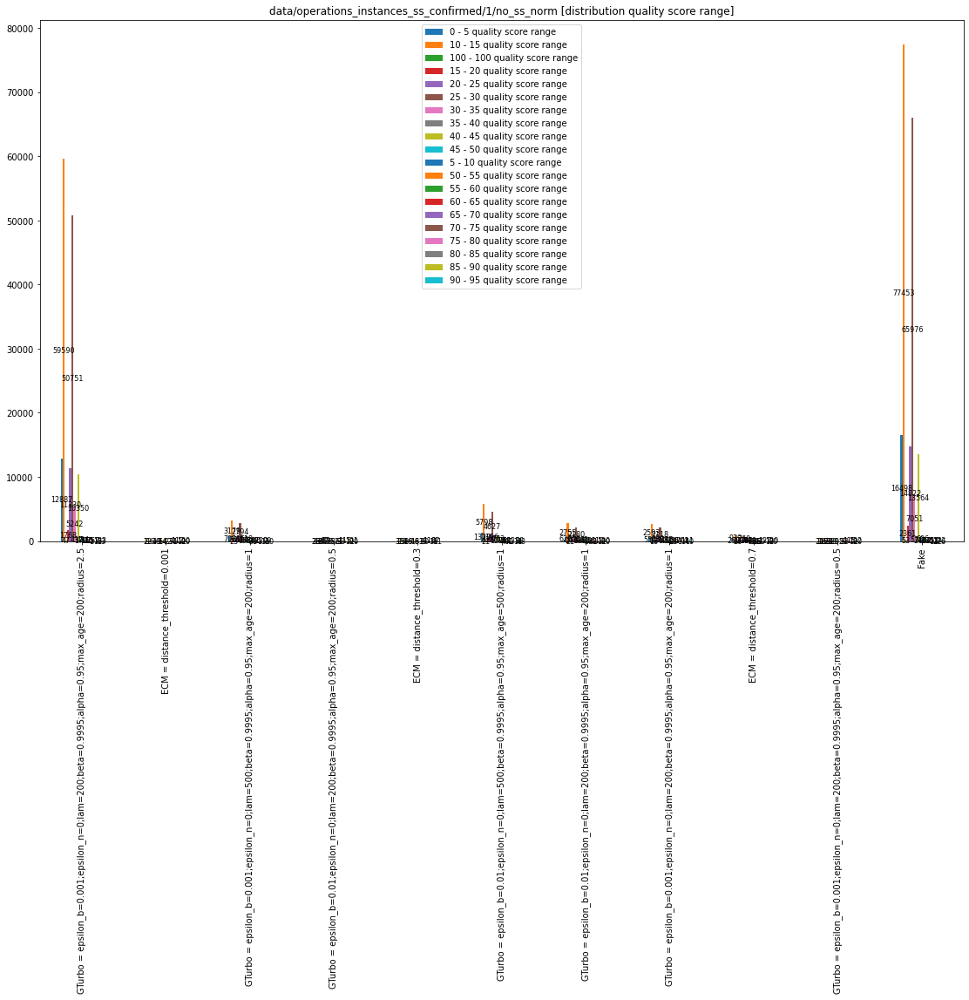

## OperationFile(layer='avg_norm', test_subpath='1/avg_norm', full_path='data/operations_instances_ss_confirmed/1/avg_norm') - matches metrics

,bin deviation score
ECM = distance_threshold=0.1,-29644.240427
ECM = distance_threshold=0.01,-29644.240427
ECM = distance_threshold=0.001,-29297.546358
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-24456.632797
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-29640.722910
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-29622.057754
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-1210.217448
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-28921.175767
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,-18613.587204
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,-1210.217448


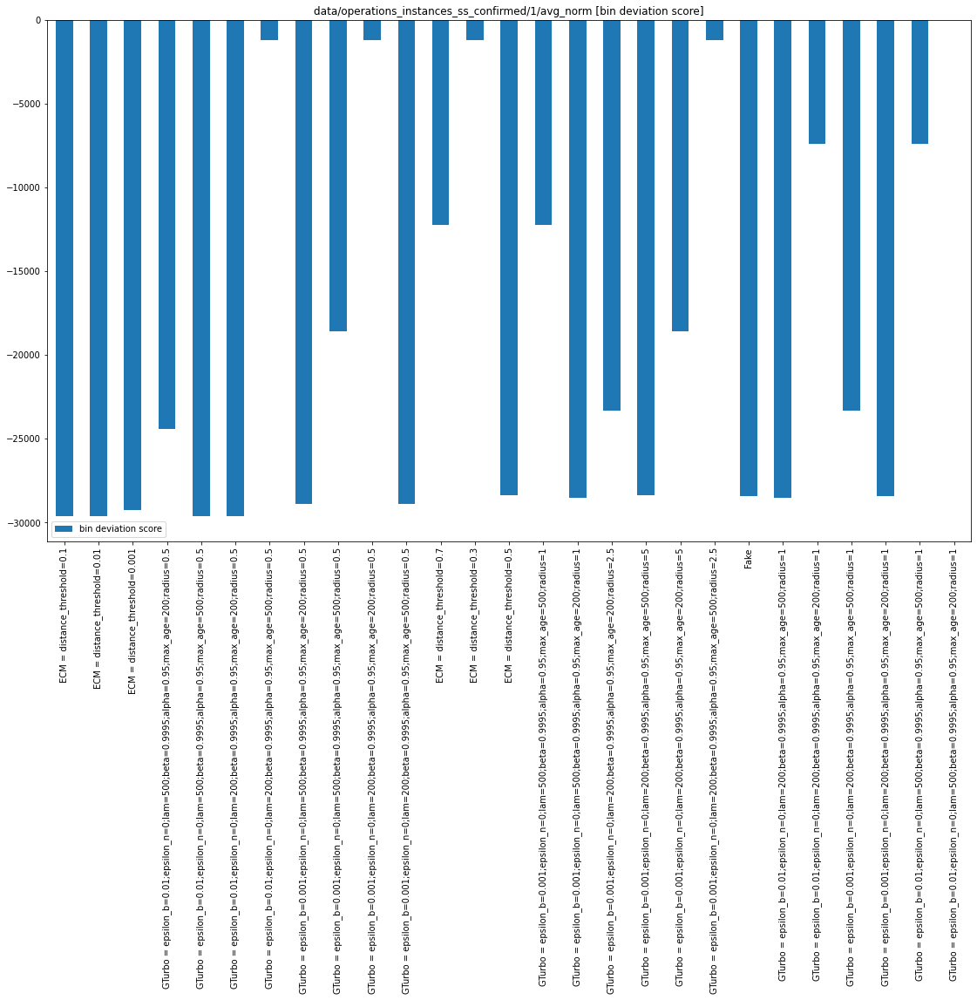

,0 #matches,1 #matches,10 #matches,100 #matches,103 #matches,104 #matches,105 #matches,106 #matches,108 #matches,109 #matches,11 #matches,110 #matches,111 #matches,113 #matches,114 #matches,115 #matches,116 #matches,118 #matches,119 #matches,12 #matches,120 #matches,121 #matches,123 #matches,124 #matches,125 #matches,126 #matches,128 #matches,129 #matches,13 #matches,130 #matches,132 #matches,135 #matches,136 #matches,137 #matches,138 #matches,139 #matches,14 #matches,141 #matches,142 #matches,143 #matches,144 #matches,145 #matches,148 #matches,15 #matches,151 #matches,156 #matches,158 #matches,159 #matches,16 #matches,161 #matches,162 #matches,163 #matches,165 #matches,169 #matches,17 #matches,171 #matches,173 #matches,174 #matches,176 #matches,178 #matches,179 #matches,18 #matches,184 #matches,187 #matches,189 #matches,19 #matches,190 #matches,191 #matches,194 #matches,196 #matches,198 #matches,2 #matches,20 #matches,200 #matches,201 #matches,202 #matches,203 #matches,204 #matches,205 #matches,206 #matches,207 #matches,209 #matches,21 #matches,210 #matches,215 #matches,216 #matches,217 #matches,218 #matches,219 #matches,22 #matches,220 #matches,222 #matches,223 #matches,226 #matches,228 #matches,229 #matches,23 #matches,231 #matches,233 #matches,234 #matches,236 #matches,237 #matches,239 #matches,24 #matches,242 #matches,244 #matches,245 #matches,246 #matches,247 #matches,25 #matches,250 #matches,251 #matches,252 #matches,254 #matches,255 #matches,256 #matches,258 #matches,259 #matches,26 #matches,260 #matches,261 #matches,266 #matches,268 #matches,27 #matches,275 #matches,276 #matches,277 #matches,279 #matches,28 #matches,281 #matches,287 #matches,288 #matches,29 #matches,295 #matches,296 #matches,297 #matches,299 #matches,3 #matches,30 #matches,300 #matches,301 #matches,302 #matches,305 #matches,306 #matches,309 #matches,31 #matches,312 #matches,316 #matches,32 #matches,320 #matches,33 #matches,330 #matches,335 #matches,336 #matches,337 #matches,34 #matches,342 #matches,345 #matches,347 #matches,348 #matches,349 #matches,35 #matches,350 #matches,352 #matches,355 #matches,356 #matches,357 #matches,36 #matches,360 #matches,363 #matches,368 #matches,369 #matches,37 #matches,370 #matches,371 #matches,377 #matches,38 #matches,380 #matches,381 #matches,382 #matches,383 #matches,386 #matches,39 #matches,4 #matches,40 #matches,401 #matches,403 #matches,41 #matches,410 #matches,418 #matches,42 #matches,420 #matches,422 #matches,423 #matches,425 #matches,43 #matches,434 #matches,44 #matches,440 #matches,45 #matches,450 #matches,451 #matches,452 #matches,455 #matches,456 #matches,457 #matches,46 #matches,463 #matches,47 #matches,470 #matches,48 #matches,488 #matches,489 #matches,490 #matches,491 #matches,495 #matches,499 #matches,5 #matches,50 #matches,51 #matches,511 #matches,512 #matches,52 #matches,521 #matches,53 #matches,533 #matches,54 #matches,55 #matches,550 #matches,56 #matches,569 #matches,57 #matches,576 #matches,58 #matches,580 #matches,585 #matches,59 #matches,6 #matches,60 #matches,601 #matches,607 #matches,61 #matches,62 #matches,63 #matches,633 #matches,636 #matches,638 #matches,64 #matches,642 #matches,648 #matches,65 #matches,66 #matches,664 #matches,67 #matches,68 #matches,69 #matches,7 #matches,71 #matches,72 #matches,73 #matches,737 #matches,74 #matches,740 #matches,75 #matches,752 #matches,756 #matches,758 #matches,76 #matches,768 #matches,769 #matches,77 #matches,772 #matches,78 #matches,79 #matches,8 #matches,80 #matches,81 #matches,814 #matches,815 #matches,82 #matches,84 #matches,86 #matches,87 #matches,88 #matches,89 #matches,9 #matches,90 #matches,91 #matches,92 #matches,93 #matches,95 #matches,96 #matches,98 #matches,99 #matches
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,24,0,0,0,0,0,0,0,0,0,2,0,1,1,0,1,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,2,0,0,1,0,0,0,2,0,0,0,1,0,1,1,1,0,1,0,0,1,1,0,1,1,0,0,0,0,0,0,

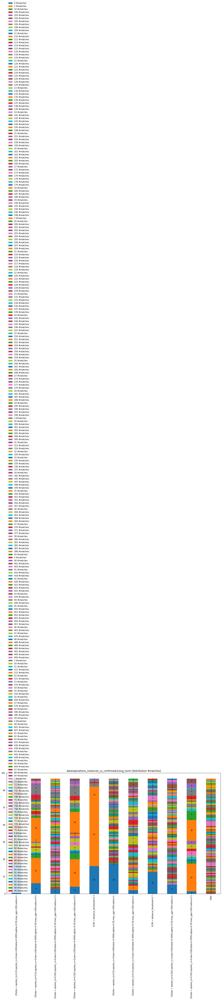

,0 #potential,1 #potential,10 #potential,104 #potential,11 #potential,112 #potential,1144 #potential,118 #potential,12 #potential,123 #potential,1231 #potential,13 #potential,132 #potential,137 #potential,1377 #potential,14 #potential,15 #potential,158 #potential,16 #potential,17 #potential,1710 #potential,178 #potential,18 #potential,185 #potential,19 #potential,190 #potential,1982 #potential,2 #potential,20 #potential,2000 #potential,201 #potential,21 #potential,22 #potential,23 #potential,25 #potential,257 #potential,259 #potential,26 #potential,269 #potential,275 #potential,28 #potential,29 #potential,3 #potential,30 #potential,31 #potential,32 #potential,33 #potential,35 #potential,36 #potential,37 #potential,38 #potential,4 #potential,41 #potential,42 #potential,47 #potential,5 #potential,58 #potential,6 #potential,60 #potential,65 #potential,66 #potential,7 #potential,73 #potential,74 #potential,75 #potential,777 #potential,78 #potential,8 #potential,80 #potential,81 #potential,84 #potential,89 #potential,9 #potential,97 #potential
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,24,0,0,0,0,0,0,15,0,0,38,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,5,24,2,0,0,0,0,0,1,0,0,1,0,0,0,2,0,0,1,2,0,0,0,0,3,0,0,13,4,0,0,0,0,0,2,0,0,0,0,0,0,0,7,1,1,3,0,2,0,0,5,4,1,0,0,1,1,7,0,0,0,2,0,0,0,0,0,1,0,2,0,0,2,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,96,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,4,25,2,0,0,0,0,0,0,0,0,2,0,0,0,4,0,0,0,1,0,0,6,0,9,0,0,12,0,0,0,4,2,0,0,0,0,0,0,0,0,2,4,1,0,0,0,0,0,2,0,10,0,0,0,2,0,5,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0
ECM = distance_threshold=0.3,0,77,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,16,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,24,0,0,0,0,0,0,15,0,0,38,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,0,0,0,0,0,0,0,0,24,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,21,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,6,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,18,0,6,0,0,0,21,0,0
ECM = distance_threshold=0.7,0,16,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,12,5,0,0,0,4,0,0,0,1,0,0,0,16,3,10,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,0,4,0,1,0,1,0,0,1,0,0,3,2,0,0,5,0,2,3
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,8,0,0,0,0,0,85,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,25,3,0,0,0,0,0,0,0,0,0,0,0,0,2,3,0,0,1,0,0,3,0,0,0,0,11,0,0,0,4,3,0,13,0,0,4,0,0,0,0,5,1,0,0,0,0,0,4,0,7,0,0,0,2,0,4,0,0,1,0,1,0,0,0,0,2,0,0,0,0,1,0


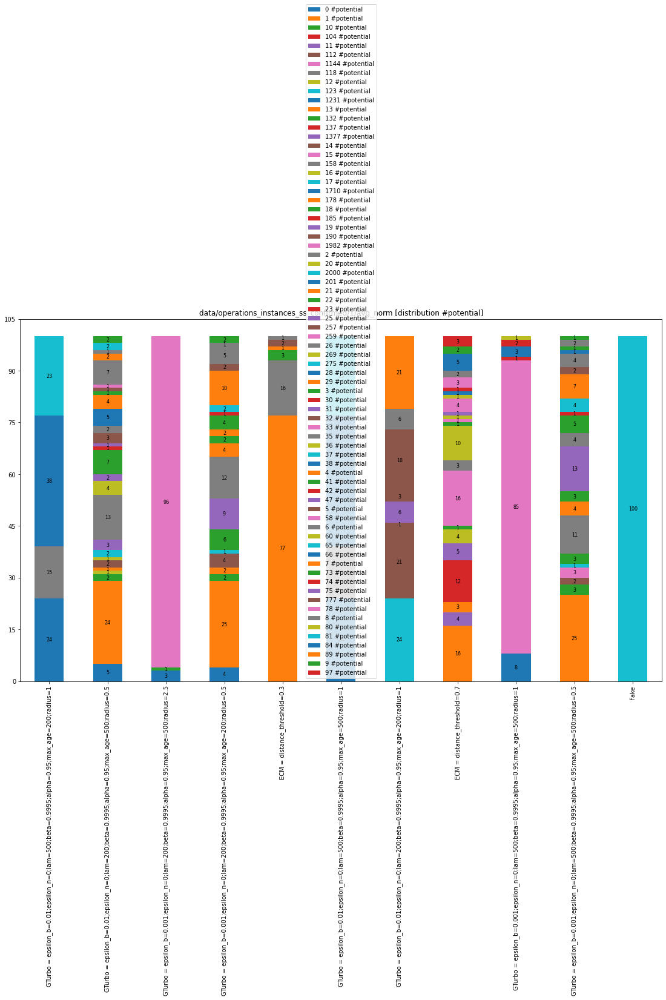

,0 #potential after similarity,1 #potential after similarity,10 #potential after similarity,1003 #potential after similarity,1007 #potential after similarity,1008 #potential after similarity,1010 #potential after similarity,1011 #potential after similarity,1017 #potential after similarity,1018 #potential after similarity,1020 #potential after similarity,1022 #potential after similarity,1024 #potential after similarity,1025 #potential after similarity,1026 #potential after similarity,1029 #potential after similarity,1031 #potential after similarity,1034 #potential after similarity,1035 #potential after similarity,1037 #potential after similarity,1038 #potential after similarity,1043 #potential after similarity,1046 #potential after similarity,1047 #potential after similarity,1048 #potential after similarity,1049 #potential after similarity,1051 #potential after similarity,1053 #potential after similarity,1059 #potential after similarity,1061 #potential after similarity,1062 #potential after similarity,1063 #potential after similarity,1066 #potential after similarity,1067 #potential after similarity,1068 #potential after similarity,1071 #potential after similarity,1072 #potential after similarity,1074 #potential after similarity,1076 #potential after similarity,1078 #potential after similarity,1081 #potential after similarity,1086 #potential after similarity,1087 #potential after similarity,1089 #potential after similarity,109 #potential after similarity,1090 #potential after similarity,1092 #potential after similarity,1093 #potential after similarity,1094 #potential after similarity,1096 #potential after similarity,1099 #potential after similarity,11 #potential after similarity,1100 #potential after similarity,1101 #potential after similarity,1103 #potential after similarity,1104 #potential after similarity,1105 #potential after similarity,1106 #potential after similarity,1107 #potential after similarity,1108 #potential after similarity,1109 #potential after similarity,1111 #potential after similarity,1112 #potential after similarity,1114 #potential after similarity,1115 #potential after similarity,1119 #potential after similarity,112 #potential after similarity,1126 #potential after similarity,1129 #potential after similarity,113 #potential after similarity,1131 #potential after similarity,1134 #potential after similarity,1136 #potential after similarity,1138 #potential after similarity,1139 #potential after similarity,1144 #potential after similarity,1148 #potential after similarity,1149 #potential after similarity,115 #potential after similarity,1152 #potential after similarity,1159 #potential after similarity,116 #potential after similarity,1160 #potential after similarity,1164 #potential after similarity,1166 #potential after similarity,117 #potential after similarity,1172 #potential after similarity,1174 #potential after similarity,1175 #potential after similarity,1176 #potential after similarity,1178 #potential after similarity,118 #potential after similarity,1183 #potential after similarity,1190 #potential after similarity,1191 #potential after similarity,1192 #potential after similarity,1195 #potential after similarity,1196 #potential after similarity,12 #potential after similarity,120 #potential after similarity,1200 #potential after similarity,1203 #potential after similarity,1206 #potential after similarity,121 #potential after similarity,1215 #potential after similarity,1217 #potential after similarity,122 #potential after similarity,1220 #potential after similarity,1226 #potential after similarity,123 #potential after similarity,1230 #potential after similarity,1231 #potential after similarity,1234 #potential after similarity,1236 #potential after similarity,1237 #potential after similarity,124 #potential after similarity,1242 #potential after similarity,1247 #potential after similarity,125 #potential after similarity,1253 #potential after similarity,1254 #potential after similarity,1258 #potential after similarit

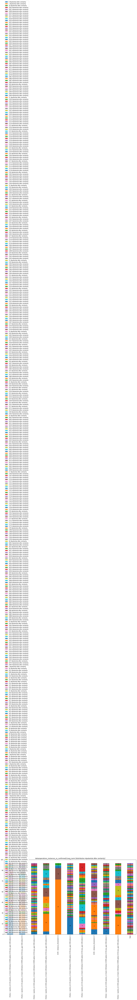

,10 - 15 score range,15 - 20 score range,20 - 25 score range,25 - 30 score range,30 - 35 score range,35 - 40 score range,40 - 45 score range,45 - 50 score range,5 - 10 score range,50 - 55 score range,55 - 60 score range,60 - 65 score range,65 - 70 score range,70 - 75 score range,75 - 80 score range,80 - 85 score range,85 - 90 score range,90 - 95 score range,95 - 100 score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,77,348,1415,3872,7312,11244,12225,8859,1,6277,2074,834,133,55,28,59,23,33,4
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,1,9,82,146,0,255,212,114,52,54,57,87,28,58,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,143,1354,5099,15480,29179,41786,42972,29860,2,16481,5455,1534,359,190,115,145,56,65,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,0,2,9,77,119,0,235,170,95,40,17,8,22,12,44,5
ECM = distance_threshold=0.3,0,0,0,0,0,0,6,20,0,27,15,10,8,11,4,14,3,15,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,77,348,1415,3872,7312,11244,12225,8859,1,6277,2074,834,133,55,28,59,23,33,4
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,14,64,290,977,2298,4337,5331,4570,0,3353,1282,504,109,42,24,53,11,41,3
ECM = distance_threshold=0.7,0,4,31,150,555,1398,2428,2569,0,2399,1027,404,138,75,81,98,35,54,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,56,420,2174,6496,13447,20480,22780,17334,2,9929,3475,1010,217,96,79,67,37,43,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,1,17,131,175,0,313,226,121,46,36,18,64,17,49,5


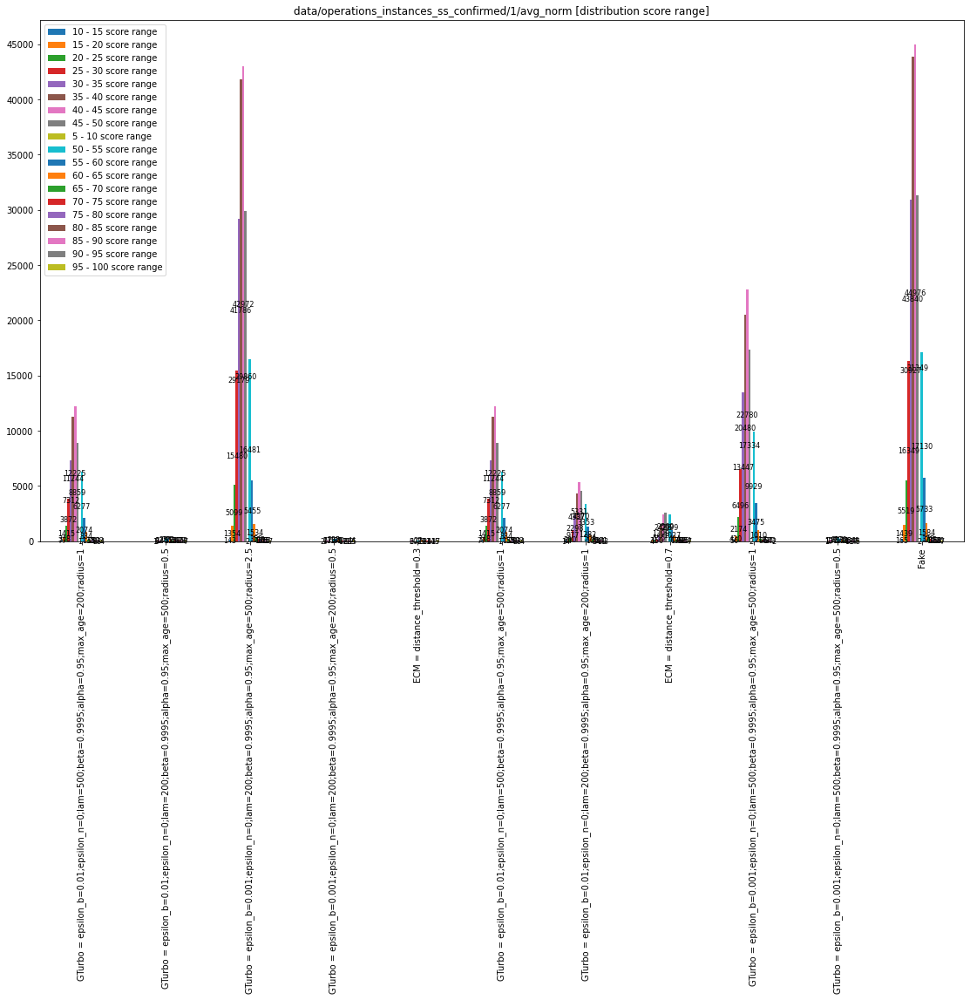

,50 - 55 matches score range,55 - 60 matches score range,60 - 65 matches score range,65 - 70 matches score range,70 - 75 matches score range,75 - 80 matches score range,80 - 85 matches score range,85 - 90 matches score range,90 - 95 matches score range,95 - 100 matches score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,6277,2074,834,133,55,28,59,23,33,4
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,255,212,114,52,54,57,87,28,58,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,16481,5455,1534,359,190,115,145,56,65,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,235,170,95,40,17,8,22,12,44,5
ECM = distance_threshold=0.3,27,15,10,8,11,4,14,3,15,7
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,6277,2074,834,133,55,28,59,23,33,4
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,3353,1282,504,109,42,24,53,11,41,3
ECM = distance_threshold=0.7,2399,1027,404,138,75,81,98,35,54,7
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,9929,3475,1010,217,96,79,67,37,43,2
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,313,226,121,46,36,18,64,17,49,5


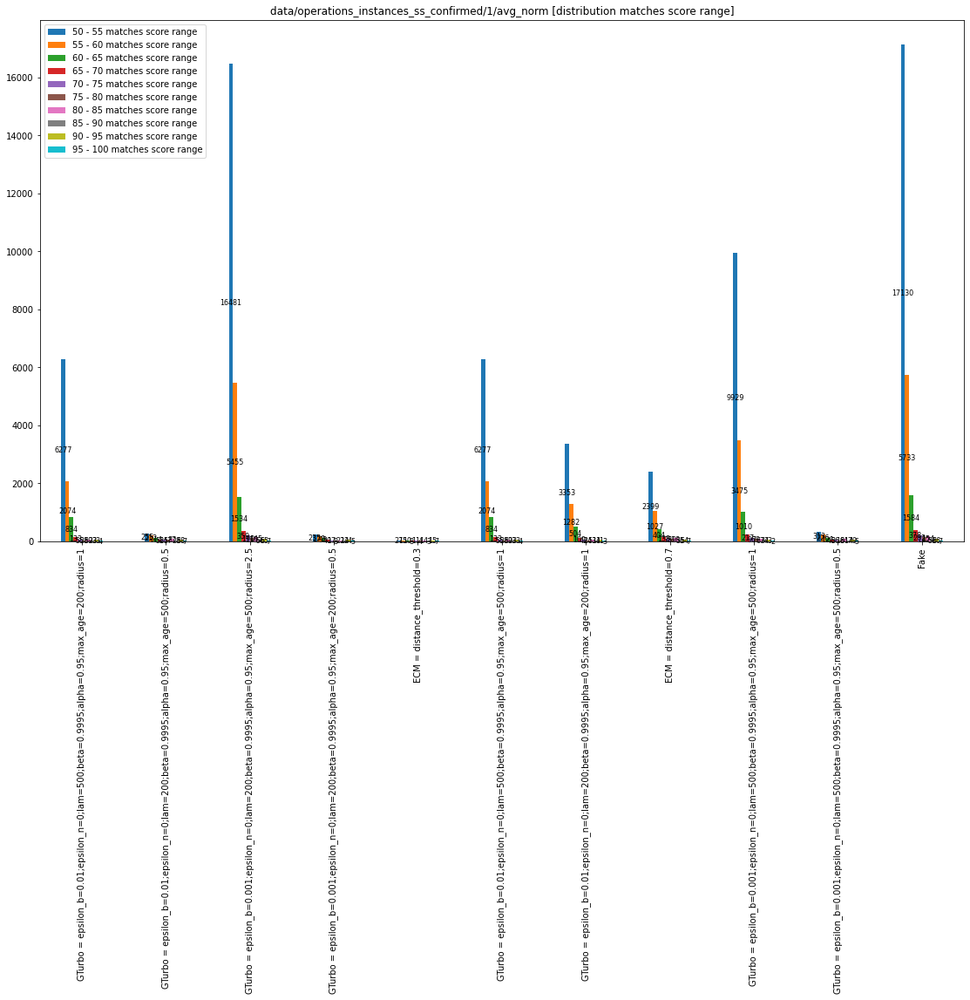

,15 - 20 similarity score range,20 - 25 similarity score range,25 - 30 similarity score range,30 - 35 similarity score range,35 - 40 similarity score range,40 - 45 similarity score range,45 - 50 similarity score range,50 - 55 similarity score range,55 - 60 similarity score range,60 - 65 similarity score range,65 - 70 similarity score range,70 - 75 similarity score range,75 - 80 similarity score range,80 - 85 similarity score range,85 - 90 similarity score range,90 - 95 similarity score range,95 - 100 similarity score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,1,40,130,370,1002,2363,3761,5799,7634,8930,8392,7311,5686,2828,551,52,23
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,0,0,0,0,1,3,26,122,335,386,210,48,31
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,2,51,223,1055,4064,9804,17227,25315,30609,32117,28719,22312,12975,4822,884,69,34
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,0,0,0,0,0,0,0,0,8,10,17,112,209,282,170,28,19
ECM = distance_threshold=0.3,0,0,0,0,0,0,0,0,0,3,6,18,32,23,18,22,18
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,1,40,130,370,1002,2363,3761,5799,7634,8930,8392,7311,5686,2828,551,52,23
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,0,3,31,90,221,548,875,1640,2756,3972,4193,3894,2966,1626,423,47,18
ECM = distance_threshold=0.7,0,0,0,4,5,40,121,317,764,1388,1982,2446,2468,1507,333,50,28
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,2,4,78,312,1329,3329,6511,11139,14676,17397,17239,14111,8261,3093,590,52,21
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,0,0,0,0,0,0,0,0,8,17,34,159,359,385,209,29,19


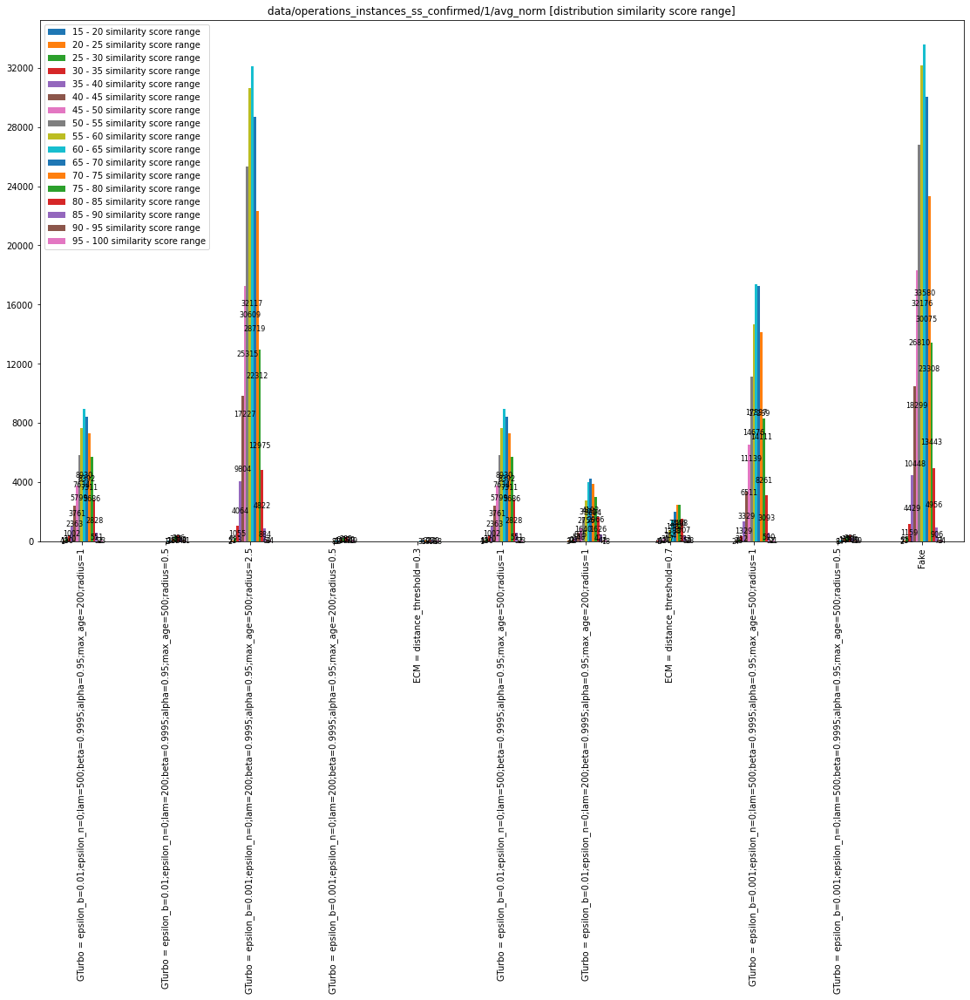

,0 - 5 quality score range,10 - 15 quality score range,100 - 100 quality score range,15 - 20 quality score range,20 - 25 quality score range,25 - 30 quality score range,30 - 35 quality score range,35 - 40 quality score range,40 - 45 quality score range,45 - 50 quality score range,5 - 10 quality score range,50 - 55 quality score range,55 - 60 quality score range,60 - 65 quality score range,65 - 70 quality score range,70 - 75 quality score range,75 - 80 quality score range,80 - 85 quality score range,85 - 90 quality score range,90 - 95 quality score range
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1,4662,21339,22,762,4070,17865,1933,223,3483,90,172,41,54,20,1,59,1,6,58,12
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,3,135,39,47,74,285,116,49,116,21,1,10,13,34,0,107,0,11,90,11
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5,15831,73624,52,2238,13958,62855,6638,564,12944,239,587,110,154,73,1,197,1,24,166,26
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5,2,112,32,32,87,243,91,32,113,20,0,11,14,7,1,23,0,3,28,4
ECM = distance_threshold=0.3,1,9,8,0,1,43,4,2,18,2,0,3,8,7,0,14,0,2,16,2
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,4662,21339,22,762,4070,17865,1933,223,3483,90,172,41,54,20,1,59,1,6,58,12
GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1,1431,8437,27,356,1715,7972,1071,159,1814,69,52,31,45,11,1,50,0,8,52,2
ECM = distance_threshold=0.7,402,3533,40,183,880,4120,666,91,1081,68,19,19,52,33,0,121,0,14,116,15
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1,8383,37502,32,1491,7301,31842,3601,379,6624,160,406,70,81,47,1,114,0,14,86,10
GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5,5,175,37,47,127,325,133,37,140,24,1,12,14,7,1,51,0,4,70,9


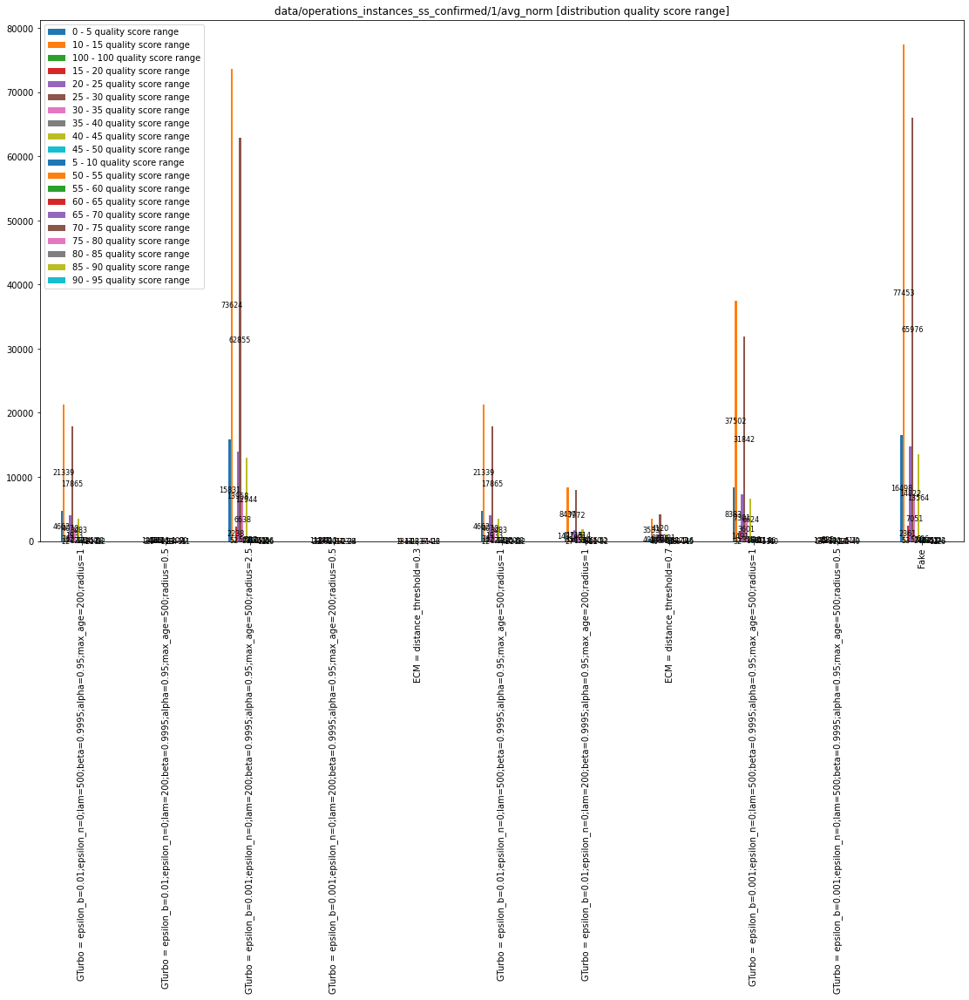

In [54]:

from interference.evaluation.match import bin_deviation_score

operations_file_to_good_by_cluster_metrics_and_bin: Dict[str, Dict[str, None]] = {}

for operations_file in operations_files:

    display(Markdown(f'## {operations_file} - matches metrics'))

    operations_file_to_good_by_cluster_metrics_and_bin[operations_file.full_path] = {}

    good_by_cluster_metrics = operations_file_to_good_by_cluster_metrics[operations_file.full_path]

    name_to_matches_metrics = operations_file_to_name_to_matches_metrics[operations_file.full_path]

    distribution_fake_matches_score_range = name_to_matches_metrics["Fake"]["distribution matches score range"]

    if len(distribution_fake_matches_score_range) != 0:
        bin_deviation_scores = []
        bin_deviation_scores_df = pd.DataFrame(index=list(good_by_cluster_metrics))
        
        for clusterer in name_to_matches_metrics:
            other_distribution_matches_score_range = name_to_matches_metrics[clusterer]["distribution matches score range"]
            bin_dev_score = bin_deviation_score(other_distribution_matches_score_range, distribution_fake_matches_score_range)

            if clusterer in good_by_cluster_metrics:
                bin_deviation_scores.append(bin_dev_score)
            
            operations_file_to_name_to_matches_metrics[operations_file.full_path][clusterer]["bin deviation score"] = bin_dev_score

        bin_deviation_scores_df["bin deviation score"] = bin_deviation_scores

        n = 10
        bin_deviation_scores_series = bin_deviation_scores_df["bin deviation score"].sort_values(ascending=False).head(n)

        if "Fake" not in bin_deviation_scores_series.index:
            bin_deviation_scores_series = bin_deviation_scores_series.append(pd.Series([bin_deviation_scores_df["bin deviation score"]["Fake"]], index=["Fake"]))

        display(bin_deviation_scores_df)

        plot = bin_deviation_scores_df.plot(kind='bar', figsize=(19,11))
        plot.set_title(f"{operations_file.full_path} [bin deviation score]")
        plt.show()

        for name in bin_deviation_scores_series.index:
            operations_file_to_good_by_cluster_metrics_and_bin[operations_file.full_path][name] = None

    else:
        operations_file_to_good_by_cluster_metrics_and_bin[operations_file.full_path] = good_by_cluster_metrics

    good_by_cluster_and_bin = operations_file_to_good_by_cluster_metrics_and_bin[operations_file.full_path]

    matches_metric_df = pd.DataFrame(index=list(good_by_cluster_and_bin.keys()))

    for matches_metric in matches_metrics:
        if matches_metric.find("distribution") != -1:
            fake_metric_distribution = name_to_matches_metrics["Fake"][matches_metric]

            for _range in fake_metric_distribution:
                matches_metric_df[matches_metric.replace("distribution", _range)] = [
                    name_to_matches_metrics[name][matches_metric][_range]
                    for name in good_by_cluster_and_bin
                ]
        else:
            matches_metric_df[matches_metric] = [
                name_to_matches_metrics[name][matches_metric]
                for name in good_by_cluster_and_bin
            ]

    for matches_metric in matches_metrics:
        if matches_metric.find("distribution") != -1:
            fake_metric_distribution: Dict[str, int] = name_to_matches_metrics["Fake"][matches_metric]

            if len(fake_metric_distribution) == 0:
                continue

            names = [matches_metric.replace("distribution", _range) for _range in fake_metric_distribution]

            z = matches_metric_df[names]

            v = [
                matches_metric_df[name]["Fake"]
                for name in names
            ]

            df = pd.DataFrame([v], columns = names, index=["Fake"])

            if "Fake" not in z.index:
                z = z.append(df)

            should_stack = matches_metric.find("#") != -1

            display(z)

            plot = z.plot(kind='bar', figsize=(19,11), stacked=should_stack)
            plot.set_title(f"{operations_file.full_path} [{matches_metric}]")

            plot.yaxis.set_major_locator(MaxNLocator(integer=True))
            for rect in plot.patches:
                # Find where everything is located
                height = rect.get_height()
                width = rect.get_width()
                x = rect.get_x()
                y = rect.get_y()
                
                # The height of the bar is the data value and can be used as the label
                label_text = f'{int(height)}'  # f'{height:.2f}' to format decimal values
                
                # ax.text(x, y, text)
                label_x = x + width / 2
                label_y = y + height / 2

                # plot only when height is greater than specified value
                if height > 0:
                    plot.text(label_x, label_y, label_text, ha='center', va='center', fontsize=8)

            plt.show()
        else:

            z = matches_metric_df[matches_metric]
            z = z.sort_values(ascending=False).head(n)

            if "Fake" not in z.index:
                z = z.append(pd.Series([matches_metric_df[matches_metric]["Fake"]], index=["Fake"]))

            plot = z.plot(kind='bar', figsize=(19,11))
            plot.set_title(f"{operations_file.full_path} [{matches_metric}]")
            plt.show()


## Overall

ss  \
file                                                 clusterer                                                                                              
data/operations_instances_ss_confirmed/1/concat_norm ECM = distance_threshold=0.5                                                                0.050729   
                                                     ECM = distance_threshold=0.7                                                                0.067361   
                                                     GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1    0.095696   
                                                     GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=1    0.112945   
                                                     GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=0.5  0.164793   
                                                     ECM = distance_threshold=0.3                                                                0.077401   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=500;radius=1     0.117977   
                                                     GTurbo = epsilon_b=0.001;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=0.5  0.157645   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1     0.118728   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=0.5   0.169220   
                                                     Fake                                                                                       -1.000000   
data/operations_instances_ss_confirmed/1/no_ss       ECM = distance_threshold=1                                                                  0.575049   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=2.5   0.576515   
                                                     Fake                                                                                       -1.000000   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=5     0.575220   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5   0.578087   
                                                     GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=2.5  0.578619   
                                                     GTurbo = epsilon_b=0.001;epsilon_n=0;lam=500;beta=0.9995;alpha=0.95;max_age=200;radius=1    0.578703   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=5     0.575220   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=200;radius=0.5   0.578500   
                                                     GTurbo = epsilon_b=0.01;epsilon_n=0;lam=200;beta=0.9995;alpha=0.95;max_age=500;radius=1     0.578703   
data/operations_instances_ss_confirmed/1/concat      Fake                                                                                       -1.000000   
                                                     ECM = distance_threshold=0.7                                                                0.248635   
                                                     ECM = distance_threshold=1                                                                  0.250999   
                                                     GTurbo = epsilon

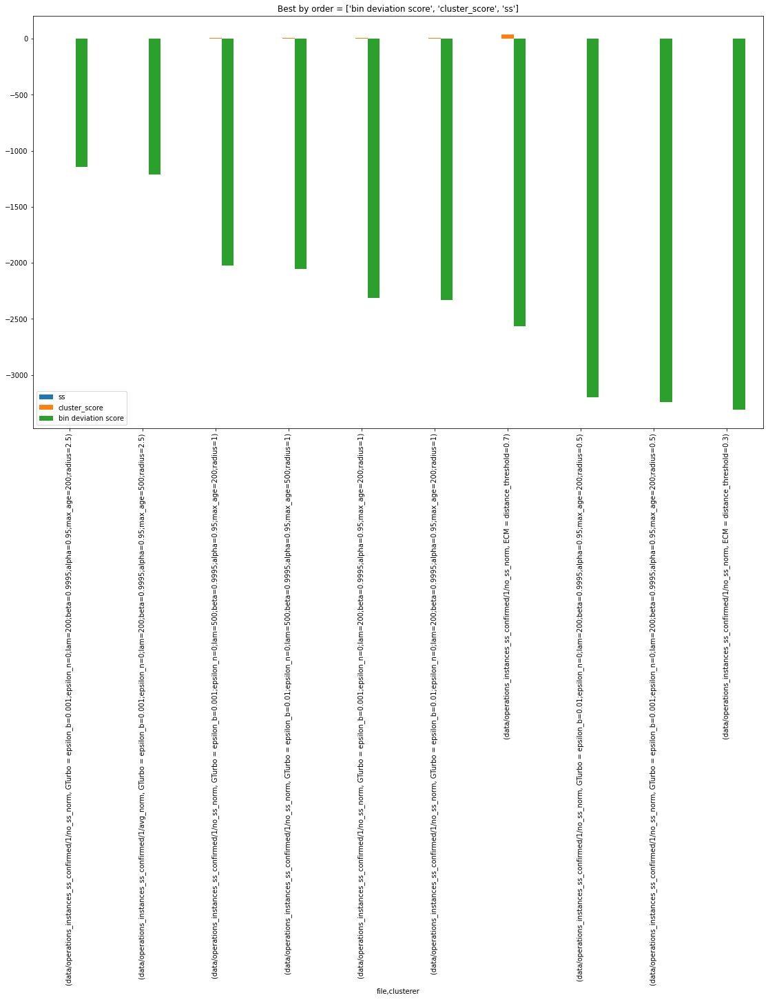

In [55]:
ss_scores = []
cluster_scores = []
bdss = []
files = []
clusterers = []

for operations_file in operations_file_to_good_by_cluster_metrics_and_bin:
    for clusterer in operations_file_to_good_by_cluster_metrics_and_bin[operations_file]:
        files.append(operations_file)
        clusterers.append(clusterer)
        ss_scores.append(operations_file_to_name_to_cluster_metrics[operations_file][clusterer]["ss"])
        cluster_scores.append(operations_file_to_name_to_cluster_metrics[operations_file][clusterer]["cluster_score"])
        bdss.append(operations_file_to_name_to_matches_metrics[operations_file][clusterer].get("bin deviation score", 0))

mui = pd.MultiIndex.from_arrays([files, clusterers], names=["file", "clusterer"])

best_of_the_best_df = pd.DataFrame(
    data = { "ss": ss_scores, "cluster_score" : cluster_scores, "bin deviation score" : bdss },
    index = mui,
)

display(best_of_the_best_df)

for operations_file in operations_file_to_good_by_cluster_metrics_and_bin:
    for clusterer in operations_file_to_good_by_cluster_metrics_and_bin[operations_file]:
        if clusterer == "Fake":
            best_of_the_best_df = best_of_the_best_df.drop((operations_file, clusterer))

order = ["bin deviation score", "cluster_score", "ss"]

ordered = best_of_the_best_df.sort_values(by=order, ascending=False)

plot = ordered.head(10).plot(kind='bar', figsize=(19,11))
plot.set_title(f"Best by order = {order}")
plt.show()